In [2]:
import math
import numpy as np
import pandas as pd
from datetime import datetime
import logging
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import mean_squared_error
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.holtwinters import ExponentialSmoothing
import logging, sys
logging.disable(sys.maxsize)

In [3]:
logging.getLogger('fbprophet').setLevel(logging.WARNING)
pd.set_option("max_rows", None)
sns.set_style("darkgrid")
sns.set_style("ticks", {"xtick.major.size": 16, "ytick.major.size": 16})

## Region Deaths

In [3]:
data_state = pd.read_csv('./DATA/us-states.csv')
data_state = data_state[['date', 'state', 'deaths']]
data_state['date'] = pd.to_datetime(data_state['date'])
data_state = data_state[(data_state['date'] >= '2020-03-08') & (data_state['date'] < '2021-01-01')]

NorthEast = ['Maine', 'New Hampshire', 'Vermont', 'Massachusetts', 'Rhode Island', 'Connecticut', 'New York', 
             'New Jersey', 'Pennsylvania']
MidWest = ['Ohio', 'Michigan', 'Indiana', 'Wisconsin', 'Illinois', 'Minnesota', 'Iowa', 'Missouri', 'North Dakota', 
           'South Dakota', 'Nebraska', 'Kansas']
South = ['Delaware', 'Maryland', 'Virginia', 'West Virginia', 'Kentucky', 'North Carolina', 'South Carolina', 
         'Tennessee', 'Georgia', 'Florida', 'Alabama', 'Mississippi', 'Arkansas', 'Louisiana', 'Texas', 'Oklahoma']
West = ['Montana', 'Idaho', 'Wyoming', 'Colorado', 'New Mexico', 'Arizona', 'Utah', 'Nevada', 'California', 
        'Oregon', 'Washington', 'Alaska', 'Hawaii']

for index, row in data_state.iterrows():
    if data_state.loc[index, 'state'] in NorthEast:
        data_state.loc[index, 'region'] = 'NorthEast'
    if data_state.loc[index, 'state'] in MidWest:
        data_state.loc[index, 'region'] = 'MidWest'
    if data_state.loc[index, 'state'] in South:
        data_state.loc[index, 'region'] = 'South'
    if data_state.loc[index, 'state'] in West:
        data_state.loc[index, 'region'] = 'West'
        
data_state = data_state.dropna()
data_region = data_state.groupby(['date', 'region'], as_index=False).sum()

Text(0.5, 1.0, 'Death Cases Trend by Region')

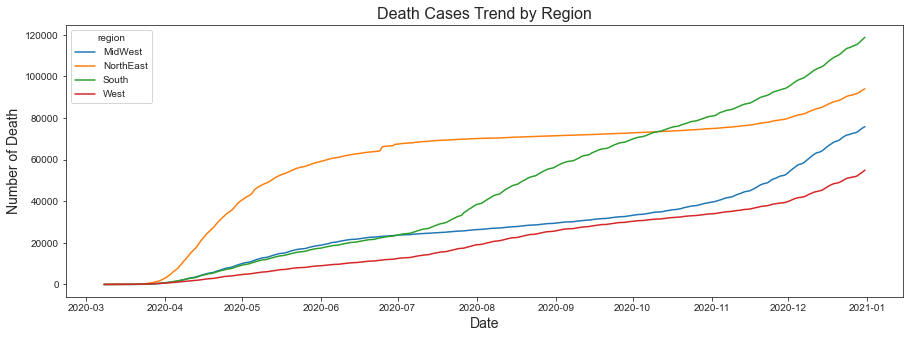

In [4]:
plt.figure(figsize=(15, 5))
sns.lineplot(data=data_region, x="date", y="deaths", hue="region")
plt.xlabel('Date', fontsize=14)
plt.ylabel('Number of Death', fontsize=14)
plt.title('Death Cases Trend by Region', fontsize=16)

In [5]:
# Performance Matrix
region_perform = pd.DataFrame(columns=['region', 'ARIMA', 'HWAAS', 'Prohphet'])
region_perform['region'] = ['NorthEast', 'MidWest', 'South', 'West']

In [6]:
# Predicted Values
data_region_test = data_region[data_region['date'] >= '2020-06-08'].copy()
region_Nov = data_region_test.reindex(columns=['date', 'region', 'deaths', 'ARIMA', 'HWAAS', 'Prohphet'])  
region_Nov['date'] = region_Nov['date'].dt.date.astype(str)

### ARIMA

In [7]:
# forecasting
region_list = ['MidWest', 'NorthEast', 'South', 'West']
date_list = data_region_test['date'].dt.date.astype(str).unique().tolist()

for i in date_list:
    data_region_train = data_region[data_region['date'] < i]
    for j in region_list:
        train = data_region_train[data_region_train['region'] == j].reset_index()['deaths'].astype(float)
        model = ARIMA(train, order=(1,0,0))
        model_fit = model.fit()
        y_hat = model_fit.forecast().iloc[0]
        region_Nov.loc[(region_Nov['date'] == i) & (region_Nov['region'] == j), 'ARIMA'] = y_hat

/Users/chester/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


In [8]:
# evaluate forecasts
for j in region_list:
    result = region_Nov[region_Nov['region'] == j]
    rmse = math.sqrt(mean_squared_error(result['deaths'], result['ARIMA'])) 
    region_perform.loc[region_perform['region'] == j, 'ARIMA'] = rmse
    print(j + ' Test RMSE: %.4f' % rmse)

MidWest Test RMSE: 381.0805
NorthEast Test RMSE: 264.1223
South Test RMSE: 548.7780
West Test RMSE: 276.3615


### HWAAS

In [9]:
# forecasting
for i in date_list:
    data_region_train = data_region[data_region['date'] < i]
    for j in region_list:
        train = data_region_train[data_region_train['region'] == j].reset_index()['deaths'].astype(float)
        model = ExponentialSmoothing(endog=train, trend='add', initialization_method='estimated')
        model_fit = model.fit()
        y_hat = model_fit.forecast().iloc[0]
        region_Nov.loc[(region_Nov['date'] == i) & (region_Nov['region'] == j), 'HWAAS'] = y_hat

In [10]:
# evaluate forecasts
for j in region_list:
    result = region_Nov[region_Nov['region'] == j]
    rmse = math.sqrt(mean_squared_error(result['deaths'], result['HWAAS'])) 
    region_perform.loc[region_perform['region'] == j, 'HWAAS'] = rmse
    print(j + ' Test RMSE: %.4f' % rmse)

MidWest Test RMSE: 150.3763
NorthEast Test RMSE: 198.1883
South Test RMSE: 204.8794
West Test RMSE: 120.3933


### Prohphet

In [4]:
from fbprophet import Prophet

In [13]:
# forecasting
for i in date_list:
    data_region_train = data_region[data_region['date'] < i]
    for j in region_list:
        train = data_region_train[data_region_train['region'] == j].reset_index()[['date', 'deaths']]
        train = train.rename(columns={'deaths': 'y', 'date': 'ds'})
        model = Prophet(yearly_seasonality=True, daily_seasonality=True)
        model_fit = model.fit(train)
        future_dates=model.make_future_dataframe(periods=1)
        y_hat = model_fit.predict(future_dates).iloc()[0]['yhat']
        region_Nov.loc[(region_Nov['date'] == i) & (region_Nov['region'] == j), 'Prohphet'] = y_hat


Initial log joint probability = -144.671
Iteration  1. Log joint probability =    88.6527. Improved by 233.323.
Iteration  2. Log joint probability =    135.105. Improved by 46.4526.
Iteration  3. Log joint probability =      193.9. Improved by 58.7943.
Iteration  4. Log joint probability =    218.741. Improved by 24.8411.
Iteration  5. Log joint probability =    298.903. Improved by 80.1624.
Iteration  6. Log joint probability =    300.669. Improved by 1.76621.
Iteration  7. Log joint probability =     397.93. Improved by 97.2609.
Iteration  8. Log joint probability =    435.081. Improved by 37.1512.
Iteration  9. Log joint probability =    490.874. Improved by 55.7924.
Iteration 10. Log joint probability =    498.984. Improved by 8.10983.
Iteration 11. Log joint probability =    499.029. Improved by 0.0453306.
Iteration 12. Log joint probability =    499.245. Improved by 0.216057.
Iteration 13. Log joint probability =    499.792. Improved by 0.54746.
Iteration 14. Log joint probabil

In [14]:
# evaluate forecasts
for j in region_list:
    result = region_Nov[region_Nov['region'] == j]
    rmse = math.sqrt(mean_squared_error(result['deaths'], result['Prohphet'])) 
    region_perform.loc[region_perform['region'] == j, 'Prohphet'] = rmse
    print(j + ' Test RMSE: %.4f' % rmse)

MidWest Test RMSE: 39418.1579
NorthEast Test RMSE: 73845.9847
South Test RMSE: 69130.2385
West Test RMSE: 30283.5477


### Results

In [15]:
region_perform

,region,ARIMA,HWAAS,Prohphet
0,NorthEast,264.122319,198.188318,73845.984727
1,MidWest,381.080459,150.376322,39418.157924
2,South,548.778043,204.879417,69130.238486
3,West,276.361486,120.393257,30283.547719


In [16]:
region_Nov['date']= pd.to_datetime(region_Nov['date'])

Text(0.5, 1.0, 'ARIMA - Predicted Death Cases Trend by Region')

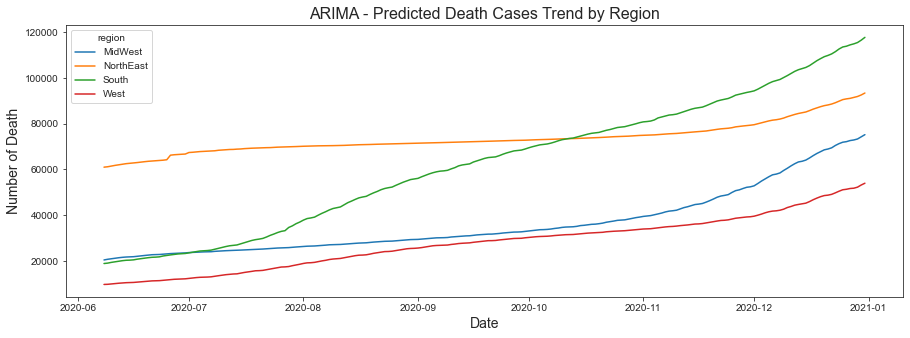

In [17]:
plt.figure(figsize=(15, 5))
sns.lineplot(data=region_Nov, x="date", y="ARIMA", hue="region")
plt.xlabel('Date', fontsize=14)
plt.ylabel('Number of Death', fontsize=14)
plt.title('ARIMA - Predicted Death Cases Trend by Region', fontsize=16)

Text(0.5, 1.0, 'HWAAS - Predicted Death Cases Trend by Region')

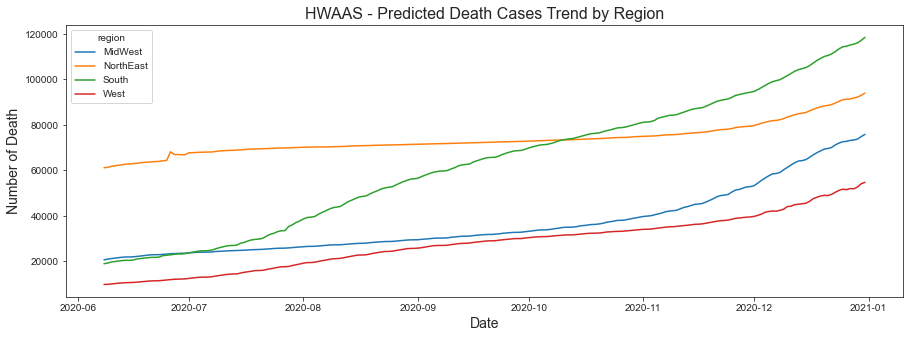

In [18]:
plt.figure(figsize=(15, 5))
sns.lineplot(data=region_Nov, x="date", y="HWAAS", hue="region")
plt.xlabel('Date', fontsize=14)
plt.ylabel('Number of Death', fontsize=14)
plt.title('HWAAS - Predicted Death Cases Trend by Region', fontsize=16)

Text(0.5, 1.0, 'Prohphet - Predicted Death Cases Trend by Region')

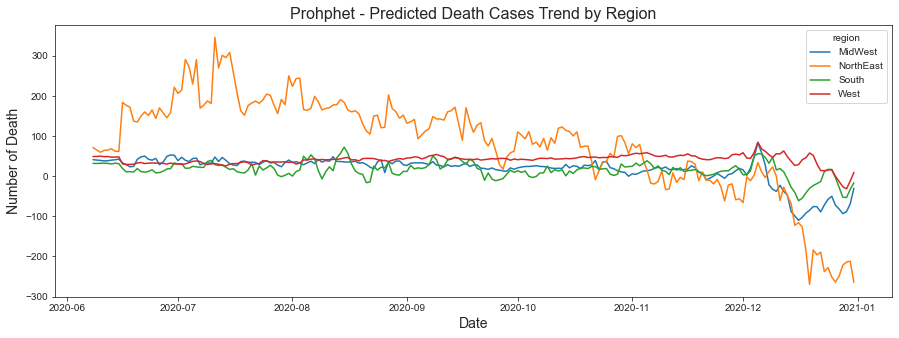

In [23]:
plt.figure(figsize=(15, 5))
sns.lineplot(data=region_Nov, x="date", y="Prohphet", hue="region")
plt.xlabel('Date', fontsize=14)
plt.ylabel('Number of Death', fontsize=14)
plt.title('Prohphet - Predicted Death Cases Trend by Region', fontsize=16)

## State Inpatient Bed

In [26]:
data_patient = pd.read_csv('./DATA/COVID-19_Reported_Patient_Impact_and_Hospital_Capacity_by_State_Timeseries.csv')
data_patient = data_patient[['date', 'state', 'inpatient_beds_used_covid']]
data_patient['date'] = pd.to_datetime(data_patient['date'])
data_patient = data_patient[(data_patient['date'] >= '2020-03-08') & (data_patient['date'] < '2021-01-01')]

In [27]:
data_patient_group = data_patient.groupby(['state'], as_index=False).sum()
data_patient_group = data_patient_group.sort_values(by=['inpatient_beds_used_covid'], ascending=False)
top_state = data_patient_group['state'][:5].tolist()
top_state

['CA', 'TX', 'FL', 'NY', 'IL']

In [29]:
data_patient_top = data_patient[data_patient['state'].isin(top_state)].sort_values(by=['date'])

Text(0.5, 1.0, 'Inpatient Beds Used Covid by State')

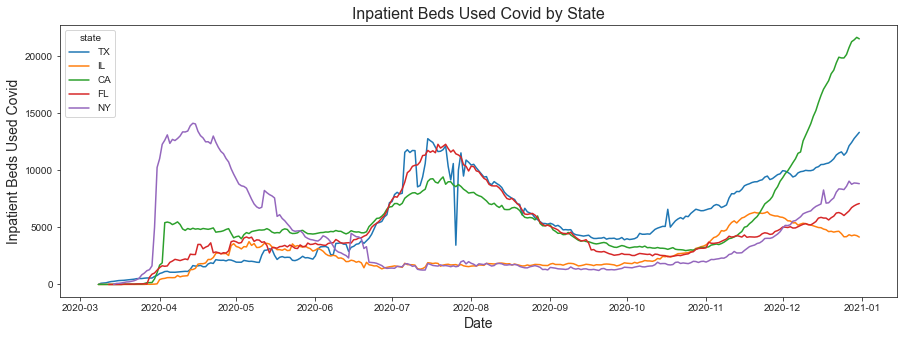

In [30]:
plt.figure(figsize=(15, 5))
sns.lineplot(data=data_patient_top, x="date", y="inpatient_beds_used_covid", hue="state")
plt.xlabel('Date', fontsize=14)
plt.ylabel('Inpatient Beds Used Covid', fontsize=14)
plt.title('Inpatient Beds Used Covid by State', fontsize=16)

In [32]:
# Performance Matrix
state_perform = pd.DataFrame(columns=['state', 'ARIMA', 'HWAAS', 'Prohphet'])
state_perform['state'] = top_state

In [33]:
# Predicted Values
data_patient_top_test = data_patient_top[data_patient_top['date'] >='2020-06-08'].copy()
state_Nov = data_patient_top_test.reindex(columns=['date', 'state', 'inpatient_beds_used_covid', 
                                                   'ARIMA', 'HWAAS', 'Prohphet'])  
state_Nov['date'] = state_Nov['date'].dt.date.astype(str)

### ARIMA

In [34]:
# forecasting
date_list = data_patient_top_test['date'].dt.date.astype(str).unique().tolist()

for i in date_list:
    data_patient_train = data_patient_top[data_patient_top['date'] < i]
    for j in top_state:
        train = data_patient_train[data_patient_train['state'] == j].reset_index()['inpatient_beds_used_covid'].astype(float)
        model = ARIMA(train, order=(1,0,1))
        model_fit = model.fit()
        y_hat = model_fit.forecast().iloc[0]
        state_Nov.loc[(state_Nov['date'] == i) & (state_Nov['state'] == j), 'ARIMA'] = y_hat
        

/Users/chester/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


In [41]:
# evaluate forecasts
for j in top_state:
    result = state_Nov[state_Nov['state'] == j]
    rmse = math.sqrt(mean_squared_error(result['inpatient_beds_used_covid'], result['ARIMA'])) 
    state_perform.loc[state_perform['state'] == j, 'ARIMA'] = rmse
    print(j + ' Test RMSE: %.4f' % rmse)

CA Test RMSE: 234.0898
TX Test RMSE: 877.4031
FL Test RMSE: 206.8405
NY Test RMSE: 291.4210
IL Test RMSE: 119.4307


### HWAAS

In [37]:
# forecasting
for i in date_list:
    data_patient_train = data_patient_top[data_patient_top['date'] < i]
    for j in top_state:
        train = data_patient_train[data_patient_train['state'] == j].reset_index()['inpatient_beds_used_covid'].astype(float)
        model = ExponentialSmoothing(endog=train, trend='add', initialization_method='estimated')
        model_fit = model.fit()
        y_hat = model_fit.forecast().iloc[0]
        state_Nov.loc[(state_Nov['date'] == i) & (state_Nov['state'] == j), 'HWAAS'] = y_hat
        

/Users/chester/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/holtwinters/model.py:920: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/Users/chester/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/holtwinters/model.py:920: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/Users/chester/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/holtwinters/model.py:920: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/Users/chester/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/holtwinters/model.py:920: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/Users/chester/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/holtwinters/model.py:920: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  warnings.warn(
/Users/chester/opt/anaconda3/lib/python3.9/site-packages/sta

In [42]:
# evaluate forecasts
for j in top_state:
    result = state_Nov[state_Nov['state'] == j]
    rmse = math.sqrt(mean_squared_error(result['inpatient_beds_used_covid'], result['HWAAS'])) 
    state_perform.loc[state_perform['state'] == j, 'HWAAS'] = rmse
    print(j + ' Test RMSE: %.4f' % rmse)

CA Test RMSE: 180.1654
TX Test RMSE: 860.5358
FL Test RMSE: 186.4465
NY Test RMSE: 287.7399
IL Test RMSE: 113.6593


### Prohphet

In [43]:
# forecasting
for i in date_list:
    data_patient_train = data_patient_top[data_patient_top['date'] < i]
    for j in top_state:
        train = data_patient_train[data_patient_train['state'] == j].reset_index()[['date', 'inpatient_beds_used_covid']]
        train = train.rename(columns={'inpatient_beds_used_covid': 'y', 'date': 'ds'})
        model = Prophet(yearly_seasonality=True, daily_seasonality=True)
        model_fit = model.fit(train)
        future_dates=model.make_future_dataframe(periods=1)
        y_hat = model_fit.predict(future_dates).iloc()[0]['yhat']
        state_Nov.loc[(state_Nov['date'] == i) & (state_Nov['state'] == j), 'Prohphet'] = y_hat
        


Initial log joint probability = -148.771
Iteration  1. Log joint probability =    62.1277. Improved by 210.899.
Iteration  2. Log joint probability =    105.362. Improved by 43.2346.
Iteration  3. Log joint probability =    158.706. Improved by 53.3434.
Iteration  4. Log joint probability =    172.894. Improved by 14.1879.
Iteration  5. Log joint probability =    175.615. Improved by 2.72146.
Iteration  6. Log joint probability =    176.628. Improved by 1.0134.
Iteration  7. Log joint probability =    177.019. Improved by 0.390082.
Iteration  8. Log joint probability =    177.045. Improved by 0.0268552.
Iteration  9. Log joint probability =    177.162. Improved by 0.116326.
Iteration 10. Log joint probability =    177.322. Improved by 0.160156.
Iteration 11. Log joint probability =    177.383. Improved by 0.0607871.
Iteration 12. Log joint probability =    177.427. Improved by 0.0440076.
Iteration 13. Log joint probability =    177.465. Improved by 0.0379364.
Iteration 14. Log joint p

In [45]:
# evaluate forecasts
for j in top_state:
    result = state_Nov[state_Nov['state'] == j]
    rmse = math.sqrt(mean_squared_error(result['inpatient_beds_used_covid'], result['Prohphet'])) 
    state_perform.loc[state_perform['state'] == j, 'Prohphet'] = rmse
    print(j + ' Test RMSE: %.4f' % rmse)

CA Test RMSE: 8380.9653
TX Test RMSE: 8024.8194
FL Test RMSE: 6056.1132
NY Test RMSE: 2640.6302
IL Test RMSE: 3239.6292


### Results

In [46]:
state_perform

,state,ARIMA,HWAAS,Prohphet
0,CA,234.089843,180.165378,8380.965303
1,TX,877.403072,860.535838,8024.819408
2,FL,206.840458,186.446489,6056.11319
3,NY,291.420997,287.739855,2640.630155
4,IL,119.43074,113.659265,3239.629199


In [47]:
state_Nov['date']= pd.to_datetime(state_Nov['date'])

Text(0.5, 1.0, 'ARIMA - Predicted Inpatient Beds Used Covid by State')

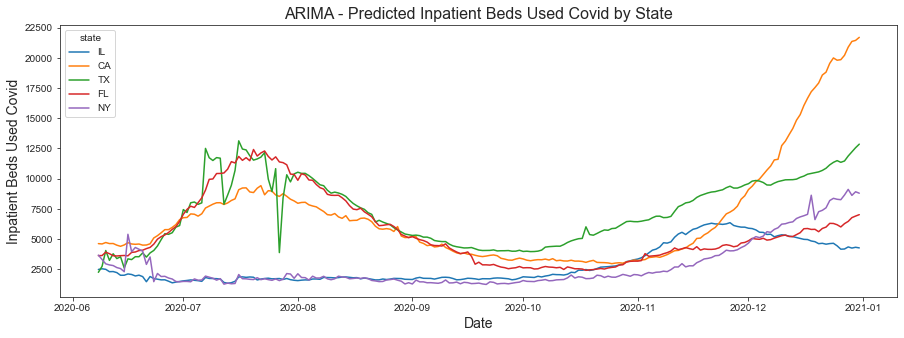

In [48]:
plt.figure(figsize=(15, 5))
sns.lineplot(data=state_Nov, x="date", y="ARIMA", hue="state")
plt.xlabel('Date', fontsize=14)
plt.ylabel('Inpatient Beds Used Covid', fontsize=14)
plt.title('ARIMA - Predicted Inpatient Beds Used Covid by State', fontsize=16)

Text(0.5, 1.0, 'HWAAS - Predicted Inpatient Beds Used Covid by State')

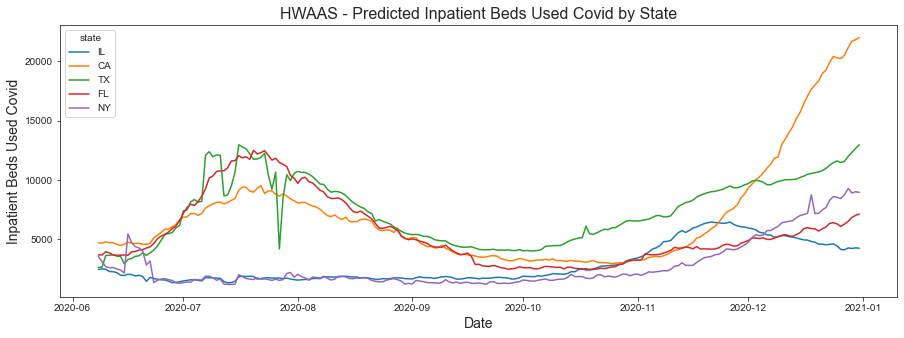

In [49]:
plt.figure(figsize=(15, 5))
sns.lineplot(data=state_Nov, x="date", y="HWAAS", hue="state")
plt.xlabel('Date', fontsize=14)
plt.ylabel('Inpatient Beds Used Covid', fontsize=14)
plt.title('HWAAS - Predicted Inpatient Beds Used Covid by State', fontsize=16)

Text(0.5, 1.0, 'Prohphet - Predicted Inpatient Beds Used Covid by State')

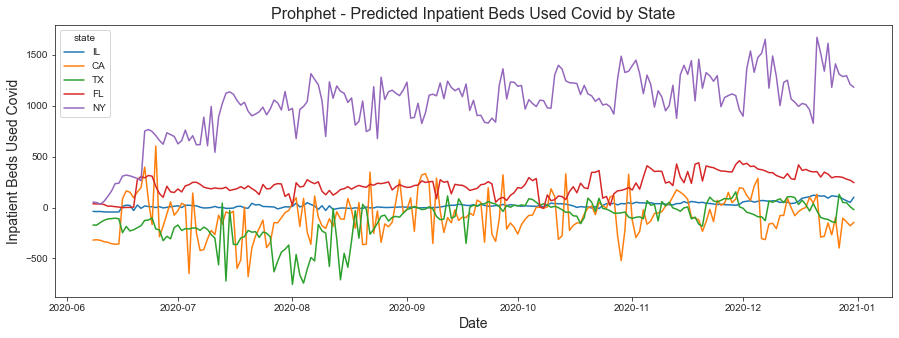

In [53]:
plt.figure(figsize=(15, 5))
sns.lineplot(data=state_Nov, x="date", y="Prohphet", hue="state")
plt.xlabel('Date', fontsize=14)
plt.ylabel('Inpatient Beds Used Covid', fontsize=14)
plt.title('Prohphet - Predicted Inpatient Beds Used Covid by State', fontsize=16)

## County Deaths

In [68]:
data_county = pd.read_csv('./DATA/us-counties.csv')
data_county = data_county[['date', 'county', 'deaths']]
data_county['date'] = pd.to_datetime(data_county['date'])
data_county = data_county[(data_county['date'] >= '2020-03-08') & (data_county['date'] < '2021-01-01')]

In [69]:
data_pop = pd.read_csv('./DATA/co-est2020.csv')
data_pop = data_pop[['CTYNAME', 'POPESTIMATE2020']]
data_pop = data_pop.sort_values(by=['POPESTIMATE2020'], ascending=False)
data_pop = data_pop[data_pop['CTYNAME'].str[-6:] == 'County']
top_county = data_pop['CTYNAME'][:5].str[:-7].tolist()
#top_county = ['Washington', 'New York City', 'Los Angeles', 'Ohio', 'Indiana']

In [70]:
data_county_top = data_county[data_county['county'].isin(top_county)]
data_county_top = data_county_top.groupby(['date', 'county'], as_index=False).sum()

Text(0.5, 1.0, 'Death Cases Trend by County')

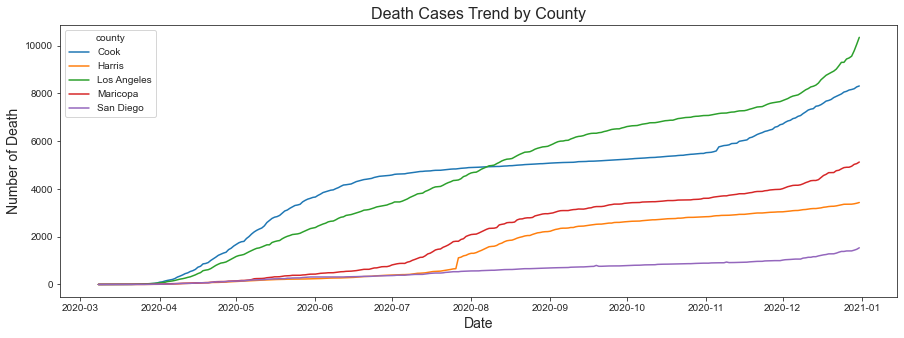

In [72]:
plt.figure(figsize=(15, 5))
sns.lineplot(data=data_county_top, x="date", y="deaths", hue="county")
plt.xlabel('Date', fontsize=14)
plt.ylabel('Number of Death', fontsize=14)
plt.title('Death Cases Trend by County', fontsize=16)

In [73]:
# Performance Matrix
county_perform = pd.DataFrame(columns=['county', 'ARIMA', 'HWAAS', 'Prohphet'])
county_list = data_county_top['county'].unique().tolist()
county_perform['county'] = county_list

In [74]:
# Predicted Values
data_county_test = data_county_top[data_county_top['date'] >= '2020-06-08'].copy()
county_Nov = data_county_test.reindex(columns=['date', 'county', 'deaths', 'ARIMA', 'HWAAS', 'Prohphet'])  
county_Nov['date'] = county_Nov['date'].dt.date.astype(str)

### ARIMA

In [75]:
# forecasting
date_list = data_county_test['date'].dt.date.astype(str).unique().tolist()

for i in date_list:
    data_county_train = data_county_top[data_county_top['date'] < i]
    for j in county_list:
        train = data_county_train[data_county_train['county'] == j].reset_index()['deaths'].astype(float)
        model = ARIMA(train, order=(1,0,0))
        model_fit = model.fit()
        y_hat = model_fit.forecast().iloc[0]
        county_Nov.loc[(county_Nov['date'] == i) & (county_Nov['county'] == j), 'ARIMA'] = y_hat

/Users/chester/opt/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


In [76]:
# evaluate forecasts
for j in county_list:
    result = county_Nov[county_Nov['county'] == j]
    rmse = math.sqrt(mean_squared_error(result['deaths'], result['ARIMA'])) 
    county_perform.loc[county_perform['county'] == j, 'ARIMA'] = rmse
    print(j + ' Test RMSE: %.4f' % rmse)

Cook Test RMSE: 32.3131
Harris Test RMSE: 36.8339
Los Angeles Test RMSE: 53.0878
Maricopa Test RMSE: 31.9196
San Diego Test RMSE: 11.2858


### HWAAS

In [77]:
# forecasting
for i in date_list:
    data_county_train = data_county_top[data_county_top['date'] < i]
    for j in county_list:
        train = data_county_train[data_county_train['county'] == j].reset_index()['deaths'].astype(float)
        model = ExponentialSmoothing(endog=train, trend='add', initialization_method='estimated')
        model_fit = model.fit()
        y_hat = model_fit.forecast().iloc[0]
        county_Nov.loc[(county_Nov['date'] == i) & (county_Nov['county'] == j), 'HWAAS'] = y_hat

In [84]:
# evaluate forecasts
for j in county_list:
    result = county_Nov[county_Nov['county'] == j]
    rmse = math.sqrt(mean_squared_error(result['deaths'], result['HWAAS'])) 
    county_perform.loc[county_perform['county'] == j, 'HWAAS'] = rmse
    print(j + ' Test RMSE: %.4f' % rmse)

Cook Test RMSE: 17.8971
Harris Test RMSE: 34.0306
Los Angeles Test RMSE: 27.7591
Maricopa Test RMSE: 19.8677
San Diego Test RMSE: 8.8598


### Prohphet

In [92]:
# forecasting
for i in date_list:
    data_county_train = data_county_top[data_county_top['date'] < i]
    for j in county_list:
        train = data_county_train[data_county_train['county'] == j].reset_index()[['date', 'deaths']]
        train = train.rename(columns={'deaths': 'y', 'date': 'ds'})
        model = Prophet(yearly_seasonality=True, daily_seasonality=True)
        model_fit = model.fit(train)
        future_dates=model.make_future_dataframe(periods=1)
        y_hat = model_fit.predict(future_dates).iloc()[0]['yhat']
        county_Nov.loc[(county_Nov['date'] == i) & (county_Nov['county'] == j), 'Prohphet'] = y_hat


Initial log joint probability = -145.035
Iteration  1. Log joint probability =    79.6406. Improved by 224.676.
Iteration  2. Log joint probability =    113.047. Improved by 33.4068.
Iteration  3. Log joint probability =    204.276. Improved by 91.2281.
Iteration  4. Log joint probability =    255.827. Improved by 51.5515.
Iteration  5. Log joint probability =    268.271. Improved by 12.4443.
Iteration  6. Log joint probability =     359.05. Improved by 90.7785.
Iteration  7. Log joint probability =    393.728. Improved by 34.6783.
Iteration  8. Log joint probability =    426.322. Improved by 32.5941.
Iteration  9. Log joint probability =    466.634. Improved by 40.312.
Iteration 10. Log joint probability =    470.847. Improved by 4.21314.
Iteration 11. Log joint probability =    472.033. Improved by 1.18565.
Iteration 12. Log joint probability =    472.154. Improved by 0.120698.
Iteration 13. Log joint probability =    473.822. Improved by 1.66778.
Iteration 14. Log joint probability

In [94]:
# evaluate forecasts
for j in county_list:
    result = county_Nov[county_Nov['county'] == j]
    rmse = math.sqrt(mean_squared_error(result['deaths'], result['Prohphet'])) 
    county_perform.loc[county_perform['county'] == j, 'Prohphet'] = rmse
    print(j + ' Test RMSE: %.4f' % rmse)

Cook Test RMSE: 5578.7107
Harris Test RMSE: 2319.4927
Los Angeles Test RMSE: 6265.7647
Maricopa Test RMSE: 3127.9251
San Diego Test RMSE: 803.8392


### Results

In [95]:
county_perform

,county,ARIMA,HWAAS,Prohphet
0,Cook,32.313132,17.897088,5578.710749
1,Harris,36.833907,34.030646,2319.492668
2,Los Angeles,53.087788,27.759065,6265.764718
3,Maricopa,31.919584,19.867695,3127.925073
4,San Diego,11.285782,8.859847,803.839185


In [96]:
county_Nov['date']= pd.to_datetime(county_Nov['date'])

Text(0.5, 1.0, 'ARIMA - Predicted Number of Death by County')

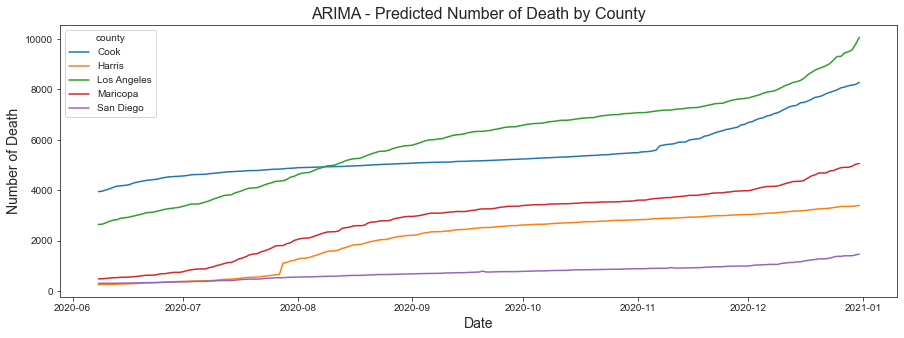

In [97]:
plt.figure(figsize=(15, 5))
sns.lineplot(data=county_Nov, x="date", y="ARIMA", hue="county")
plt.xlabel('Date', fontsize=14)
plt.ylabel('Number of Death', fontsize=14)
plt.title('ARIMA - Predicted Number of Death by County', fontsize=16)

Text(0.5, 1.0, 'HWAAS - Predicted Number of Death by County')

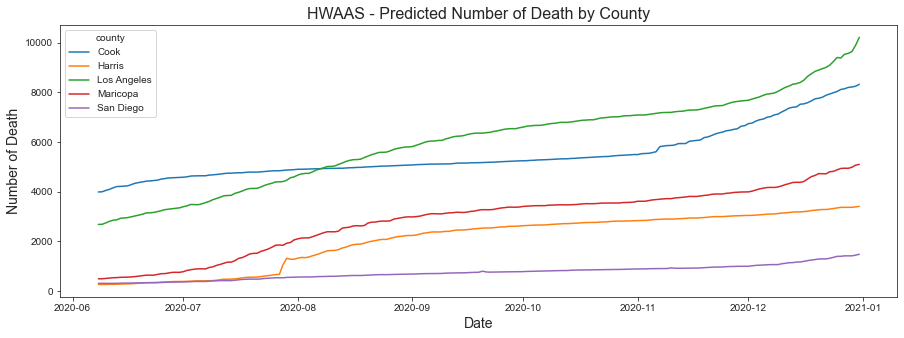

In [98]:
plt.figure(figsize=(15, 5))
sns.lineplot(data=county_Nov, x="date", y="HWAAS", hue="county")
plt.xlabel('Date', fontsize=14)
plt.ylabel('Number of Death', fontsize=14)
plt.title('HWAAS - Predicted Number of Death by County', fontsize=16)

Text(0.5, 1.0, 'Prohphet - Predicted Number of Death by County')

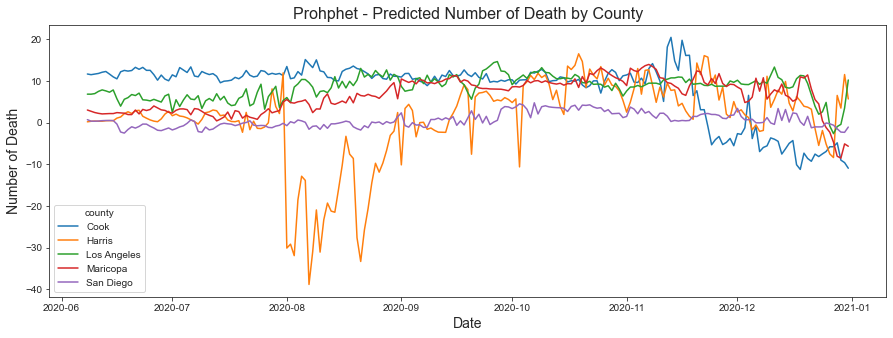

In [99]:
plt.figure(figsize=(15, 5))
sns.lineplot(data=county_Nov, x="date", y="Prohphet", hue="county")
plt.xlabel('Date', fontsize=14)
plt.ylabel('Number of Death', fontsize=14)
plt.title('Prohphet - Predicted Number of Death by County', fontsize=16)

### RT

In [17]:
rt_df = pd.read_csv('./DATA/rt.csv')
rt_df['date'] = pd.to_datetime(rt_df['date'])
rt_df = rt_df[(rt_df['date'] >= '2020-03-08') & (rt_df['date'] <= '2020-12-31')]
rt_df = rt_df[['date','region','mean']]

st_code = pd.read_csv('./DATA/state_code.csv')
st_code = st_code[['State','Code']]

NE_region = ['Maine', 'New Hampshire', 'Vermont', 'Massachusetts', 'Rhode Island', 'Connecticut', 'New York', 
             'New Jersey', 'Pennsylvania']
MW_region = ['Ohio', 'Michigan', 'Indiana', 'Wisconsin', 'Illinois', 'Minnesota', 'Iowa', 'Missouri', 'North Dakota', 
           'South Dakota', 'Nebraska', 'Kansas']
S_region = ['Delaware', 'Maryland', 'Virginia', 'West Virginia', 'Kentucky', 'North Carolina', 'South Carolina', 
         'Tennessee', 'Georgia', 'Florida', 'Alabama', 'Mississippi', 'Arkansas', 'Louisiana', 'Texas', 'Oklahoma']
W_region = ['Montana', 'Idaho', 'Wyoming', 'Colorado', 'New Mexico', 'Arizona', 'Utah', 'Nevada', 'California', 
        'Oregon', 'Washington', 'Alaska', 'Hawaii']

for index, row in rt_df.iterrows():
    code = rt_df.loc[index, 'region']
    state = st_code[st_code['Code'] == code]['State'].values[0]
    if state in NE_region:
        rt_df.loc[index, 'section'] = 'NorthEast'
    if state in MW_region:
        rt_df.loc[index, 'section'] = 'MidWest'
    if state in S_region:
        rt_df.loc[index, 'section'] = 'South'
    if state in W_region:
        rt_df.loc[index, 'section'] = 'West'
        
data_section = rt_df.dropna()
data_section = data_section.groupby(['date', 'section'], as_index=False).sum()

Text(0.5, 1.0, 'RT Trend by Section')

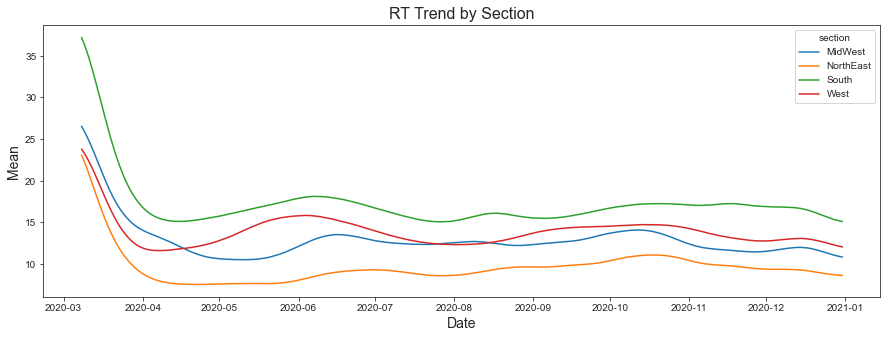

In [40]:
plt.figure(figsize=(15, 5))
sns.lineplot(data=data_section, x="date", y="mean", hue="section")
plt.xlabel('Date', fontsize=14)
plt.ylabel('Mean', fontsize=14)
plt.title('RT Trend by Section', fontsize=16)

In [19]:
# Performance Matrix
region_mean_perform = pd.DataFrame(columns=['section', 'ARIMA', 'HWAAS', 'Prohphet'])
region_mean_perform['section'] = ['NorthEast', 'MidWest', 'South', 'West']

In [20]:
# Predicted Values
data_region_mean_test = data_section[data_section['date'] >= '2020-06-08'].copy()
region_mean_Nov = data_region_mean_test.reindex(columns=['date', 'section', 'mean', 'ARIMA', 'HWAAS', 'Prohphet'])  
region_mean_Nov['date'] = region_mean_Nov['date'].dt.date.astype(str)

### ARIMA

In [21]:
# forecasting
section_list = ['MidWest', 'NorthEast', 'South', 'West']
date_list = data_region_mean_test['date'].dt.date.astype(str).unique().tolist()

for i in date_list:
    data_region_mean_train = data_section[data_section['date'] < i]
    for j in section_list:
        train = data_region_mean_train[data_region_mean_train['section'] == j].reset_index()['mean'].astype(float)
        model = ARIMA(train, order=(1,0,0))
        model_fit = model.fit()
        y_hat = model_fit.forecast().iloc[0]
        region_mean_Nov.loc[(region_mean_Nov['date'] == i) & (region_mean_Nov['section'] == j), 'ARIMA'] = y_hat

/Users/chester/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/chester/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/chester/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/chester/opt/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/chester/opt/anaconda3/lib/python3.9/s

In [23]:
# evaluate forecasts
for j in section_list:
    result = region_mean_Nov[region_mean_Nov['section'] == j]
    rmse = math.sqrt(mean_squared_error(result['mean'], result['ARIMA'])) 
    region_mean_perform.loc[region_mean_perform['section'] == j, 'ARIMA'] = rmse
    print(j + ' Test RMSE: %.4f' % rmse)

MidWest Test RMSE: 0.0524
NorthEast Test RMSE: 0.0369
South Test RMSE: 0.0553
West Test RMSE: 0.0544


### HWAAS

In [24]:
# forecasting
for i in date_list:
    data_region_mean_train = data_section[data_section['date'] < i]
    for j in section_list:
        train = data_region_mean_train[data_region_mean_train['section'] == j].reset_index()['mean'].astype(float)
        model = ExponentialSmoothing(endog=train, trend='add', initialization_method='estimated')
        model_fit = model.fit()
        y_hat = model_fit.forecast().iloc[0]
        region_mean_Nov.loc[(region_mean_Nov['date'] == i) & (region_mean_Nov['section'] == j), 'HWAAS'] = y_hat

In [26]:
# evaluate forecasts
for j in section_list:
    result = region_mean_Nov[region_mean_Nov['section'] == j]
    rmse = math.sqrt(mean_squared_error(result['mean'], result['HWAAS'])) 
    region_mean_perform.loc[region_mean_perform['section'] == j, 'HWAAS'] = rmse
    print(j + ' Test RMSE: %.4f' % rmse)

MidWest Test RMSE: 0.0085
NorthEast Test RMSE: 0.0063
South Test RMSE: 0.0091
West Test RMSE: 0.0071


### Prohphet

In [28]:
# forecasting
for i in date_list:
    data_region_mean_train = data_section[data_section['date'] < i]
    for j in section_list:
        train = data_region_mean_train[data_region_mean_train['section'] == j].reset_index()[['date', 'mean']]
        train = train.rename(columns={'mean': 'y', 'date': 'ds'})
        model = Prophet(yearly_seasonality=True, daily_seasonality=True)
        model_fit = model.fit(train)
        future_dates=model.make_future_dataframe(periods=1)
        y_hat = model_fit.predict(future_dates).iloc()[0]['yhat']
        region_mean_Nov.loc[(region_mean_Nov['date'] == i) & (region_mean_Nov['section'] == j), 'Prohphet'] = y_hat


Initial log joint probability = -146.761
Iteration  1. Log joint probability =    68.3716. Improved by 215.132.
Iteration  2. Log joint probability =    126.857. Improved by 58.4849.
Iteration  3. Log joint probability =    207.173. Improved by 80.3163.
Iteration  4. Log joint probability =    210.943. Improved by 3.77061.
Iteration  5. Log joint probability =    260.077. Improved by 49.1331.
Iteration  6. Log joint probability =    295.672. Improved by 35.5956.
Iteration  7. Log joint probability =    363.321. Improved by 67.6492.
Iteration  8. Log joint probability =    390.014. Improved by 26.6925.
Iteration  9. Log joint probability =    472.546. Improved by 82.5318.
Iteration 10. Log joint probability =     497.86. Improved by 25.3144.
Iteration 11. Log joint probability =    530.308. Improved by 32.4475.
Iteration 12. Log joint probability =    575.641. Improved by 45.333.
Iteration 13. Log joint probability =    598.122. Improved by 22.4809.
Iteration 14. Log joint probability 


Initial log joint probability = -147.23
Iteration  1. Log joint probability =    58.2037. Improved by 205.434.
Iteration  2. Log joint probability =    130.616. Improved by 72.4118.
Iteration  3. Log joint probability =    189.896. Improved by 59.2802.
Iteration  4. Log joint probability =    251.624. Improved by 61.7283.
Iteration  5. Log joint probability =    289.256. Improved by 37.6319.
Iteration  6. Log joint probability =    318.114. Improved by 28.8585.
Iteration  7. Log joint probability =    390.727. Improved by 72.6129.
Iteration  8. Log joint probability =    425.183. Improved by 34.4554.
Iteration  9. Log joint probability =    425.375. Improved by 0.192741.
Iteration 10. Log joint probability =    425.464. Improved by 0.0883622.
Iteration 11. Log joint probability =    428.619. Improved by 3.1556.
Iteration 12. Log joint probability =    432.839. Improved by 4.22.
Iteration 13. Log joint probability =    433.596. Improved by 0.756362.
Iteration 14. Log joint probability 


Initial log joint probability = -147.774
Iteration  1. Log joint probability =     65.506. Improved by 213.28.
Iteration  2. Log joint probability =     124.49. Improved by 58.9841.
Iteration  3. Log joint probability =    194.069. Improved by 69.579.
Iteration  4. Log joint probability =    250.543. Improved by 56.4743.
Iteration  5. Log joint probability =    350.075. Improved by 99.5313.
Iteration  6. Log joint probability =    403.112. Improved by 53.0374.
Iteration  7. Log joint probability =    482.414. Improved by 79.3016.
Iteration  8. Log joint probability =    524.954. Improved by 42.5406.
Iteration  9. Log joint probability =     586.13. Improved by 61.1755.
Iteration 10. Log joint probability =    629.369. Improved by 43.2394.
Iteration 11. Log joint probability =    673.479. Improved by 44.1095.
Iteration 12. Log joint probability =    691.959. Improved by 18.4805.
Iteration 13. Log joint probability =    758.894. Improved by 66.9347.
Iteration 14. Log joint probability =


Initial log joint probability = -148.199
Iteration  1. Log joint probability =    61.9164. Improved by 210.115.
Iteration  2. Log joint probability =    127.583. Improved by 65.6667.
Iteration  3. Log joint probability =    184.787. Improved by 57.2039.
Iteration  4. Log joint probability =    293.968. Improved by 109.181.
Iteration  5. Log joint probability =    327.289. Improved by 33.3215.
Iteration  6. Log joint probability =    369.142. Improved by 41.8526.
Iteration  7. Log joint probability =    427.994. Improved by 58.8521.
Iteration  8. Log joint probability =    497.478. Improved by 69.4836.
Iteration  9. Log joint probability =    505.627. Improved by 8.14915.
Iteration 10. Log joint probability =    517.541. Improved by 11.9144.
Iteration 11. Log joint probability =    548.042. Improved by 30.5004.
Iteration 12. Log joint probability =    573.554. Improved by 25.5119.
Iteration 13. Log joint probability =    659.286. Improved by 85.7319.
Iteration 14. Log joint probability


Initial log joint probability = -150.064
Iteration  1. Log joint probability =    60.2254. Improved by 210.289.
Iteration  2. Log joint probability =    139.593. Improved by 79.3681.
Iteration  3. Log joint probability =    196.096. Improved by 56.5022.
Iteration  4. Log joint probability =    282.517. Improved by 86.4211.
Iteration  5. Log joint probability =    326.484. Improved by 43.9668.
Iteration  6. Log joint probability =    379.308. Improved by 52.8248.
Iteration  7. Log joint probability =    416.115. Improved by 36.8069.
Iteration  8. Log joint probability =     500.34. Improved by 84.2251.
Iteration  9. Log joint probability =    532.499. Improved by 32.159.
Iteration 10. Log joint probability =    538.959. Improved by 6.45937.
Iteration 11. Log joint probability =    555.952. Improved by 16.993.
Iteration 12. Log joint probability =    625.986. Improved by 70.034.
Iteration 13. Log joint probability =    656.979. Improved by 30.9935.
Iteration 14. Log joint probability = 


Initial log joint probability = -149.794
Iteration  1. Log joint probability =    14.8997. Improved by 164.694.
Iteration  2. Log joint probability =    149.859. Improved by 134.959.
Iteration  3. Log joint probability =    239.395. Improved by 89.5357.
Iteration  4. Log joint probability =    294.219. Improved by 54.8244.
Iteration  5. Log joint probability =    311.441. Improved by 17.222.
Iteration  6. Log joint probability =    423.298. Improved by 111.857.
Iteration  7. Log joint probability =    477.617. Improved by 54.3194.
Iteration  8. Log joint probability =    521.443. Improved by 43.826.
Iteration  9. Log joint probability =    565.711. Improved by 44.2671.
Iteration 10. Log joint probability =    611.535. Improved by 45.8247.
Iteration 11. Log joint probability =    658.126. Improved by 46.5912.
Iteration 12. Log joint probability =    708.581. Improved by 50.4543.
Iteration 13. Log joint probability =     747.19. Improved by 38.6091.
Iteration 14. Log joint probability =


Initial log joint probability = -150.134
Iteration  1. Log joint probability =    67.3981. Improved by 217.532.
Iteration  2. Log joint probability =    116.843. Improved by 49.445.
Iteration  3. Log joint probability =    174.864. Improved by 58.0211.
Iteration  4. Log joint probability =    201.095. Improved by 26.2304.
Iteration  5. Log joint probability =    267.015. Improved by 65.9203.
Iteration  6. Log joint probability =    314.729. Improved by 47.714.
Iteration  7. Log joint probability =    384.891. Improved by 70.1617.
Iteration  8. Log joint probability =    424.714. Improved by 39.8233.
Iteration  9. Log joint probability =     482.42. Improved by 57.7059.
Iteration 10. Log joint probability =    544.328. Improved by 61.9084.
Iteration 11. Log joint probability =    567.596. Improved by 23.2674.
Iteration 12. Log joint probability =    585.538. Improved by 17.9424.
Iteration 13. Log joint probability =    612.616. Improved by 27.0783.
Iteration 14. Log joint probability =


Initial log joint probability = -150.798
Iteration  1. Log joint probability =    37.6397. Improved by 188.438.
Iteration  2. Log joint probability =    147.985. Improved by 110.345.
Iteration  3. Log joint probability =    226.738. Improved by 78.7523.
Iteration  4. Log joint probability =    280.601. Improved by 53.8639.
Iteration  5. Log joint probability =    350.639. Improved by 70.0378.
Iteration  6. Log joint probability =    420.146. Improved by 69.5067.
Iteration  7. Log joint probability =    464.401. Improved by 44.2548.
Iteration  8. Log joint probability =    476.691. Improved by 12.2907.
Iteration  9. Log joint probability =    562.784. Improved by 86.0925.
Iteration 10. Log joint probability =    617.596. Improved by 54.8122.
Iteration 11. Log joint probability =    623.446. Improved by 5.85025.
Iteration 12. Log joint probability =     648.18. Improved by 24.7334.
Iteration 13. Log joint probability =     683.37. Improved by 35.1908.
Iteration 14. Log joint probability


Initial log joint probability = -151.101
Iteration  1. Log joint probability =     69.428. Improved by 220.529.
Iteration  2. Log joint probability =    108.025. Improved by 38.5967.
Iteration  3. Log joint probability =      185.9. Improved by 77.8757.
Iteration  4. Log joint probability =     244.32. Improved by 58.4192.
Iteration  5. Log joint probability =    304.817. Improved by 60.4972.
Iteration  6. Log joint probability =    346.729. Improved by 41.9124.
Iteration  7. Log joint probability =    401.578. Improved by 54.8492.
Iteration  8. Log joint probability =    438.594. Improved by 37.016.
Iteration  9. Log joint probability =    525.999. Improved by 87.4044.
Iteration 10. Log joint probability =    527.755. Improved by 1.75574.
Iteration 11. Log joint probability =    560.021. Improved by 32.2663.
Iteration 12. Log joint probability =    584.142. Improved by 24.121.
Iteration 13. Log joint probability =    605.432. Improved by 21.2902.
Iteration 14. Log joint probability =


Initial log joint probability = -151.797
Iteration  1. Log joint probability =    51.3713. Improved by 203.168.
Iteration  2. Log joint probability =    145.347. Improved by 93.9758.
Iteration  3. Log joint probability =    208.836. Improved by 63.4888.
Iteration  4. Log joint probability =    268.581. Improved by 59.7446.
Iteration  5. Log joint probability =    354.091. Improved by 85.5104.
Iteration  6. Log joint probability =    362.695. Improved by 8.60426.
Iteration  7. Log joint probability =     441.89. Improved by 79.1945.
Iteration  8. Log joint probability =    484.442. Improved by 42.5522.
Iteration  9. Log joint probability =      599.2. Improved by 114.758.
Iteration 10. Log joint probability =     643.41. Improved by 44.2097.
Iteration 11. Log joint probability =    685.912. Improved by 42.5026.
Iteration 12. Log joint probability =    746.402. Improved by 60.4892.
Iteration 13. Log joint probability =    782.641. Improved by 36.2392.
Iteration 14. Log joint probability


Initial log joint probability = -152.064
Iteration  1. Log joint probability =    71.0684. Improved by 223.132.
Iteration  2. Log joint probability =    97.0453. Improved by 25.977.
Iteration  3. Log joint probability =    192.953. Improved by 95.9072.
Iteration  4. Log joint probability =    236.856. Improved by 43.9035.
Iteration  5. Log joint probability =    245.558. Improved by 8.70192.
Iteration  6. Log joint probability =    305.377. Improved by 59.8195.
Iteration  7. Log joint probability =    366.027. Improved by 60.6494.
Iteration  8. Log joint probability =    411.905. Improved by 45.878.
Iteration  9. Log joint probability =    421.039. Improved by 9.13458.
Iteration 10. Log joint probability =    544.496. Improved by 123.457.
Iteration 11. Log joint probability =    598.253. Improved by 53.7572.
Iteration 12. Log joint probability =    617.216. Improved by 18.9631.
Iteration 13. Log joint probability =     640.13. Improved by 22.9139.
Iteration 14. Log joint probability =


Initial log joint probability = -152.793
Iteration  1. Log joint probability =    60.4439. Improved by 213.237.
Iteration  2. Log joint probability =     141.45. Improved by 81.0061.
Iteration  3. Log joint probability =    203.331. Improved by 61.8805.
Iteration  4. Log joint probability =    254.102. Improved by 50.7716.
Iteration  5. Log joint probability =    287.884. Improved by 33.7819.
Iteration  6. Log joint probability =    340.133. Improved by 52.2494.
Iteration  7. Log joint probability =    402.517. Improved by 62.3839.
Iteration  8. Log joint probability =    432.337. Improved by 29.8197.
Iteration  9. Log joint probability =    487.017. Improved by 54.6804.
Iteration 10. Log joint probability =    511.149. Improved by 24.1319.
Iteration 11. Log joint probability =      589.2. Improved by 78.0509.
Iteration 12. Log joint probability =    604.739. Improved by 15.5386.
Iteration 13. Log joint probability =     656.06. Improved by 51.3214.
Iteration 14. Log joint probability


Initial log joint probability = -153.023
Iteration  1. Log joint probability =    72.4368. Improved by 225.46.
Iteration  2. Log joint probability =    84.1461. Improved by 11.7093.
Iteration  3. Log joint probability =    198.388. Improved by 114.242.
Iteration  4. Log joint probability =     262.22. Improved by 63.8322.
Iteration  5. Log joint probability =    317.297. Improved by 55.0766.
Iteration  6. Log joint probability =    364.106. Improved by 46.8087.
Iteration  7. Log joint probability =    405.437. Improved by 41.3317.
Iteration  8. Log joint probability =     441.72. Improved by 36.2829.
Iteration  9. Log joint probability =    499.643. Improved by 57.9229.
Iteration 10. Log joint probability =    499.731. Improved by 0.087578.
Iteration 11. Log joint probability =    504.077. Improved by 4.34655.
Iteration 12. Log joint probability =    508.338. Improved by 4.26072.
Iteration 13. Log joint probability =    513.067. Improved by 4.72899.
Iteration 14. Log joint probability


Initial log joint probability = -153.785
Iteration  1. Log joint probability =    66.3121. Improved by 220.097.
Iteration  2. Log joint probability =    135.917. Improved by 69.6048.
Iteration  3. Log joint probability =    196.462. Improved by 60.5449.
Iteration  4. Log joint probability =    282.682. Improved by 86.22.
Iteration  5. Log joint probability =    358.958. Improved by 76.2762.
Iteration  6. Log joint probability =    412.216. Improved by 53.2577.
Iteration  7. Log joint probability =    416.099. Improved by 3.88368.
Iteration  8. Log joint probability =    490.289. Improved by 74.1899.
Iteration  9. Log joint probability =    598.916. Improved by 108.627.
Iteration 10. Log joint probability =    611.051. Improved by 12.1352.
Iteration 11. Log joint probability =    698.205. Improved by 87.1536.
Iteration 12. Log joint probability =    741.876. Improved by 43.6716.
Iteration 13. Log joint probability =    783.801. Improved by 41.9247.
Iteration 14. Log joint probability =


Initial log joint probability = -153.981
Iteration  1. Log joint probability =    73.6452. Improved by 227.627.
Iteration  2. Log joint probability =    134.091. Improved by 60.4457.
Iteration  3. Log joint probability =    195.673. Improved by 61.582.
Iteration  4. Log joint probability =    304.325. Improved by 108.652.
Iteration  5. Log joint probability =    401.968. Improved by 97.6437.
Iteration  6. Log joint probability =     447.72. Improved by 45.7519.
Iteration  7. Log joint probability =    532.006. Improved by 84.2856.
Iteration  8. Log joint probability =    570.147. Improved by 38.1415.
Iteration  9. Log joint probability =    595.899. Improved by 25.7517.
Iteration 10. Log joint probability =     621.06. Improved by 25.1611.
Iteration 11. Log joint probability =    637.505. Improved by 16.4451.
Iteration 12. Log joint probability =    696.944. Improved by 59.4382.
Iteration 13. Log joint probability =    704.602. Improved by 7.65866.
Iteration 14. Log joint probability 

Initial log joint probability = -5.62858
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        529.96    0.00218468       1718.22           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       550.674   0.000364164        994.39           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       640.492    0.00159934       11165.2      0.4729           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       654.169    0.00102023       4575.84           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       665.499   9.58627e-05        605.11           1           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.03252
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       572.834    0.00126005       3369.43           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       613.808   8.03574e-05       3551.29           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       624.894    0.00103212       3701.37           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       641.553   8.17167e-05       1241.29           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       642.955   0.000207798       583.332           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.79628
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       501.939     0.0096634       1730.62           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       511.866     3.717e-05       785.343           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       550.164    0.00221008       3429.63           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       573.221   0.000221961       1289.13           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       585.894    0.00103983       1508.69           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.29571
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       556.634    0.00398192       12557.9      0.4481           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       596.128   0.000756048       3276.94           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       612.987   0.000645933       2921.41           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       622.227    0.00200564       5228.69           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       644.964    0.00156206       3816.87           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.68539
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       589.028   5.59351e-05       7373.95      0.2103      0.2103      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       624.178   0.000206466       4598.89           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       626.922    0.00017878       1626.31      0.7824      0.7824      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       634.384    0.00023546       1798.19           1           1      437   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       636.488   0.000296089       3449.54      0.4693      0.4693      546   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.12518
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       561.999    0.00027853       857.921           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       598.578   0.000405942       4608.68           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       618.979   0.000883494       4425.33           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       650.733    0.00016595       1289.22           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       653.597   0.000286131       2099.13           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.83328
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       492.357     0.0138247       4712.45        0.51           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       545.987     0.0137911       13873.3           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       638.742    0.00130838       10173.7           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       645.668   2.47563e-05       3161.28      0.7556      0.7556      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       652.356   6.39535e-05       3415.32           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.29561
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        522.47      0.011589       8438.14       0.545       0.545      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       625.765   0.000483471       3640.07      0.9789      0.9789      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        641.52   3.29382e-05       922.062      0.8658      0.8658      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       649.788     0.0014865       18876.4           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       656.482   0.000443916       10476.2       0.461       0.461      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.73746
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       521.722      0.013503          3946           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       598.256    0.00168681       3090.97           1           1      222   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       628.616   0.000151008       7543.13           1           1      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        651.98     0.0026948       17063.9           1           1      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        660.02   0.000171967       3609.31           1           1      547   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.21495
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        575.01     0.0119686       5468.46           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       594.263    0.00154662       10457.6      0.3001           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       627.941    0.00244823       3867.43           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       648.963     0.0026507       4973.52           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        659.82   5.20806e-05       983.861           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.87099
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       529.265     0.0131824       15713.5       0.861       0.861      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       600.852    0.00824175       2889.72           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       608.626   0.000117115       1314.76           1           1      331   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       628.111     0.0165388       7202.55           1           1      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       647.679   0.000487453       6750.21      0.4613      0.4613      553   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.30026
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       582.049    0.00209865       1817.12           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       643.392     0.0244521       14237.8           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       691.024   0.000371293       2265.87           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       705.762   0.000331993       4864.79           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       711.614    0.00547319       9802.11           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.78514
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       565.174   0.000337954       1239.94      0.7233      0.7233      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       616.728    0.00055396       5110.72      0.9447      0.9447      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       639.276    0.00600348       3127.78           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       647.633   0.000199502       2837.21           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       650.489   0.000154222       4989.34      0.5144           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.30631
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       584.774    0.00011882        761.36      0.3726      0.3726      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       591.295   0.000420704       5177.04      0.6607      0.6607      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       607.829   0.000502235       1130.09           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        621.85   5.26208e-05       383.851           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       634.851   2.58902e-05       761.744      0.6153      0.6153      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

    9499       825.768   2.53684e-06       1555.12      0.6199      0.6199    10315   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    9599       825.783     6.708e-07       1903.04      0.6103      0.6103    10426   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    9699        826.04    0.00120434       11380.3           1           1    10537   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    9799       826.741     6.581e-05       11347.1      0.5807      0.5807    10644   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    9899       827.152   2.97388e-05       4665.38      0.7022      0.7022    10748   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    9999       828.831   2.48421e-05       5935.82           1           1    10861   
    Iter      log 

Initial log joint probability = -5.30648
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       554.241     0.0029956       4903.15      0.1957      0.1957      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       605.416   0.000786301       4238.93           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       627.473    0.00523428       8902.02           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       631.593   0.000303671       1273.51           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       652.771    0.00407729       16343.4      0.2952      0.2952      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.82666
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       567.657    0.00627088       5034.49           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       629.781    0.00111545       6056.64           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       636.007    0.00137585       6265.56           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       675.557    0.00014979       11600.1           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       683.894   0.000243279        3181.7      0.7373      0.7373      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.39871
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       619.074     0.0134087       6263.49           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       657.253    0.00738285       14965.8           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       684.721    0.00189228       14960.9           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       699.981   0.000616094       3201.11           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       705.581   0.000216002       5255.54           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.93898
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       578.432   0.000848521       1603.27           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       637.349     0.0128342       33558.9           1           1      222   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       680.881    0.00393682       17296.9           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       726.548    0.00106721       6891.54           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       737.321   4.04509e-06        4578.3      0.3815      0.3815      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.30793
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        625.53   0.000540253       3899.26           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       641.683    0.00738887       18374.7           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        660.02     0.0070716       4284.01           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       693.649   0.000736137         19313      0.5865      0.5865      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       726.234   0.000129601       7834.72           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.86572
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       541.795     0.0253277       50521.4           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       576.005    0.00573454       7772.44           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       603.208    0.00775776       2492.26           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       610.873   0.000655919       1955.98           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       617.821     0.0072013       6572.24       1.289      0.1289      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.48396
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       595.999     0.0213738       5168.38           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       617.641     0.0022648       4480.59           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       646.727    0.00170826       21450.2           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       664.482   0.000273188       13318.6           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       682.496   0.000266735       5454.76           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.96954
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       536.594   0.000520368       858.895           1           1      113   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       610.076   0.000416124       1246.57           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       636.973    0.00162945       6194.68      0.3672           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       648.284    0.00106058       2966.81           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       655.368   0.000167997        1719.4           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.31046
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       554.449    0.00275356       1057.51           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       645.446    0.00514976       3138.72           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       667.149     0.0181256       7418.82           1           1      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       697.263   6.14692e-06       551.923       0.215       0.215      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       705.994   6.22416e-05       565.695           1           1      550   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.90222
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       550.514    0.00062558       595.502           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        576.55   0.000110442       774.275           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       593.689   0.000473857       6325.04      0.7115      0.7115      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       638.178   0.000197137        3550.1      0.9106      0.9106      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       648.318   0.000211228       575.526           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.571
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       641.317     0.0272028       11042.2           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       678.601   0.000175876       2000.82           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       712.172   0.000631435        1754.7           1           1      330   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       721.214   0.000321021       4776.76           1           1      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        722.92    7.4661e-05       2331.05           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha    

Initial log joint probability = -5.99946
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       532.546    0.00074777       339.889           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       611.485    0.00359843       3109.19           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       644.085   0.000559289       3228.14           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       652.646    0.00232086       2953.54           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       666.263   7.32027e-05       667.049      0.4493      0.4493      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.31256
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       510.755    0.00639246       2458.61           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        565.71    0.00217191        847.31           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       611.636   0.000177569       231.337           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        630.47    0.00451938       3154.44           1           1      438   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       637.544    0.00303885       2226.79           1           1      547   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.93302
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       569.414    0.00177339       3758.56           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       643.296    0.00108654       8623.15           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       654.209   0.000750575       7502.12           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       661.241   5.53173e-05       2198.49      0.5003           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       667.209   3.42514e-05       1440.18      0.3331           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.65522
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       634.582    0.00240878       3926.46           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       646.826   0.000474737       6420.53      0.3598      0.3598      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       693.055    0.00194937       5897.92           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       715.497   0.000619348       5587.25           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        727.88   0.000186965       8253.02      0.5575      0.5575      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.02987
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       570.554    0.00906385       6146.75           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       638.724     0.0077135       19144.4           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       661.885    0.00385198       4845.76           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       671.678   7.89479e-05       1519.29      0.7476      0.7476      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       679.759   1.12902e-05       1051.28           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.3148
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       529.904   0.000275325       764.058           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       582.302    0.00314003       3579.36       0.495           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        608.92     0.0124859       6327.88           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       620.415    0.00423059       944.558           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       636.509    0.00114129       2767.44      0.2297           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -5.96275
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       575.403    7.9494e-05       1668.69      0.4786           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       636.335   0.000790103       2793.66           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       650.262   0.000372482       3857.08           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       680.163    0.00679999       38243.5           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       707.073   0.000110185       7817.69      0.7501      0.7501      548   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.73645
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       625.973     0.0292663       16299.5           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       665.564   0.000401898       3315.45           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       703.679   0.000782497       10400.3      0.4041           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       707.905   3.98607e-05       2496.28           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       731.018    6.5893e-06       3098.42      0.5975      0.5975      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.05678
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       558.142     0.0198091       10709.2           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       579.548    0.00170564       1463.03      0.4663           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       593.684    0.00692592        3166.7           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       663.402   0.000587735       1653.85           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       708.656    0.00223284       2700.35           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.3157
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       528.533   0.000590017       624.907           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        589.36    0.00174181       3300.57     0.09471      0.9542      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       643.645    0.00571824       2787.63      0.6383      0.6383      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       669.365   0.000552363       2145.14           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       673.265    0.00116945        1067.8           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -5.99237
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       581.746   0.000572378       1073.75           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       624.669    0.00161472       7352.04      0.8919      0.8919      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       638.287    0.00150146       2292.64           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       652.002   0.000259624       785.205           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       664.613   0.000922986       1346.37           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

    9999       895.318   1.31633e-05       618.133           1           1    10888   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
   10000       895.318   3.17494e-05        1830.5      0.4651           1    10890   
Optimization terminated normally: 
  Maximum number of iterations hit, may not be at an optima
Initial log joint probability = -7.81648
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       579.881   0.000247334       1187.17           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       635.347    0.00058831       2515.22           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       661.487    0.00115771        2117.9           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alph

Initial log joint probability = -6.08408
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       662.472   0.000862415       2673.37           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       697.788   0.000488629       2447.29      0.1807      0.1807      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       707.123    0.00144557       4429.67           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       712.664    0.00898059       19799.3           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       721.088   0.000480793       686.146      0.8374      0.8374      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.31416
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        530.73   0.000805462       841.724           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       569.322    0.00329411       681.697           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       595.525    0.00757156       2428.45           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       656.259     0.0096866       4783.25           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       670.412   0.000507949       5008.95       0.443       0.443      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.01511
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       588.383     0.0106698       7134.53      0.4867           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       640.206    0.00135279       2100.75      0.9774      0.9774      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        647.24   0.000458777       2042.31           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       673.133   0.000831591       1629.49      0.9995      0.9995      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       679.851    0.00100592       1695.62           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.90165
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       577.563    0.00407092       5266.18           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       632.205    0.00123634       642.955           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       676.321   7.11076e-05       3045.53      0.5358      0.5358      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       689.146   2.95672e-05       403.398           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       693.355    0.00497203       4636.56           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.11023
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       643.658   0.000183573       1329.31           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        669.55    0.00140089       729.842           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       685.158   0.000216624        1963.2      0.2861      0.2861      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       698.389   0.000921053       3649.39           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       713.047    0.00017225        2053.8           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.30955
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       607.244   0.000629497       1881.01      0.9333      0.9333      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       702.438    0.00319098       11912.5           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       747.845   2.68051e-05       3948.48       0.286       0.286      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       762.395   0.000116236       2459.56           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       767.715   5.37602e-05       2781.06      0.4964      0.4964      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.03498
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       603.408     0.0144027       2279.95           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       636.546    0.00309029       1166.73           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       707.653     0.0016801       8029.89           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       728.279   0.000717177        1602.5           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       733.495   2.82884e-05       2885.62           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.98124
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       566.986    0.00325637       5418.52           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       597.408   0.000565394       950.415      0.7647      0.7647      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       613.016    0.00030056       2678.49      0.5912      0.5912      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       624.315   0.000130924         649.2           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       643.274     0.0317093       7248.54           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.13703
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       658.016     0.0036443       5784.88           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       670.181   0.000100348       953.586      0.9699      0.9699      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       692.195     0.0010015       7171.81      0.4202           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       699.374   0.000849323       2614.98      0.2507           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       702.627   0.000422291       1115.07           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.30514
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       611.563   0.000651221       3221.33      0.8452      0.8452      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       682.998    0.00206405       3487.29           1           1      222   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       689.908    0.00138442       3453.85           1           1      330   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       702.043   0.000520802       1994.31           1           1      436   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       713.048   4.39695e-05       853.395           1           1      543   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.057
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       606.731      0.012921       11528.3           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       635.175    0.00123021       696.585      0.9208      0.9208      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       669.167   0.000565039       1599.57           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       765.203   0.000392429       2895.77      0.6496      0.6496      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       774.786    9.5703e-06       315.035           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha    

Initial log joint probability = -8.06116
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       569.183   0.000153626       1873.46      0.9323      0.9323      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       613.206   0.000305264       773.104           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       679.638    0.00440307       2186.99           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        687.47    0.00218867        2518.6           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       692.631   0.000234772       1355.74      0.4123           1      551   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.16021
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       637.648    0.00814431       6364.68      0.3373      0.3373      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       712.809   0.000451722       6654.86           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       738.272    0.00737152       32294.3           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       774.377   0.000203372       2454.15           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       778.614   2.36118e-05       1597.02      0.9365      0.9365      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

    9999       923.737   5.32156e-05        2008.1           1           1    11017   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
   10000       923.738   0.000196761       10752.3           1           1    11018   
Optimization terminated normally: 
  Maximum number of iterations hit, may not be at an optima
Initial log joint probability = -5.30372
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       632.809   0.000229775       1901.21      0.4856      0.4856      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       695.448    0.00350168       32428.8           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       773.744   0.000443265       19679.5           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alph

Initial log joint probability = -6.08187
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       637.361     0.0486922       21287.2      0.6992      0.6992      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       720.978    0.00179586       3924.07           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       733.873    0.00107922       3626.78           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       748.289   0.000117264       3350.09      0.4615      0.4615      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       753.177   4.05551e-05       1438.09           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.13691
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       580.884    0.00476456       4036.97      0.4939      0.9866      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       632.647   0.000169846       2040.64           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       641.183   0.000174113       1817.29           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       658.359    0.00265105       6150.03      0.6395      0.6395      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       667.458   4.10819e-05       1439.44      0.4654      0.4654      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.18421
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       639.688    0.00550776       3138.25           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       710.002    0.00358056         21224      0.6477      0.6477      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       787.199   3.51018e-05       7458.24           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       807.764    0.00388505       41670.2           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       829.738    0.00175895       71240.9      0.4315           1      549   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.30181
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       630.437    0.00215881       2422.57           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       654.148   0.000309816        2163.7           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        673.81    0.00385232       2687.53           1           1      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       689.155   0.000351962       3570.11      0.4152      0.4152      438   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       701.669    0.00452504        4949.7           1           1      544   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.10378
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       578.222    0.00153849       1308.83      0.4417           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       610.359    0.00116463       6128.68      0.3011      0.3011      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       682.878   2.37384e-05       7087.88      0.6142      0.6142      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        699.53   2.42929e-05       2579.01      0.8269      0.8269      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       706.346   0.000474341       5994.43           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.21036
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       556.551    0.00158913       1642.98           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       641.048     0.0247969         12643           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       663.804   0.000382843       1347.62           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       695.282    0.00165837       804.841           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       715.581    0.00134416       4175.49           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.21071
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       616.144    0.00188342       5658.15           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       764.561    0.00243517       16754.6           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       786.678   0.000143243       3471.93           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       805.687   0.000637167       3183.87      0.8963      0.8963      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       827.608   0.000236782       44007.3      0.4093      0.4093      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.30003
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       642.159     0.0123025       10385.9           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       736.579    0.00269712       12942.3           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       752.799   0.000137275       1449.91           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       758.047   0.000987341        8268.6           1           1      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       777.392   7.08912e-05       1502.45           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.12599
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       687.565      0.024985       10710.3           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       718.383   0.000208343       3445.31      0.4492      0.4492      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       755.293    0.00117166       4438.89           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       764.216   0.000121179       1484.69           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        768.56   0.000499812       4594.99      0.9698      0.9698      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.28073
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       613.979   0.000317768       1088.08           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       628.007   0.000631509        1386.6           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        675.68   0.000169979       5217.86      0.6805      0.6805      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       690.357   0.000332908        717.74           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       700.398    0.00151222       3274.75           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.23325
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       638.759     0.0390649       5848.03           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       706.759     0.0046663       11061.5           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       730.576   0.000205717        3773.4      0.4864      0.4864      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       737.022   0.000135256       2228.54           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       760.212   0.000354594        3292.7           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.2976
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       656.286    0.00365512       19956.6       0.286           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       674.825   0.000614094       5619.71      0.5579      0.5579      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       694.258     0.0290657       22527.3           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399         710.8   0.000165168       1406.81           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       720.484   0.000212912       2057.02           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -6.15043
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       702.749     0.0024304       2986.91           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       709.053    0.00168879        523.84           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       779.713   0.000283544       7844.02           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       797.539   8.70403e-05       13431.2      0.6415      0.6415      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       811.676   0.000550672       7719.58           1           1      549   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.34951
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       604.138    0.00300922       2208.09           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       650.404   9.42858e-05       2891.26           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       690.567    0.00045826       12695.2      0.6856      0.6856      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       696.353   3.70061e-05       1153.18           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       712.047    0.00075258        8555.2      0.9421      0.9421      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.25714
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       665.321   0.000260759       4616.31      0.2749      0.2749      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       696.539    0.00227802       2535.31           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       726.609    0.00602519       4539.38           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       749.896    0.00513428       3909.94           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       758.014    0.00269083       1775.27           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.29741
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       661.836    0.00181431       953.979           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       683.242    0.00183923       3252.17           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       701.146   0.000807548       5410.03           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       728.805    0.00211057       7116.27           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       766.846   0.000153854       4306.43           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.17731
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       686.254     0.0134242       11621.5           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       733.803    0.00165806       2651.15           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       755.721    0.00152233       5799.24      0.5244           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       759.053   0.000456988       6514.65      0.8623      0.8623      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       773.225    0.00286548         10623           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.41579
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       594.397     0.0227035       3157.24           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       664.496    0.00123329       6272.67           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       706.141     0.0267546       21850.9      0.2714           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       732.813   0.000857563       5159.98           1           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       757.375    0.00205133       8226.95           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.27955
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        618.09     0.0311831       12102.1           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       721.845   0.000152968       1544.71           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       751.411   0.000165826       4205.65       0.729       0.729      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       759.355   0.000191508       2872.52           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       763.432   6.81562e-05       2262.18           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.29326
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       671.727   0.000278458       3164.45           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       713.034    0.00084814       10649.7      0.1907           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       722.135    0.00240792          5640           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       743.724   0.000936467       1974.26      0.1521           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       769.246   0.000299463       1022.06           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.20894
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       756.573      0.241673        199356           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       806.312   0.000101578       2320.03           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       831.827    0.00169424         11342           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       849.721    2.5911e-05       1777.91           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       852.596    0.00168677       4922.58           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.47889
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       697.178    0.00330379       13086.3           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       708.105   0.000658368         11771           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       763.552   1.82425e-05       725.821      0.7925      0.7925      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       766.092   0.000309141       1112.69           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        776.32   0.000296887       1475.81           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.3041
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       632.199    0.00850525       3519.51           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        696.08    0.00115454       3504.26           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       714.955   0.000425919       4409.82           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       731.518    0.00155601       5956.01           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        737.08   0.000486352        5224.7      0.5159           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -5.29351
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       667.071   0.000555158       1084.94           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       686.254    0.00014485       1866.69           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       695.497   9.80434e-05       2107.39           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       730.764     0.0453943       17728.4           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       747.538   0.000752055       1397.99           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.23975
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       691.355   0.000351383       1735.39           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       779.224   0.000116448       7939.89      0.2392           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       798.894   0.000189541       1340.25      0.1424           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       809.887   8.21746e-05       1969.16           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       817.299    0.00018382        1467.4           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.53931
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       684.057    0.00295068       19508.6      0.6439      0.6439      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       719.476   0.000782313       9348.71      0.2704           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       772.577   0.000474646       1540.32           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       793.674     0.0042089       17925.2           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       802.938   0.000186297       7263.74      0.9035      0.9035      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.32809
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       641.159    0.00520179       1678.54           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       696.512    0.00291656       2706.65           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        727.01   0.000924115       4393.61           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       749.826   0.000113565       4045.45      0.3708           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       770.967   4.49989e-05       1815.63           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.29201
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       746.972    0.00155315       6505.37           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        812.73   0.000217878       6265.54           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       830.914    0.00178526       13138.2           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       837.548   0.000584267       5878.53      0.4181           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       852.671   0.000552101       13746.5           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.27168
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       658.062   0.000375387       3616.54           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       760.659   0.000225617       2233.24           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       770.635    0.00462829       8501.36           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       800.434   8.87301e-05       2407.85      0.4456      0.4456      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       815.552    0.00042076       4818.35           1           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.60162
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       682.993    0.00325852       29410.7           1           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       751.503   0.000267916       2595.08      0.5931      0.5931      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       761.338     0.0208083       23045.4           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       765.469    0.00108357       672.026           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       767.882   0.000960161       1383.42           1           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.35292
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       637.026     0.0015484       5341.98           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       683.002       0.01158       6533.04           1           1      219   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       703.002     0.0350046       4198.34           1           1      325   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       712.948   0.000829175       1596.95           1           1      438   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       720.738     0.0007523        2107.4           1           1      543   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.29067
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       729.632    0.00274789       5402.32       0.645       0.645      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       764.405    0.00197578       8188.81           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       818.421    0.00144295       5167.77           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       855.069    0.00020154       19502.6      0.3834      0.3834      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       857.384   0.000149732       1017.91       0.759       0.759      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.30409
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       640.921   0.000692824       988.516           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       671.484    0.00395326       2105.65           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       691.918   0.000689097       1515.99      0.3706           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       732.065    0.00190015       1551.78      0.4985           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        773.08    0.00138666       3331.18           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.65959
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       694.817   0.000569381       2444.25           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        732.32     0.0294163       10465.4           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       813.905    0.00598285       15640.2           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       823.193    0.00953386       51749.9           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       839.254   0.000100886       3789.72           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.37467
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       645.553    0.00460585       8813.46      0.3957      0.3957      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       676.048    0.00039959       1450.98           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       711.494    0.00134624       11272.9      0.1285           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       717.884    0.00382362       4193.82           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       790.774   1.32439e-05       540.012           1           1      550   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.28963
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       738.349   0.000202625        3202.9           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       755.401    0.00607862       10371.3           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       775.081    0.00055829       3956.24           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       785.218    0.00093411       1225.97           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       792.271     0.0023405       11197.5           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.34122
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       671.879     0.0026443       5614.27           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       797.315   0.000240653       11485.2           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       814.771   0.000607795       2796.41           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       820.965   0.000240677       10558.5           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        840.26   0.000983137       11707.7           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.71474
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       666.128    0.00111389       2261.87           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199         789.6    0.00301665       4760.11           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        799.35    0.00504789       11714.3           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       820.202    0.00117693       8886.59           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       838.259    0.00388912       9524.85           1           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.39729
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       676.328    4.5913e-05       765.857           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       747.997   0.000255499       1740.02           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       756.434   0.000306238       842.644           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       789.303    0.00213082        1606.5           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       804.023   0.000561663       20317.8       0.444       0.444      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.29022
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       731.294    0.00331833       7010.91      0.3365      0.3365      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       805.957    0.00940655         30914           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       856.561   0.000261658       4976.94           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        874.11   6.42344e-05       1474.94      0.5796      0.5796      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       881.527   1.70826e-05       7077.55      0.3009           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.37814
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       640.368    0.00237895       2783.45           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       737.204   0.000483857       3482.67           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       772.169    0.00560188         17026       0.478           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       827.797    0.00226746       3802.68           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       842.936   0.000872388       2812.45           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.76565
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        697.36     0.0386002       7949.17           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       731.006    0.00169585        1719.4           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       757.205   0.000981514       4177.84           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       787.457   0.000350052       7168.48      0.3592      0.3592      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       791.799   3.65772e-05       1160.36      0.4391      0.4391      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.42103
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       624.135   0.000645853       1056.01           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        651.66    0.00703214       8346.28      0.3368      0.3368      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       675.855    0.00134579       2192.69           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       755.141   0.000437195       2133.88           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       765.789   0.000371179       4834.77           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.29175
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       747.035    0.00593091        2224.6           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       808.143   0.000803951         12961           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       835.283   0.000671108       33410.5      0.7454      0.7454      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       899.154   0.000236377       8080.55      0.3361           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       914.206    0.00269273       14240.2           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.41635
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       639.125     0.0168571       14514.1           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       721.299     0.0012779       892.771           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       775.447     0.0267616       23612.7           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       791.634   0.000222394        2088.5      0.2933      0.2933      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       795.284   3.63671e-05       445.939           1           1      551   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.81343
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       664.365     0.0134283       3670.28           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       693.013    0.00952491       5629.74           1           1      216   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       783.625    0.00197272       3436.85           1           1      321   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       788.238   2.76243e-05       347.344           1           1      428   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       793.945    0.00977707       9654.69           1           1      540   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.44443
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       642.579     0.0248969       13670.5           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       691.631   0.000736511       979.397           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        698.64    0.00190358       2844.74      0.2896      0.2896      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       718.084     0.0191629       4932.44           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       748.941    0.00134043       2512.17           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.29269
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        735.62    0.00352246       504.676           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199         748.1     0.0103213       3603.06           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       757.431   0.000108038       572.167           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        791.36    0.00685991       3667.03           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       797.218   0.000577078       5638.96           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.45402
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       626.437      0.002712       1716.74           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       690.857     0.0588955        9572.1           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       714.913    0.00132964       1762.98           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       742.895       0.02983        5816.8       1.213      0.1213      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       749.585    0.00089048       2131.75      0.4637           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.85905
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       741.322     0.0107904       7939.24           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       750.304   0.000466539       3261.44           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       754.292    0.00185962       2975.82           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       804.361   0.000420379       15742.5      0.4967           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       816.631    0.00114941       3214.19           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.46782
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       634.161    0.00531636       1558.92           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       810.481   5.52659e-05       1574.15      0.5018      0.5018      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       816.805    0.00149968          5249           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       846.949    0.00906296       31942.4           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       893.253   9.88586e-05       3111.34      0.9545      0.9545      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.29435
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       749.401    0.00191334       1972.24      0.2626           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       777.999   8.63579e-05       1658.42           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       793.327   0.000340972       1746.01           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       802.526    0.00236448        2183.3           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        818.57   0.000850528       1519.28           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.49177
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       643.156    0.00350542       3267.92           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       729.213    0.00114902       2207.01      0.5256      0.5256      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       841.175     0.0019521       8369.96           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       875.384    0.00117169       1930.05           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       898.975   0.000128693       1786.37      0.7106      0.7106      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.90688
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       617.134   0.000609957       847.578           1           1      112   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       766.738    0.00527477       35295.7      0.5134      0.5134      215   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       781.257    0.00180738       4935.54           1           1      330   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       790.933   8.38843e-05       1546.71           1           1      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       800.427     0.0103069       13316.3           1           1      551   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.49059
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       696.544    0.00106337       3562.56           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       731.298    0.00321567       2991.83           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       781.757   0.000859456       12091.1           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       792.041   4.10184e-05       689.694           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       806.059    0.00235646       2852.07      0.5128      0.5128      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.2962
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       810.231    0.00930291       15086.1      0.3128      0.3128      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       853.234   3.95852e-05       2600.26           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       880.136   1.38838e-05         610.4           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       885.223   0.000123389       6246.92           1           1      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       889.225   0.000220585       3990.69           1           1      547   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -6.53111
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       654.991   0.000637862        4437.2           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       767.936   6.66182e-05        1604.5      0.4166      0.4166      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       786.557   2.90613e-05       912.789           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       796.817    0.00140136       3725.77           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       809.685    0.00384522       7024.97           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.95137
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       726.767    0.00889106          7854           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       760.858    0.00118266       6491.25           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       771.841   0.000360004       1462.52      0.6415      0.6415      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       779.486    0.00129775       2314.38           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       788.866    0.00030015       1794.09       0.871       0.871      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.51562
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       672.003    0.00234603       7048.05           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       745.593   0.000236848       1563.01           1           1      222   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       766.451    0.00115503        7533.5      0.1808           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        802.86    0.00145562       4301.53           1           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       816.193    0.00485513       4576.42           1           1      550   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.29852
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       715.881    0.00351723       3698.13           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       802.451   0.000387543       2061.42      0.7672      0.7672      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       807.991    0.00064561       1274.62           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       812.195   0.000920771          1600       2.557      0.2557      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        819.62   6.81746e-05       628.756           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.56989
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       735.815     0.0470268       6836.72           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        753.53   5.46721e-05       880.455           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       769.137   2.33821e-05       1730.15      0.1891      0.1891      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       799.257     0.0155994       11122.5           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       813.348    0.00183747       5937.93           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.9928
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       636.279     0.0206873       5755.46           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       756.578   0.000637564       3493.13           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        770.95   0.000108209       949.553           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       804.344   3.63728e-05       976.041           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       823.375   0.000161489       908.292           1           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -6.54044
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       674.053   0.000988432       798.465           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       727.648   0.000214666       795.798           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       745.743   8.75354e-05       808.123      0.4801      0.4801      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       815.899     0.0076289       8185.72           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       827.025   0.000253934        1074.7      0.4607      0.4607      551   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.30279
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       730.415     0.0160382       22884.3           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       794.628    0.00759557       5063.69           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       830.565   0.000919674       3512.56           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       864.503   0.000550179       4067.28           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       868.308   0.000135921        1591.3      0.5463      0.5463      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.61017
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        625.06    0.00380171       3017.17           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       686.768    0.00364318       1873.36           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       750.322    0.00339611       557.301           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       754.901    0.00109667       1071.69      0.7002      0.7002      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       769.279   0.000636586       771.179           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.03259
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       770.338     0.0328377       28836.5      0.4954      0.4954      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       782.961   0.000130301       977.586           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       787.737   0.000401967       1173.08           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       794.891   6.73138e-05       1052.33      0.3698      0.3698      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        804.82   8.95847e-05       515.552           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.56651
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       695.821    0.00095019       417.083      0.8806      0.8806      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       719.056     0.0162817       11239.5           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       737.715    0.00475102       3456.22           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       777.885   0.000869442       2793.38           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       812.749   7.16166e-05       1404.41           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.30836
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       740.601    0.00933792         19347           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        783.44    0.00379644       4051.74           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       809.037      0.034759       9630.38           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       828.258   0.000320194       3471.57      0.5156      0.5156      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       831.345    0.00282848       5866.51      0.4191           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.65206
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       661.563    0.00103898       1734.08           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       705.329    0.00167128       2435.67           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       720.375   0.000425392       695.695           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       753.873    0.00589723       6234.91           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       781.197   0.000208572       738.838           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.07482
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       726.831   0.000237982       3258.52      0.2931      0.2931      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       795.531   0.000387768       5256.07           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       830.391    0.00285311       17305.4      0.4099           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       851.974    0.00142154       10025.1           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       855.868   0.000151922       5848.08      0.2884      0.2884      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.59143
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       713.187      0.046164       21363.5           1           1      137   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       817.606    0.00237346       2168.14      0.9748      0.9748      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       822.703    0.00096944       2243.72           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       830.191    0.00101453       1603.98           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       835.618    0.00315318       10944.7           1           1      577   
    Iter      log prob        ||dx||      ||grad||       alpha  

    9499       1085.72   8.53065e-05       2808.75           1           1    10434   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    9599       1086.04   0.000728082       23070.6           1           1    10544   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    9699       1086.41   3.01031e-05       4461.74           1           1    10655   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    9799       1086.73   5.90185e-06       4466.63       0.247       0.247    10764   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    9899          1087   4.32662e-05       2385.12           1           1    10873   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    9999       1087.14   2.45864e-06       854.136           1           1    10982   
    Iter      log 

Initial log joint probability = -6.69483
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       670.798    0.00642602       3130.33           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       693.657    0.00596219       1754.46       0.371           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        716.42    0.00816623       2573.95           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       763.925    0.00018011       2266.39       0.339           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       775.725   0.000859979       1685.17           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.11836
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       738.873     0.0083694       5667.92           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       799.637    0.00692093       17064.8           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       808.918   0.000506378       4082.54           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       812.306   0.000165943       1591.05           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       839.031    0.00620431       14037.2       1.287      0.1287      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.6171
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       774.356     0.0038492       25898.6           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       882.813    0.00154087        6582.4           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       886.852   2.20121e-05       601.785           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       890.181   0.000435709       8038.67       0.142           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       897.643   0.000128789       3529.42      0.3253      0.3253      565   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -5.32247
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       826.284    0.00283379       7500.05      0.6019      0.6019      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       859.309   1.36879e-05       1456.36           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       866.674   0.000349247       1721.81      0.5123           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       880.822   0.000173871       979.053           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       882.484   0.000124391       2114.33      0.3285      0.3285      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.73502
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       725.348    0.00384544       14811.7      0.3192      0.3192      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       790.079    0.00131818       4171.12           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       820.665    0.00724348       4326.23           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       830.081   1.15468e-05       723.678           1           1      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        902.99    0.00183411       61483.9      0.2444      0.2444      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.1573
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       738.612    0.00807867       8188.54           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       796.767     0.0013867       14862.4           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       822.345   0.000764136       20255.8      0.3623           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       856.255   0.000605717       3218.48           1           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       866.059   4.82543e-05       3535.06      0.7363      0.7363      552   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -6.64302
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        707.85   0.000361901       690.521           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        769.99    0.00750056       6535.74           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       797.464     0.0123854        4205.7           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       845.369     0.0220234       5094.72           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       862.994   5.83718e-05       2437.11       0.903       0.903      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.33028
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       737.431     0.0170221       8594.62      0.4047           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        855.07    0.00126289       8689.02           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        870.04   7.62281e-05       16469.8      0.4042      0.4042      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       953.852   0.000100452       16706.7           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       962.908   0.000603761       5965.49           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    8999       1056.94   7.33454e-05        2585.1           1           1     9906   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    9099       1057.01    6.2543e-06        700.56           1           1    10018   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    9199       1057.09   1.14833e-06       556.897           1           1    10124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    9299       1057.22   1.03404e-05       4974.37      0.6714      0.6714    10231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    9399       1057.28    1.3423e-06       532.371           1           1    10340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    9499     

Initial log joint probability = -9.20008
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       726.905    0.00732088       5580.05      0.4214      0.4214      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       804.951    0.00275277       5504.53           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       811.441    0.00165167       9974.04           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       832.906   0.000801494       2913.97           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       843.332   0.000498424       2500.87           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.67043
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       715.981     0.0161152       5366.12           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        746.29     0.0332134       2720.23           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       813.979   0.000575418       1243.08           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       842.303    8.5314e-05       4960.36      0.3828           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       869.933    0.00482178       13991.6           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.33805
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       763.952    0.00777914       2287.46           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       850.229   8.02293e-05       1292.05           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       870.838    0.00162771       6916.55           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       879.575   0.000813265       1397.75      0.9492      0.9492      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       882.691   0.000869598       5779.57           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.82451
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       819.445     0.0204011         20823           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       854.826    0.00279793       2391.81           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       866.481   0.000609529       12059.5           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        874.76   0.000455037       8012.86           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       920.863    0.00107601       28698.5      0.2851           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.2443
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       741.335    0.00245227       1197.59           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        759.79    0.00386689       2782.79           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        821.87   0.000396657       4818.47      0.9382      0.9382      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       839.165    0.00197303       10371.5           1           1      437   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       847.347   5.15263e-05       1978.93           1           1      547   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -6.70154
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       763.531    0.00599196       3900.77           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       820.619    0.00193872       2795.55       0.979       0.979      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       894.663    0.00331032        9744.1      0.9588      0.9588      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       919.981    0.00310517       11883.4           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       940.192    2.9638e-05       1745.86      0.6158      0.6158      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.34916
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       795.193   0.000276796       4372.17      0.2163           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       846.489     0.0144586       26645.7           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       877.355   0.000260527       2239.27      0.3198      0.3198      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       895.222    0.00313485       12137.1      0.4045      0.4045      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       942.672   0.000112089       4617.59           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.87097
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       779.509   0.000640132       848.049           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       794.755   7.35821e-05       1584.55      0.4198      0.4198      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       821.243   0.000284481        926.35      0.8715      0.8715      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       892.804     0.0131942       9685.29           1           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       898.797    0.00159589       12548.4           1           1      550   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.2896
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       754.674    0.00584668       14882.4           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       798.086   0.000423663        3610.1           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       807.639   0.000863226       4000.87           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       853.507     0.0002005       7821.62      0.8669      0.8669      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       870.124   0.000322139       6533.21      0.8523      0.8523      553   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -6.73062
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       851.765    0.00157849        1820.3           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       887.472   0.000900121       4548.99      0.4244           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        898.75    0.00010676       2677.96           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       901.635    0.00070774       963.257           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       910.619   0.000576918       2413.66           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    6799       1110.34   9.26156e-05        4573.4           1           1     7421   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    6899       1111.47   9.06909e-05       2917.21           1           1     7529   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    6999       1111.79   0.000197698       4974.36           1           1     7639   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    7099       1112.06    0.00073539         22201           1           1     7746   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    7199       1113.95   5.47192e-06       3149.34           1           1     7855   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    7299     

Initial log joint probability = -6.92032
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        738.36    0.00328982       947.708           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       843.994     0.0357697       31975.6           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       903.887     0.0152271       52602.7           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        937.12   0.000126932       7468.19           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       943.687    0.00122171       14924.2           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.33645
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       746.338    0.00378822       2161.58           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       804.804    0.00106976       19911.7           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       848.522   0.000587089        5206.3          10           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       854.491    0.00129315       8719.59           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       869.029   0.000180286       1668.72           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.76472
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       793.809    0.00622124       5202.27           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       861.224    0.00470744       4482.23           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       877.151   0.000782781       3542.48           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       918.966    0.00541312       9549.46           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       928.322   0.000510739       4681.32           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.36983
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       802.096     0.0090935       6353.62           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       857.882    0.00120933       4542.76           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       918.594   0.000649076       4095.11      0.5284      0.5284      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       926.247    0.00273019       6610.36           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       931.275    0.00106043       5744.52           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.97133
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       707.951     0.0016371       4252.89      0.3318      0.3318      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       914.734    0.00218186       81938.1           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       932.641   6.53313e-06       1457.45           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       936.878   0.000184465       3930.03      0.2371           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       945.409   0.000481664       2990.35           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.38625
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       721.878   0.000644633       1447.79           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       781.113   0.000433273       563.613           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       815.598    0.00904767       5383.78      0.8446      0.8446      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       859.478     0.0109193       11231.5           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499         883.3   0.000426643       3285.79           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.80099
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       863.328   2.65448e-05       1445.28      0.4325      0.4325      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       923.189   0.000115566       2359.75      0.4754           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       954.391    0.00808924       28015.9           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       963.228    0.00124022       5662.27      0.9138      0.9138      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       965.465   1.17426e-05       507.271           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.3819
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       760.496     0.0230909       11027.2      0.4175           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       790.259     0.0073338       4314.68           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       817.403     0.0018696       4372.59           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       830.551     0.0013642        1607.8           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       918.076    0.00740545       10547.5           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -7.02287
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       877.992   0.000246502       15048.7      0.2237           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       886.608     0.0010109       2261.08           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       891.572    0.00140595       5387.54           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       898.937   8.63665e-05       2386.74        0.25           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       915.168   0.000223344       9254.76      0.8336      0.8336      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.4383
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       743.359      0.109627       8757.27           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       781.151    0.00957087       6628.16           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       801.241    0.00316505       4048.46           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       817.149   0.000688364       2790.54      0.8228      0.8228      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       859.956    0.00227372       3792.73           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -6.83535
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       793.131    0.00077212       5360.67      0.4509      0.4509      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       801.502     0.0137894       13788.6           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       853.697   0.000636546       2766.35           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       889.499   8.91473e-06       842.318      0.4657      0.4657      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       896.811   0.000950562        3586.4           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.39539
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       739.049   0.000353177       831.498           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       814.934     0.0121813       5714.47      0.9088      0.9088      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       823.012   6.70007e-05       612.773      0.5027           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       851.281   2.13166e-05       683.062           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       890.588    0.00135969       2221.74           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.07635
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       818.423     0.0262102         48341      0.8721      0.8721      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       892.717   0.000856833       6697.27      0.5922      0.5922      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        903.91    0.00165631       4495.82           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        912.46   0.000244013       6401.57           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        926.68   0.000183588       1656.13           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.49371
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       763.595    0.00377659       3801.04           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       818.388   0.000527655       860.892           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       844.677    0.00258077       1994.79           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       872.636    0.00052128       10053.3      0.5816      0.5816      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       893.674    0.00205662        8285.9           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.87431
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       833.808    0.00428874       9102.97           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       921.589    0.00043537       4205.37           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       932.173   0.000197645       11193.2      0.3122      0.3122      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       948.524   0.000569107          3232           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       953.966   0.000183064       1353.53           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.4096
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       844.239     0.0115665       10042.3      0.4971           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        905.52     0.0204199       9505.91           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       962.127     0.0269654        202017           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1024.28   4.30391e-05       8222.85           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1042.14   1.98624e-05       3357.47      0.3191           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -7.1328
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       730.548   0.000265365        562.31           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       903.944   0.000411826        777.15           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       988.413   3.77607e-05       7022.34           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1008.59     0.0012699       27915.7           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1015.95   0.000351323       7119.33       2.238      0.2238      561   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -9.55168
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       849.374    0.00216668       8682.33           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       895.254    0.00138514       2494.47           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       904.909   8.27553e-05       1903.76           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       929.009   0.000921596       1859.06           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       938.484    0.00194315       4070.76           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.91514
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       854.077   0.000631663       1533.43           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       907.009   0.000173917       2760.12           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       969.963   2.62624e-05       1316.41           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       993.333   6.25416e-05       2309.88      0.8406      0.8406      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        997.95    3.4608e-05       2202.59           1           1      549   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.42373
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       896.243     0.0191813       12918.3           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       947.831     0.0297808       57855.1           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       971.619    0.00155565       13614.3           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1011.57     0.0012278       10853.2           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1021.33   0.000499333       7633.99      0.4039           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.18983
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       760.846    0.00359663       3416.89           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       830.541    0.00554912       4692.52           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       989.794    0.00508105       14528.1           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1001.7   0.000200663       5658.04           1           1      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1005.67   8.12982e-05       2060.55           1           1      551   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.6096
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       847.854     0.0135015       5528.08       1.207      0.1207      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       876.504     0.0115855       14635.1           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       899.675   0.000141348       5456.82           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       908.575    0.00206147       4491.59           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       938.617    0.00115625       3150.64           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -6.95833
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       774.265    0.00484827       3653.68           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       910.993    0.00196085       17282.7      0.5948      0.5948      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       977.144    0.00185407       8367.66           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1019.81    0.00251777       3556.66           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1030.44   0.000262099       5483.99      0.4686      0.4686      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.44188
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        797.18     0.0067132       3023.01           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       913.348     0.0106517       23714.6      0.2773           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       963.917     0.0141898        2852.5           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       994.489    0.00443392       43473.9           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1031.46   0.000360728       4628.78           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.24807
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       827.722   4.67723e-05       1129.66           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       938.099    0.00718801       21209.1           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       968.259   1.83005e-05       4744.19      0.6044      0.6044      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       981.355   0.000376223        6203.6           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       989.646   0.000310517       1212.37           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.67428
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        851.19   0.000789313       1109.93           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       870.435    0.00022025       1149.89      0.4894      0.4894      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       887.303    0.00199342       2889.18           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       895.585   0.000167015       612.572      0.3076      0.9705      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       899.463    0.00495202       2092.29           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.00485
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       879.538   0.000107638       1337.02           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       916.344    0.00236934       6202.91           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       935.868    0.00012959       2988.35           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       948.432   0.000541328       10847.3           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       963.985    0.00427498          5180           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.4593
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       878.263   9.44629e-05        1501.4           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       911.294   0.000377013       2310.78       0.722       0.722      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       915.448   7.33054e-05       946.033      0.8894      0.8894      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        919.49    0.00125394       1434.75           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       920.971   0.000134484        1400.8           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -7.30242
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       761.846    0.00771882       5544.65           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       918.059     0.0220592        102999      0.2193      0.2193      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       985.833   0.000206632       1096.72           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       994.247   0.000111501       11588.4      0.5701      0.5701      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       996.329    0.00124163       8496.18           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.7416
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       867.389    0.00723635       11146.2           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       904.974    0.00186305        5634.6           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       946.664    0.00246365        3465.4           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       947.765   5.30607e-05       419.974           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        962.71   2.11507e-05       1018.65           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -7.05407
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       868.695   0.000247967       1649.96           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       922.641   6.29934e-05          1971           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       969.096   0.000276855       2359.04           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       974.711    0.00136782       2515.06           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       978.001    0.00365369       3093.67           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.47962
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       855.243     0.0055756       9159.51      0.6404      0.6404      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       969.254     0.0305308       54889.5           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       990.026    0.00602543         42607           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1020.49   0.000292204       1732.67           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1026.88   0.000652983       3404.52      0.6704      0.6704      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.36018
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       778.429     0.0041888       3601.69           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       913.204    0.00337985       1653.65           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       933.451    0.00044286       3253.41      0.9386      0.9386      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       968.066    0.00191848       9337.11           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       975.232   0.000740201         12611      0.5039           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.81004
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       859.007    0.00522504       7947.42           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       899.709    0.00112654       7469.55           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       935.778   0.000143539       3948.71      0.5084      0.5084      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       942.893   0.000273247       5677.25           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       944.778   0.000421638       2451.43           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.10303
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       889.006    0.00787794       18367.8           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       920.691   5.86343e-05        707.42           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       927.651    0.00183359       3313.04           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       931.173     0.0293083       7656.28           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       940.219    0.00571634       16492.1           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.49826
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       842.874    0.00354741       8423.13           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       960.575    0.00624283       26319.3      0.8624      0.8624      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1016.09    0.00396959         13000           1           1      330   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1024.86   2.46175e-05       518.773           1           1      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1029.82   2.00154e-05       1376.59           1           1      548   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.4208
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       867.135    0.00352892        8918.3           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       899.851    0.00333421       1149.37      0.8622      0.8622      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       958.483    2.6112e-05       9151.92           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       974.498   0.000152757       2075.77           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       984.967   0.000576246       13243.4           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -9.88237
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       872.143     0.0151333       13600.4           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       908.159    0.00404981       23107.7           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       926.417     0.0014448       5408.58       0.518       0.518      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        945.06     0.0030772       11473.9           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        951.61   0.000699295       9008.66           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.15281
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       887.727    0.00050175       4049.94           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       917.137   4.38014e-05       3022.29      0.4431      0.4431      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       933.281   0.000366396       7165.28           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        969.46    0.00112765       7988.16           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       971.033   2.36863e-05       1033.91           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.51714
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        843.69    0.00399237        3553.9           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        948.04   0.000182487       2922.44           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       958.885   0.000883293       8124.04      0.5713      0.5713      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1009.53   0.000206845       14289.8      0.7531      0.7531      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1031.57    0.00157982       9101.77           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.47958
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       911.292     0.0197595       6695.33           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       968.814      0.013408        143298      0.8116      0.8116      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1031.22    0.00135128       34393.9       0.844       0.844      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1047.04   3.81686e-05       3271.65      0.5561      0.5561      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1053.39    0.00867266       46726.7           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.95466
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       842.432    0.00578386       10457.1           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       869.493     0.0130791       6250.68           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       933.504    0.00087905       4120.82           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       944.711   0.000145592       7679.89      0.5075      0.5075      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       946.503   0.000718594       3955.45           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.20994
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       898.806    0.00058433       1142.53           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       924.099     0.0245393       42998.1       0.555       0.555      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       973.128   0.000442877       8266.56           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       975.813   0.000621716       3100.71       1.693      0.1693      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       985.341   7.27372e-05       1100.75           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.53813
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       916.831    0.00118672        4000.1       0.776       0.776      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       954.228   0.000809361       1804.02           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       980.178   0.000806525        5506.5           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1009.55   0.000260511       33033.5           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1019.02     6.906e-05       5491.92           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.54169
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       843.155    0.00936607       3323.13           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       968.208     0.0117281       31638.3      0.7548      0.7548      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1003.75   0.000288583       2507.91           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1014.79    0.00141094       10035.5           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1027.89   0.000357825       2499.01           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.0325
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       853.985    0.00328604       11528.4           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       895.112    0.00506866        8257.3           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       909.344    0.00610286       12698.1           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       951.883   4.82587e-05       2048.08      0.4954      0.4954      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       958.198    0.00102506       5799.75           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.27168
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       879.556    0.00289379       3515.93           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       902.873    0.00122947       6697.79           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       917.894   0.000178922         692.9           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       929.688   0.000136665       878.697           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       934.631    0.00126846       1751.55           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.55955
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       898.161       0.11927       27965.2       0.975       0.975      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       976.097    0.00157357       16602.7      0.4998      0.4998      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1029.21    0.00355534       11353.7      0.3643           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1053.76   0.000172847       2865.36           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1058.7   0.000675522       3834.62           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.60255
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       891.348   0.000394605       8387.05           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        987.54    0.00154124       10246.1      0.4372      0.4372      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       998.429   4.12306e-05       1787.37           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1010.9   0.000919353       10703.7           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1014.03   0.000145994       4249.84      0.5142           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.1117
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       904.991    0.00307996       54516.9      0.3584           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       946.826   0.000592115       1801.69           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       951.611   6.11331e-05       2150.34           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       981.322    0.00715367       10176.2       3.405      0.3405      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       995.226   0.000725529       1104.39           1           1      580   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.33331
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       852.076   0.000876463       3554.48           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       945.412    0.00113152       7417.74      0.6971      0.6971      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       949.951   9.35003e-05       1833.97           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       955.755    0.00314368       4932.63           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       989.145   0.000772445       2004.29           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.58405
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       915.429    0.00195464       9217.21           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       947.452    0.00267668       18930.9           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        962.54   4.61395e-05       546.286           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        969.79   0.000207574       1821.94           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       990.128    0.00332884       4860.07        0.22           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.66707
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       901.486    0.00188906       3154.91           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       929.816      0.002479       29876.6           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1003.68    0.00278782       72565.6           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1016.21   1.56168e-05       1934.86           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1030.67     0.0029429       31322.3      0.5307      0.5307      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.193
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       904.116    0.00964885         11238           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       919.917   0.000390823       1908.85           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       935.634    0.00186856       2171.24           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       940.095   7.82839e-05       653.943           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499         942.2   0.000123402       732.263           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -7.40082
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       881.328    0.00318331       6349.92           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       907.591    0.00120971       12439.4      0.1405           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       956.985    0.00526786       29336.3           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       976.361   0.000385663       13618.7           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       997.227     0.0019698       23906.1           1           1      548   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.6073
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       923.784     0.0193965       6962.07           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       960.857     0.0265628       26933.1           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1035.06   0.000187955       1328.37           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1066.83   0.000124012       8295.79           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1074.89   0.000169325       3315.62           1           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -7.72467
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       898.678   0.000238493       8353.74      0.4788      0.4788      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       929.099   0.000317352       3730.52           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       934.337   0.000612256       520.539           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        936.22    0.00147118       1135.73           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       947.142   0.000193977       2646.76      0.9314      0.9314      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.2829
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       895.516     0.0106953       5444.38      0.8962      0.8962      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       930.688   6.23623e-05       2210.92      0.7612      0.7612      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       987.016   0.000191826       4058.57      0.5188           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       993.053   0.000176331       2688.56           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1012.32    0.00010159       1261.93           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.47242
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       893.416      0.060532       33380.7           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       926.905     0.0156497       24557.2           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1010.01   0.000333305       18064.4           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1031.29    0.00462246       21786.1           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1044.49   8.79875e-05       7635.07      0.2534           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.63215
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       922.213    0.00381317       1638.83           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1001.9   0.000654398        1353.7           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1003.72   0.000351746       1275.85           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1027.69   3.72227e-05       2115.81      0.9879      0.9879      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1030.7   9.82966e-05       1868.39           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.784
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       903.534   0.000480306       2232.58      0.6417      0.6417      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       939.847    0.00108897       13815.3           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       961.067    0.00195994       8917.84           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1009.88   0.000639452       6844.95           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1019.91    0.00239452         27336      0.4508           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha    

Initial log joint probability = -10.3773
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       940.319    8.1011e-05       808.903           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       969.178    0.00267467       3321.99           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       971.996    0.00128066       4183.44           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       978.346   0.000109233       4818.46      0.8011      0.8011      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        987.11   0.000813891       3093.36           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.5452
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       876.056   0.000538381       6725.04      0.2164           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       902.972    0.00714336       14369.8      0.1688           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       975.415    0.00407283       27150.8           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1006.54    0.00594553       37309.1           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1030.96   0.000188564       11888.1           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -5.65885
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       923.073   0.000849346       2521.56           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       930.389   2.99738e-06       542.803           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       967.301   0.000418088       1061.25           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       971.086    0.00170202       1710.33           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       978.495   0.000215117       1966.06           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.84061
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       919.002    0.00206742       5696.79      0.5694      0.5694      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       942.603   0.000131011       4275.38      0.8688      0.8688      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        966.94   8.86866e-05       1222.11           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1023.28    0.00131173       65388.3           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1031.18   4.19399e-05       3869.13      0.6002      0.6002      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.4683
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       930.916     0.0163677       16229.2           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       959.277   0.000596291        5430.3           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       989.361    0.00180912        2576.6           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       991.424    0.00013255       10739.2      0.2559      0.2559      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1012.63   2.61782e-05       1877.27           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.61749
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       856.987    0.00718985       13408.8       0.434           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       912.185    0.00340991       15357.3      0.4069      0.4069      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       969.674    0.00191878        9814.4           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1019.38    0.00368399       17083.4           1           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1044.24   0.000204427       1633.41      0.2945      0.2945      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.68561
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       932.475   0.000232142       2510.45           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       944.558   0.000700408       1704.77           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       959.304    0.00566532       2173.96           1           1      331   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1002.17    0.00052395       2231.49           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1008.14    0.00482957       10726.1           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.89352
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       917.013     0.0103394         10920           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       961.228   0.000856249       1909.31           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       971.922    0.00603067       18810.3           1           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       992.048    0.00131547       3879.09           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       995.067    0.00169514       6834.68           1           1      577   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.5644
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        952.82    0.00164554       7185.61           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       965.375     0.0013613       10435.7           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299         977.9   0.000272769       686.412           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       980.765    0.00134392       1824.92           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       994.409     0.0038101       5830.92           1           1      579   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.69343
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       859.972    0.00521389       7847.85      0.4971           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       903.098     0.0390704       17090.8           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       972.526    0.00498229        4278.3           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       994.359   4.12447e-05       1447.06      0.5044      0.5044      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1003.3   0.000256739       4502.39           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.71429
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       920.285   0.000301806       1577.43           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       938.311    0.00213668       4386.25      0.6971      0.6971      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       979.021   0.000226254       2825.51           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       985.358    0.00763561       16281.1           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1010.52   2.67321e-05       690.334           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.94539
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        892.59    0.00906271        3691.6           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       974.184      0.016207       34095.9           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1030.06   0.000169515       2134.38           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1033.25   0.000125603       5299.45      0.5961      0.5961      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1043.37   0.000863015       6097.04      0.4859      0.4859      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.6638
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       935.272    0.00277586       3741.36           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       944.131   0.000494238       2027.77           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        971.21   0.000967696       2747.09           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       977.347   0.000520373        1622.4           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       979.981   0.000145841       2763.03      0.7156      0.7156      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.76863
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       849.037    0.00256651       3354.34           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        882.11    0.00777565        7447.5           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       924.875   0.000985335       1310.24           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       933.144   6.47863e-05       1605.33      0.4441           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       970.751   0.000918559       5019.56           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.74414
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       907.103   0.000960384       6035.76           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       929.293       0.02798       15831.4           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1005.98    0.00253571       66473.8           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1027.52   0.000492188       6140.85           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1057.63   0.000100215       26750.8      0.8844      0.8844      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.99625
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       906.544    0.00712379       4462.72           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1015.23    0.00249946       62209.2      0.2814      0.2814      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1045.92   0.000128735       13443.4           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1064.32   8.38358e-05       11884.9       1.092      0.1092      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1113.97   0.000123183       2764.63      0.6437      0.6437      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.765
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       862.662    0.00689546       7430.99           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       874.443    0.00918581       5072.99           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       939.284   0.000271822       7468.54           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       965.652    0.00710329       7533.19      0.5211      0.5211      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499         974.9    0.00537291        7544.1           1           1      548   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -7.84288
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       864.535     0.0341829       17879.2           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       889.096     0.0267181       8129.81           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        911.88    0.00190704       1681.87           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       975.644    0.00161181       4498.55           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1016.25   0.000946233       3324.71           1           1      551   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.775
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       906.848   0.000178099       1155.28           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       973.588   0.000194183       4770.75           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       987.965   5.44347e-05       2989.33      0.6516      0.6516      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       994.698    0.00529673       4655.69           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1012.69   0.000222341       2056.29      0.9641      0.9641      558   
    Iter      log prob        ||dx||      ||grad||       alpha    

Initial log joint probability = -8.03689
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       917.634   0.000588266        1724.6           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       941.216    0.00277754        6973.5           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       970.346     0.0104264       13944.4       0.885       0.885      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1103.62   2.48498e-05       2997.64           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1118.99    0.00310494       41645.5           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.8659
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       843.212    0.00162626       1789.36           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        923.01     0.0286816       5964.45           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       969.669   4.44674e-05       931.578           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       999.404     0.0120552       8706.83           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1014.63   0.000353655       12541.6      0.8961      0.8961      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.92013
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       882.189    0.00291999       10554.4      0.2749      0.2749      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       957.244      0.012071         26902           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       997.846    0.00206014       14545.9           1           1      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1078.46   0.000747968       10807.9       0.508       0.508      438   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1104.4    0.00084399       22231.7           1           1      549   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.80505
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       883.618     0.0022596       8940.89           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       935.108    0.00402422       7440.26           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       947.975     7.097e-05       800.963           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       987.242   0.000274084       2858.09           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1082.77   0.000238895       7810.96           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.07775
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       910.471   0.000337835       2667.86      0.4174      0.4174      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1001.81    0.00180117       12718.4           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1015.48   5.16592e-05         11482      0.5815      0.5815      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1036.72     0.0016639       6976.89           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1039.88   0.000120427        2109.6      0.4023           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.9706
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       839.078    0.00584893       3977.73           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        964.76    0.00190888       4087.69      0.1133           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       977.861    0.00172706       3975.95           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       989.442   0.000216765       2378.35           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1049.75   0.000703554       17767.8      0.7386      0.7386      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.99529
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       883.027    0.00031166       3481.92      0.4532           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       966.934     0.0118955       12580.9           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       992.412    0.00355424       12946.6           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1024.73   7.85118e-05       9228.64      0.5922      0.5922      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1079.05    0.00167039       57936.4           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.84013
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       878.155    0.00950751         25005           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1054.33   0.000206645       2027.47      0.3578      0.3578      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1062.77    0.00792657       44567.8           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1124.35   0.000486593       7486.65      0.6298      0.6298      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1144.11   0.000344376       6767.61      0.4376           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.11175
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        910.37    0.00136532       2600.14           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       984.714     0.0103366       7385.65           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1017.65   0.000817082       14968.6      0.9004      0.9004      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1048.66   0.000955967       10522.4      0.8254      0.8254      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1073.73   4.03719e-05       1539.14           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.0789
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       841.589   0.000931693       3264.57           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       990.247    0.00282213       16933.1           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1008.67     0.0076594         23565           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1045.99    0.00470915       25377.1      0.4614           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1059.71   0.000145839       5145.65      0.4773           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.06877
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       863.184    0.00271365       6406.71      0.5842      0.5842      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       923.866     0.0074788       4337.28           1           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       943.287    0.00188325       2998.02      0.4592           1      362   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        967.14    0.00497474       9806.88      0.5008           1      472   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       987.659    0.00075773       2669.41           1           1      577   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.8756
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       879.295    0.00103446       2918.89           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1015.96   0.000694827       3076.64      0.8769      0.8769      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1032.66    0.00498144       15867.7           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1038.48   2.01164e-05       1737.78      0.4594      0.4594      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1054.23   0.000736911       5389.82      0.2048           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -8.14621
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        910.03     0.0116915       20081.8           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        966.05   0.000655417       3300.91      0.8463      0.8463      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       982.703   0.000437026       1094.22      0.9066      0.9066      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        994.74    0.00349225       5399.44           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1025.83    0.00708143         11615           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.1871
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       930.913    0.00194823       4282.78           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       943.259    0.00240443       9240.71      0.4999           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1012.63     0.0125277        9142.4           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1027.46   0.000422173       13563.5           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1044.26     0.0011642       7693.26           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.14079
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        899.23     0.0209793       8760.78           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       926.925    0.00211894       2710.91           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       936.818    0.00320925       8397.87           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1001.61   0.000601503       5178.49           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1025.08    0.00044084       5121.35      0.2318      0.2318      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.91271
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       888.227   0.000363093        6271.4      0.2907           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       944.389    0.00504784       6995.97      0.3519           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       980.614   0.000156332        1581.8           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       992.395    0.00113792       3324.09           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1067.99   0.000722417       3378.47           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.17888
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       949.344     0.0064196        8763.6           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       961.274    0.00765949       13582.4           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1011.34   0.000247106       1375.78           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1029.21   3.65776e-05       2009.74      0.3726      0.3726      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1034.02    0.00270623       12166.7      0.9812      0.9812      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.2954
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       898.675   0.000154652       1581.74       0.727       0.727      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1017.23   0.000442011        3838.8           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1044.64    0.00152799       10018.5        0.77        0.77      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1051.17    0.00274482       7228.69           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1061.72    0.00053991       3988.19           1           1      579   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.20985
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       886.215     0.0281491         27864           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       921.159     0.0456677         40340      0.9241      0.9241      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       977.203     0.0268252       31264.6           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1007.29   0.000642365       4240.15       4.029      0.4029      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1009.39   0.000197671        4421.4           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.95332
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       877.645    0.00789166       7891.96           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       935.388    0.00236023       3909.86      0.3547      0.3547      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       952.574    0.00967651       9056.13           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       968.011    0.00101782       588.271           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1000.2    0.00107187       6844.34      0.4478           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.2045
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       907.399     0.0119476       7596.84           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1067.92    0.00217301       8228.27      0.4249           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1138.83   0.000317644       10604.3           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1149.21   5.19369e-05       9378.84           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1155.34   5.11564e-05       10070.8      0.4342      0.4342      560   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -11.403
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       880.847   0.000738163       1870.44           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1010.33     0.0124877       2807.62           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1071.39   0.000573474       1329.78       0.887       0.887      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1072.99   0.000146217       3745.77           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1078.66    0.00390607         20993           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -8.27075
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        916.47    0.00838733         22604           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       972.324   0.000810203       3749.65      0.4344      0.4344      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1062.78     0.0175354       44852.5           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1092.64   3.46429e-05       2171.17           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1099.44   8.56033e-05       2615.78           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -5.99646
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       907.748     0.0180186       12813.9           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1043.55      0.001327       4182.33           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1052.65   4.52355e-05       1078.41           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1067.03    0.00493871       3928.48           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1078.81   0.000678395       5672.37           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.23145
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       896.715     0.0015183       10410.8      0.3007      0.3007      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       945.674    0.00277334       3579.61           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       976.109     0.0072014       13084.8           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1056.95   5.05664e-05       3810.67       0.704       0.704      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1083.06    0.00355743       5726.77           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.5148
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       933.075      0.012545       7207.12           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       991.502   0.000667403        4254.8           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1019.33   0.000429147        4993.3           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1031.64   0.000240821       3905.46      0.4844      0.4844      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1058.04   0.000816903       4079.53           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.33022
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       919.579      0.011241       2912.84      0.9888      0.9888      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       966.635    0.00332409       4984.72      0.5055      0.5055      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1000.59    0.00231499       7923.86           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1032.06   0.000633317       5862.32           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1040.65   3.45131e-05       642.399           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.04033
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        852.99   7.73394e-05       737.293       0.939       0.939      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        913.48   0.000848258       697.103      0.9606      0.9606      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       925.619   0.000509254       2949.05      0.1226           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       945.926    0.00425486       2644.24           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       953.386   0.000858003       3409.35      0.4032           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.25809
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       916.832     0.0240064       56926.7      0.3369      0.3369      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1017.62   0.000591954       2000.66           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1084.47    0.00031347       9699.08      0.4758      0.4758      331   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1112.72   4.66864e-05       4180.48      0.3192           1      437   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1124.46   2.36259e-05       2261.28           1           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.6203
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       890.597    0.00245301       1530.48           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1009.01    0.00128834       1312.48           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1014.14   0.000185815       1730.17           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1064.05   0.000775234       5153.61           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1071.1    0.00181853       9529.61           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.38472
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       926.927     0.0183314       9687.13           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       983.453    0.00175292          2242           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       991.008    0.00133045       2893.13      0.2415           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1022.93     0.0100783       31164.2           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1074.97   7.74362e-05       3670.11           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.08835
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       895.071    0.00571826       7793.27           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        959.29   0.000153198       2803.14      0.4199           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       982.369    0.00195908       6655.73           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1048.14    0.00313508       4735.03           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1103.3   0.000487812       3218.55           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.28011
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        914.32   0.000367336       1094.67           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       980.695     0.0108593       26576.6      0.3733           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1019.46   0.000114305       1692.25      0.2123      0.2123      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1047.91    0.00150319       23761.4      0.6952      0.6952      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1130.46    0.00982612        9527.2           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.7231
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       875.324     0.0478149       4066.46           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1020.03    0.00309728       5061.11           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1027.26    1.5727e-05       874.787           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1052.98   5.49119e-05       1022.51      0.5285      0.5285      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1057.27    0.00035052       2051.63      0.9538      0.9538      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.4335
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       877.041   0.000123462       736.899           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        940.97     0.0049335       1713.99           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1027.71   0.000277861       2256.09           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1031.6    0.00211706        1326.1           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1060.16    0.00227815       991.781           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -6.1394
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       907.166     0.0246154       6444.41           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1029.66   0.000380733       1012.33      0.4989           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1066.48    0.00273121       8323.62           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1097.43   0.000128375       4362.93           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1106.01   0.000531338       2399.01           1           1      549   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -8.30212
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1045.99    0.00087345       32597.9           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1130.7   0.000493028       4971.38           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1142.81    0.00086475       6717.38           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1153.99    0.00110683       14814.9           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1161.18    0.00203002       19042.9           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.8272
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       976.794     0.0100346         17048           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199         998.7   0.000802874       14361.7      0.3026      0.3026      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1054.98    0.00287226       1601.12           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1082.31    0.00060474       6365.08      0.3311      0.3311      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1087.83   0.000940654       6127.05           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.47427
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       976.976    0.00418531       5167.18      0.7034      0.7034      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       988.397   0.000694529       2429.21           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1010.98    0.00588008       5624.97           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1035.37   8.05566e-05        635.71      0.9043      0.9043      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1039.29   0.000433649       6285.52      0.4442     0.04442      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.18872
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       873.781   0.000126105       508.963           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       921.511   0.000732837        1286.6      0.7428      0.7428      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       999.038    0.00935244       10400.4           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1080.66     0.0115087       13365.9      0.5555      0.5555      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1133.77   0.000617152       9592.25           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.32698
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       916.635     0.0085517       4832.41           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1079.73    0.00102843        4512.4           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1153.02    0.00112497       17383.6      0.5396      0.5396      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1168.15     0.0034195       7581.98           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1173.79   9.64345e-05       1787.11           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.9277
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99         967.1    0.00374393       2480.25           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       995.556   0.000421232       1286.18           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1063.5     0.0203663       50762.8           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1102.59    0.00450349        7943.8           1           1      438   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1114.9   0.000197497       17074.2           1           1      546   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.51608
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        979.97    0.00194117       6307.96      0.3239      0.3239      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1054.2    0.00328112       5849.25      0.5688      0.5688      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1102.92   0.000198134       7917.41           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1114.3   0.000545509        6973.1           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1152.56   0.000107175        3410.2           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.2403
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       926.478     0.0260005       8537.99           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1055.92    0.00286874       3197.49           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1073.73   8.70917e-05       13934.7      0.1499      0.1499      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1118.65    0.00024491       5724.88           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1136.37   0.000490032       2463.56      0.4727      0.4727      568   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -8.35192
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       985.369     0.0159266       9346.31           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1015.5   0.000808172       1172.74       1.273      0.1273      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1087.96     0.0132325       15514.9      0.7543      0.7543      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1102.47   0.000199504       1357.33           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1121.84    0.00461766       3398.47           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.0202
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       967.363    0.00130699       8922.21      0.8253      0.8253      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       990.141     0.0019496       4351.03           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1026.57   0.000269441       571.851           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1049.3    0.00341968       13875.8      0.6688      0.6688      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1074.4    0.00158011       5577.75           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.55323
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        981.57    0.00048794       4542.14           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1006.76   0.000306782       7532.69           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1038.5    0.00302969       22726.7           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1057.53   2.81005e-05       4722.32      0.1084           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1075.38   0.000753977       5480.86           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.29606
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       967.197    0.00221171       3422.71           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1100.09    0.00115685        8877.2      0.3722           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1113.68    0.00586715       5111.22           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1120.45   2.45806e-05       417.618           1           1      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1138.81    0.00017357       1348.93      0.8538      0.8538      548   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.38152
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       961.448    0.00722364       18926.4      0.2014           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1026.24   8.19709e-05        695.08           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1032.38    0.00394267       3257.73           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1071.74    0.00282167       5587.14           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1086.5     0.0019212       4277.32           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.1166
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       951.252     0.0235964       28239.3      0.5276           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1007.83   0.000156073       3039.26           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1054.9    0.00356977       10135.6           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1072.34     0.0157838       20756.2           1           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1092.39     0.0013222       6614.92           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.58314
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       970.926    0.00836523        5258.8        0.23           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       999.219    0.00167039        5471.3           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1023.16     0.0138392       5178.06           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1044.22   0.000112472       579.536      0.8651      0.8651      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1057.8    0.00314488       20548.4           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.35285
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       926.016     0.0261358       5142.46           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1017.36   4.14363e-05       2220.45      0.2526      0.2526      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          1029   0.000235003       3195.52      0.3169           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1071.3    0.00129405        879.62           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1075.2    0.00046068       1028.88           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.41536
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99         937.9    0.00707458       19909.1           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1008.2    0.00100238       10302.1      0.1199           1      222   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1020.8    0.00118892       1954.48       1.825      0.1825      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1114.89    0.00105993       6103.51           1           1      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1162.83     0.0116611       19379.4       2.404      0.2404      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.2124
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       966.123   0.000442112       11174.8      0.9309      0.9309      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       997.358   0.000279237       1282.19           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1066.95    0.00201648       29516.9       0.631       0.631      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1107.68    0.00864307       2201.78           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1109.87    0.00144899       2215.51           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.61532
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       979.253    0.00452315       4113.43           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       989.942   0.000318317       1967.82           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1015.79     0.0112472       13270.5           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1037.03    0.00106792       2824.88      0.2439           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1050.93   0.000478856       5239.38      0.5501      0.5501      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.4147
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1037.67    0.00230679        121673      0.4078      0.4078      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1104.99     0.0140517       53020.8      0.5269           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1132.01   0.000682446       10126.7           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1149.37    0.00796021       28455.5      0.8695      0.8695      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1165.08   0.000152607       4142.53           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -8.45142
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1031.81    0.00099065        8055.6      0.4925           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1072.84    0.00340763       26454.1      0.3734           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1092.89    0.00137358       2322.88           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1186.51   0.000237875       8663.07           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1197.16   0.000166809       9783.07           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.3009
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1019.07   0.000463204       7380.15      0.4911      0.4911      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1036.48      0.011963       20118.7           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1096.54   0.000775479       4022.63           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1103.79   0.000356831       3107.11      0.3285           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1108.7   0.000169294       2526.65       0.768       0.768      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.64259
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1013.69     0.0186046       28788.5      0.4778           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1037.02     0.0215784       10813.7           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1055.45     0.0024285        1927.6      0.9515      0.9515      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1058.75   0.000732254       3840.49           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1070.62    0.00471803       6666.52           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.4794
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1017.68     0.0124397       15878.5      0.3496      0.3496      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1041.02   2.50301e-05        2406.3       0.308       0.308      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1071.35   0.000240206       3339.55           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1120.32    0.00351786       3797.15           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1165.86    0.00652218       33776.2           1           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -8.49151
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       971.342     0.0282736       18257.7           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1086.16     0.0125311       9969.77           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1160.86     0.0103536       15651.1      0.9595      0.9595      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1247.45   0.000451775       4777.42           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1266.2    0.00264072         16245           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.3863
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1022.96   0.000988429        2481.2           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1108.89     0.0130438       20381.3           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1133.62   0.000279156       2652.82           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1147.06   0.000247272        1620.7           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1152.49   0.000383846       2151.36           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.67126
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1007.58    0.00664608         20632      0.3414      0.3414      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1051.57    0.00249755       22946.2      0.3424           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1076.29   0.000139598       3437.13           1           1      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1128.7    0.00012393       8004.12      0.5266      0.5266      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1134.86   0.000747969       2511.05           1           1      584   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.54631
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1051.91    0.00309034       11788.6      0.1732      0.1732      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1060.42    0.00335905       4140.72           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1083.92   0.000701484       3667.12           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1096.01      0.018992       10372.1           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1126.11    0.00039787       2326.84           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.53806
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1021.8   0.000380785       2725.51           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1046.39    0.00177372          2105      0.9944      0.9944      221   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1139.35    0.00126811       7631.94       0.394           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1186.07   0.000423357       9326.13      0.7031      0.7031      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1233.11    0.00941414       17590.9           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.4732
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       999.264     0.0107714       8902.83           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1018.18   9.10466e-05       1090.86           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1031.75   2.15598e-05       5989.37           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1079.63   0.000389567       3896.29      0.8663      0.8663      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1108.67   0.000196558       1436.76           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.70216
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       997.332   0.000442382       4917.61      0.9214      0.9214      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1018.7   0.000778919       3893.44           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1028.67    0.00174678        1585.1           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1063.08   0.000434154        3804.5           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1089.84     0.0076534       4139.59           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.61153
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1030.75    0.00702077       9905.89           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1098.62      0.003236       7453.36           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1129.04   0.000386745       4309.12      0.4158      0.4158      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1141.23    0.00854392       28927.7           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1164.67   0.000212708        4051.3           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.58657
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1018.83    0.00470539        2760.5           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1135.22    0.00058784       35747.8      0.9315      0.9315      218   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1193.12     0.0058398       17620.5           1           1      323   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1205.84   0.000427047       4094.55           1           1      430   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1221.55   7.67782e-05       3671.64      0.1884           1      545   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.55
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1018.03     0.0170503       12070.4           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1039.12    0.00783378       8722.53           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1090.47    0.00452876       6475.51           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1125.97    0.00517799       13599.2           1           1      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1134.1    5.8041e-05       926.119           1           1      547   
    Iter      log prob        ||dx||      ||grad||       alpha    

Initial log joint probability = -8.73493
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1005.22   8.55902e-05        1859.8      0.3446      0.3446      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1028.4     0.0020429       7098.67      0.3824      0.3824      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1068.03   0.000326878        2723.2           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1091.68   0.000389822        1278.7           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1112.13   0.000129687       1449.89       0.714       0.714      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.68184
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1037.83   1.52995e-05       643.157           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1063.1    0.00108788       7299.59       0.345           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1137.2    0.00876259       14425.9           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1162.93      0.027775         51058           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1192.33   8.90138e-05        1874.8           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.63991
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1063.23    0.00123568       2979.39       2.446      0.2446      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1128.86    0.00394834       2870.08           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1141.58     0.0107976       6551.57           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1181.25     0.0134315       42523.4           1           1      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1235.5   0.000867993       22694.7      0.5131      0.5131      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.6154
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       936.815   0.000819139       3115.99           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1072.65     0.0217613       43843.3           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1110.71    0.00355211       14322.3           1           1      331   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1145.8   0.000550158       9850.83           1           1      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1169.1   9.94116e-05       1271.13       1.722      0.1722      549   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.76639
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1023.43    0.00328704       5383.58           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1076.94    0.00231892       14067.1           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1085.29   0.000449665       3338.64           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1172.53   0.000334231       16704.1           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1217.73    0.00486591       44295.4       2.344      0.2344      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.75334
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1065.9     0.0134819       6508.61           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1100.47    0.00181297       60867.9      0.4335      0.4335      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1161.21     0.0013297       32385.9           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1172.59   6.76454e-05       2842.58      0.4503      0.4503      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1190.25    0.00080565       7438.84           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.69909
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1050.16    0.00274693       29258.9      0.4287      0.4287      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1150.89    0.00688109       6073.75           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1164.24   0.000432787       13606.1      0.3528      0.3528      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1190.16   2.38941e-05       1859.99      0.2903      0.2903      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1194.63   9.27556e-05       3189.16           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.6868
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1019.94    0.00255872       4260.81      0.6112      0.6112      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1045.59   0.000131079       3943.76           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1066.71   0.000232521       1920.58      0.9859      0.9859      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1081.05    0.00021875       2591.65           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1098.24    0.00524955       17287.8           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.80266
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1038.57    0.00106178       5048.13           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1071.63    0.00283836       17357.9           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1175.24    0.00352262       18361.8           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1195.48    0.00201068       16310.3           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1217.63   0.000559349       9353.33           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.82614
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1037.45    0.00153435       2488.68           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1076.16    0.00139085       3056.14        0.67        0.67      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1146.97    0.00654918       8200.14           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1169.37   0.000120059          2073           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1177.37   0.000369428       6896.97           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.75802
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1055.43   0.000315632       9509.27           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1147.11     0.0016058       2666.43           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1240.54     0.0252229        105323           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1263.26   0.000105831       3621.56           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1275.93   2.29047e-05       6510.53      0.5925      0.5925      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.7489
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1029.02    0.00123665       11172.5      0.8684      0.8684      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1056.71   0.000969781       4516.68           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1090.47    0.00184124       4771.11           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1099.93   0.000193966       1218.99           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1102.85   0.000200814       1472.44      0.7481      0.7481      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.84014
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1024.68     0.0186157       15273.8      0.2197           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1087.88   0.000116477       1140.42      0.7049      0.7049      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1115.51   0.000134918        1994.4           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1122.78   9.29599e-06       351.221           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1130.5    0.00345986       5174.99           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.89884
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1084.31    0.00916018         22895           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1151.78   0.000937601       6981.56           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1172.91   5.81914e-05       2261.62           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1180.2   5.16135e-05       2052.53           1           1      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1192.18   0.000343819       2113.54           1           1      551   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.81803
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1069.09     0.0211992       28249.8           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1119.35     0.0019988       5873.68           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1146.21   4.55063e-05       2744.78           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1192.9    0.00148868       5433.57           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1199.97   0.000352525       2513.36           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.8067
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1027.65     0.0031016       21152.3           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1044.73    0.00632471       14519.4      0.3511           1      222   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1050.69   0.000352536       1773.13           1           1      330   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1071.28   0.000973405       7160.78           1           1      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1085.28   0.000537146       2904.89           1           1      547   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.87827
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1014.45   2.89249e-05       724.905      0.8429      0.8429      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1028.23   2.61131e-05        976.05      0.3966      0.3966      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1065.83   0.000101421       1712.79      0.1706           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1144.47   0.000221494       1109.26      0.6759      0.6759      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1149.32    0.00197621       2675.51           1           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -6.97521
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1096.36    0.00074569       7833.34           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1146.28   0.000331556       633.677           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1155.8   0.000612062       3076.27           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1158.5    0.00139016       8007.84           1           1      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1164.97   0.000190784       2514.28      0.7422      0.7422      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.88075
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       988.363   0.000177429       1289.95           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1040.16     0.0014039       7187.44           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1076.13   0.000118268       2298.71       0.602       0.602      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1119.53    0.00817787       5814.49           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1179.03     0.0010477       2391.96           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.878
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       967.555    0.00371733       16736.6      0.8933      0.8933      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1080.41    0.00110712        5866.2           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1087.1    0.00015016       6216.24           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1174.56   0.000331541       2624.41           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1178.89    0.00111738       7706.01           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -8.91714
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1038.42    0.00821266       13689.6       8.299      0.8299      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1143.78    0.00137583        9588.1      0.2793      0.2793      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1163.88    0.00215722       10853.6           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1176.66    0.00227053       3946.78           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1206.17   4.97504e-05       1618.51           1           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.04804
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1099.91   0.000689875        1951.8           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1160.27   0.000452268       4880.92      0.9561      0.9561      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1184.28   0.000302131       5186.43           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1203.02   0.000234284       7307.25           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1224.72    0.00105019       36797.7      0.2688           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.94681
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1088.12    0.00165361       9872.42           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1123.61    0.00107131       7884.64           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1134.35   3.44254e-05       4874.09      0.6054      0.6054      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1171.64   0.000437726       23665.7      0.8521      0.8521      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1192.95    0.00488412       5521.03           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.9398
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1081.01   0.000888129       4927.15      0.2174           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1104.75   0.000748066       3093.21           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1153.63    0.00430129       7404.95           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1189.92   0.000584011       11643.7           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1197.84   0.000755172       8621.12           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.96215
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1048.78     0.0120735       8148.49           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1061.43    0.00113868       5965.37      0.5095      0.5095      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1073.41     0.0015196       5454.85           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1205.18    0.00581558       23337.6           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1220.45    0.00211252       15183.2           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.11771
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1106.8     0.0455463          8156           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1157.94    0.00019237       2172.89      0.2993           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1173.68   4.70138e-05       1012.12      0.4503      0.4503      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1187.6   0.000711593       4962.33           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1200.02   0.000473472       9566.65           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.01092
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1090.97    0.00660794       17600.4           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1134.31   0.000307337        8972.6           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1160.59   0.000892137         10692           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1201.12     0.0169649       55595.9           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1247.26    0.00467136       6843.32           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.0026
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       991.615    0.00533349       10336.1      0.5492      0.5492      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1060.24    0.00324032       11919.7           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1098.95   0.000239222       3146.49           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1114.09    0.00422903       9047.05      0.9677      0.9677      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1182.92    0.00128681       3583.55           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.00686
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1050.99    0.00223285       1570.87      0.2539           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1094.65    0.00184049       4330.98           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1223.97   0.000375932       2702.22           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1229.85    0.00045246       1867.33           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1247.49    0.00906387       27417.4           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.18904
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1105.62    0.00504479       6189.92           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1152.17   0.000182585       2332.34           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1211.01   0.000420232       5798.97           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1226.24   8.44666e-05       1260.78           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1254.22     0.0018193       4277.51       1.619      0.1619      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.08069
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1161.06    0.00830199       28757.4           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1183.76     0.0122046       25309.6       2.976      0.2976      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1280.46    0.00229879       9944.14           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1286.79   3.00975e-05       12589.5      0.7717      0.7717      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1290.89    0.00172324       35641.1           1           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.0671
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1084.55     0.0102817       21577.2      0.8839      0.8839      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1111.04    0.00136077       5628.22           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1116.35   0.000533934       4171.15           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1130.53    0.00134064       3354.24           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1145.19   0.000642854       17789.4      0.2632      0.2632      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.05075
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1072.21   0.000484536       7491.99      0.3699      0.3699      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1142.81    0.00264166       12129.4           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1196.21   0.000220996       343.211           1           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1217.32    0.00352769       8632.78           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1227.36   0.000692601       2752.86           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.25491
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1124.42     0.0188263         18029           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1155.74   0.000161952       6679.07      0.2839      0.2839      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1173.51   0.000280141       15074.3           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1208.84   0.000861462       11180.6           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1221.9   3.80591e-05       2141.59           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.14232
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1127.37     0.0196108       13450.9           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1172.22   0.000847883       18056.4           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1203.73   0.000188035       2775.16       1.945      0.1945      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1215.92    0.00266197       32961.3           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1236.24    0.00268188       30190.8           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.1339
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1109.68   0.000361823       3339.53      0.6378      0.6378      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1123.08    0.00407593       4378.25           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1176.12     0.0187131       12264.9           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1178.83   0.000270473       2026.92           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1194.64    0.00293356       15631.3      0.2096           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.10075
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1077.89   0.000255202       1589.44      0.2342           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1100.91     0.0126554       15803.3           1           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1124.52   0.000304283       13925.5           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1210.94   4.48965e-05        1166.3           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1215.75   0.000277078       8404.53     0.07318           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.3202
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1119.94    0.00597437         12035           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1149.4     0.0116491       34669.6      0.1825           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1229.91   3.67711e-05       876.545           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1236.37   0.000839456       3946.75           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1253.13    0.00451701       16855.2           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -9.20481
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1163.3    0.00210289       16871.7      0.4095      0.4095      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1172.24   0.000300144       4668.89      0.7115      0.7115      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1210.38    0.00552923        7003.3           1           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1214.59    5.8275e-05       5158.62      0.6347      0.6347      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1244.02   0.000423128       1807.06           1           1      580   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.2066
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1077.34   0.000351897       2380.42           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1110.52   0.000343136       2864.11           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1130.53   0.000167523       14660.4      0.2024      0.2024      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1159.57    0.00249529       7758.63           1           1      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1167.44   0.000175002       1746.01           1           1      548   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.15311
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1089.72   0.000162483       5107.87           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1133.08   0.000884501       4138.13      0.8353      0.8353      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1160.4    0.00431078        2260.5           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1169.47    0.00220588       13485.5      0.3052      0.3052      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1183.14   0.000549445       1636.33           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.38436
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1083.32    0.00200533       5973.83           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1106.41    0.00520013       14486.4           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1118.18   0.000147434       3714.55           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1132.89   0.000347652       2533.26           1           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1165.92    0.00751259       12797.3      0.5084      0.5084      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.26657
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1141.34   0.000487396       3668.49           1           1      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1266.6     0.0247891         39049           1           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1311.26    0.00145468        8339.5           1           1      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1334.21   0.000126775       3110.23           1           1      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1348.91   0.000578124       19558.7           1           1      581   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.2847
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1098.75    0.00437359         21219           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1111.9    0.00014469       1463.79           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1187.99   5.92318e-05       3159.43           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1193.82   0.000560555       3023.99           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1202.08    0.00212391       3384.33           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.2057
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1095.08   8.56773e-05       3300.22      0.5834      0.5834      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1110.2    0.00235818       3903.13           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1129.23     0.0011528       9017.65      0.5024      0.5024      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1188.39   0.000791147       1101.94           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1192.86     0.0030811       3192.33           1           1      580   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -7.44792
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1137.87    0.00155098       13051.3           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1165.73    0.00777455       52928.8      0.8771      0.8771      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1276.95    0.00342561       6325.08      0.9416      0.9416      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1283.07     8.706e-05       2603.71           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1319.68    0.00242648       12732.9           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.33046
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1163.37    0.00099902       3164.41           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1177.77   0.000143073       6443.02           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1196.82    0.00152853       22363.5      0.3087           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1257.38   0.000276005       10065.2           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1268.07    0.00132012       6986.91      0.3154           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.3625
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1035.41    0.00754579       4246.41           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1131.13     0.0270205         12140           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1144.4    0.00147113         13484           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1166.03   0.000993958       6752.68           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1190.16   0.000224126       2480.26      0.2683           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.26445
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1100.1    0.00554646       10906.3      0.4253           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1137.67    0.00392604       8508.34           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1211.61    0.00223866       40109.2           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1258.41   0.000320575        5123.9           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1299.6   0.000306438       2118.71           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.50832
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1114.08   0.000229928       1927.53           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1161.21    0.00528043       33676.9           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1264.17   0.000333578       15029.9      0.8728      0.8728      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1319.12   8.79243e-05       2381.63      0.8726      0.8726      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1332.23    0.00228352       27412.8           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.39043
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1169.9    0.00333351       3472.17           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1211.89   5.38613e-05          4232           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1268.71   0.000643007       3952.15       1.362      0.1362      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1289.15   0.000998846       3528.71           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1297.24    0.00148116       6614.81           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.4442
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1033.91     0.0117491       7068.69           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1118.92   0.000658323       12070.8           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1177.5   0.000296382       3923.45           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1182.13   7.90552e-05       876.726           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1208.87    0.00233041       7003.88           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.3219
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1115.03    0.00186483       4254.64           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1151.16    0.00096122       3444.57           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1191.25    1.5912e-05       1474.42           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1206.81     0.0018432       9809.28           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1222.98    0.00221437       14557.7           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -7.5696
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1146.75    0.00108253       1118.03           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1214.74   0.000775906       3939.36      0.4413           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1217.2   1.73769e-05       1550.52           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1260.04     0.0621072       63740.1      0.5815           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1287.36   0.000155085       1591.84           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -9.45613
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1133.33      0.024785       23744.3           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1174.67   0.000754309       5943.41           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1209.02   0.000342285       1752.32      0.3426           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1212.17    0.00160015       2159.41           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1232.51    0.00336725       12469.7           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.5269
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1084     0.0031657       7421.89      0.9447      0.9447      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1115.35   0.000763063       2582.64           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1136.15   0.000257879       2020.64           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1172.48   0.000236664        4975.9           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1196.75    0.00108649       2365.75           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.3847
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1134.57   0.000201664          4257           1           1      138   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1160.38    0.00112401       15170.5           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1196.31    0.00152621       6689.21           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1204.86    0.00079966       1320.49           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1233.61   0.000449898       2727.86           1           1      582   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -7.62746
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1134.66    0.00245843       6155.53      0.4055           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1308.99     0.0023739        102645           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1320.14   0.000691055       12879.8           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1327.81    0.00175373       9798.83           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1339.81    0.00679641         54316           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.5195
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1133.81    0.00194605       20730.4           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1170.6    0.00281654       8947.32           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1215.13    0.00210323       7087.16      0.3931      0.3931      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1220.61   0.000149214       462.386           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1235.99    0.00435611       5620.62           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -13.612
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1030.54   0.000277156        703.92           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1059.49     0.0122311       8024.92           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1191.72   0.000552839       2704.93           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1210.44    0.00114783       4892.34      0.8338      0.8338      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1254.32   0.000996168       3075.68           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -9.44821
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1124.52    0.00432112       2969.67       0.889       0.889      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1138.85    0.00145805        6783.4           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1168.96   0.000618228       7725.22           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1228.86   1.12006e-05       4496.52       0.536       0.536      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1235.47   4.62365e-05       3751.72      0.5692      0.5692      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.68449
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1132.9   0.000752988       6498.62           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1171.93    0.00433238       8577.69      0.8046      0.8046      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1207.47   0.000127237       3622.26      0.9519      0.9519      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1258.07     0.0063688       57984.2           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1284.55   2.62849e-05       1865.87      0.4371      0.4371      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.58128
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1134.32   0.000372891       1511.14      0.3986      0.3986      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1166.1    0.00057413       4389.69      0.4613      0.4613      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1197.37    0.00201421       7392.29       2.446      0.2446      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1278.63    0.00142031       20365.8       0.478       0.478      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1291.64    0.00130297       5896.83           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.7021
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1131.38   0.000647289       2646.04           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          1149   0.000533645       6199.31           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1165.25   0.000354005        5386.8           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1186.14   0.000185455       2005.87           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1223.28     0.0219684       35559.4           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.51335
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1120.98   0.000280623       3388.23      0.4655      0.4655      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1173.62    0.00474597       32508.5      0.6712      0.6712      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1205.76   4.34851e-05       555.354      0.8757      0.8757      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1248.18   0.000556502       1690.43           1           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1265.09   0.000123658       1312.03           1           1      583   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.73626
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1134.49    0.00145709       3823.63           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1271.04   1.14387e-05        883.25      0.8248      0.8248      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1303.82   0.000169389       4407.27      0.1826      0.1826      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1313.33   9.92964e-05       1975.17           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1329.46   9.37895e-05       8263.32      0.4656      0.4656      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.64581
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1130.37    0.00512952       8307.26           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1201.84   0.000153511       3738.87      0.1786      0.1786      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1209.77   0.000353409       1523.48           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1212.66   0.000688504       1330.89           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499          1257    0.00542021         26742           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.7917
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1054.67    0.00357011       9902.02           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1130.76   0.000387638       821.276           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1188.41     0.0183712       17744.9           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1224.8     0.0293609       18594.8      0.4538           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1234.81     0.0005497       2123.14           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.58013
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1121.85    0.00392018       7763.42      0.9276      0.9276      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1135.68      0.006518        5901.7           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1158.77    0.00117111       3898.03           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1203.29   0.000202037       4454.34           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1207.64   0.000333055       1622.13           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.78887
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1130.46   0.000702178       6774.15      0.4524      0.4524      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1191.84    0.00484004       17570.4           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1306.5   0.000705146       29143.7      0.9683      0.9683      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1322.47   0.000149145       3233.64           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1334.46    0.00531742       27425.8           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.71272
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1119.91    0.00074675       4522.32       0.475           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1139.43     0.0139659       9299.28           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1160.55    0.00169119        3815.1           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1230.89    0.00149377       21638.4      0.4675      0.4675      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1263.52    0.00553009       5518.42           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.89
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1145.58     0.0146195         22467       0.546       0.546      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1196.59   0.000524828       1130.86           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1231.67    0.00152312       36382.5       0.238       0.238      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1267.42   0.000102081       5315.42      0.5099           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1273.98   9.78733e-05        7515.6           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha    

Initial log joint probability = -9.65157
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1139.28    0.00215311       3231.82           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1174.59   0.000327577       11299.3           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1231.77   0.000293258       2055.87           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1238.11   5.10893e-05       2274.35           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1256.31    0.00376865       5539.74           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.83979
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1149.04    0.00664076         23733           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1281.83    0.00208838       32201.8           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1308.23   0.000730471       12702.2           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1347.31   0.000100261       19721.2      0.5821      0.5821      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1365.06     0.0104384       67813.7           1           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.7829
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1100.94    0.00785848       4237.53       0.408           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1182.09     0.0167293       22604.8           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1263.31   0.000305174       2695.51           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1303.7    0.00741713       41320.1           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1338.92     0.0208834       41577.5           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -13.9754
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1097.57    0.00172894       2666.47           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1132.91   0.000135422       784.325      0.9665      0.9665      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          1164     0.0120445       10919.7      0.3282           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1220.38   0.000737763       1186.33           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1229.55    0.00195129       6533.99           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.72835
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1146.36    0.00281799       10518.9      0.2052           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1233.65   4.20445e-05       1083.19           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1245.8   5.27735e-05       2784.53      0.6069      0.6069      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1261.3   0.000119077       1913.22           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1271.17   0.000208705        9084.9           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.88393
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1133.09    0.00084214       2461.35           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1177.56   5.30345e-05       1469.51      0.7722      0.7722      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1185.85     0.0102607       7768.53           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1208.13    0.00464962       14043.2      0.8235      0.8235      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1278.38     0.0267271       41767.1           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.85019
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1106.03    0.00188925       2539.48           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1168.2   0.000508413       1110.92      0.7945      0.7945      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1199.04   0.000198301       1480.12      0.3552      0.3552      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1212.1    0.00153076       2667.78           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1231.94    0.00160051       3663.32           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.0647
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1116.28     0.0225106       10606.8           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1221.84    0.00100501       4918.28      0.4069           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1228.51    0.00019308       1393.74           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1234.55    0.00656167       10925.1           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1238.51   7.57668e-05       2672.99           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.80419
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1156.29    0.00164521       12137.3      0.2991           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1222.71     0.0143132       42014.6           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1242.84   0.000800439       1569.02           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1252.7   0.000248614       6181.56      0.1909      0.1909      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1264.92    0.00963389       18851.6           1           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.92981
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1137.31    0.00333419       4525.26           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1182.51    0.00635606       6645.41           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1334.86   1.89863e-05       2991.34           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1369.82   0.000539869       7309.74      0.7899      0.7899      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1378.87   4.59663e-05       456.082        0.99        0.99      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.9196
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1100.96    0.00129158         12450      0.2239           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1222.05    0.00081069       5990.26           1           1      249   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1253.06     0.0148444       16545.7           1           1      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1284.49   0.000296894       4911.49           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499          1301   0.000107291       1600.23      0.3302           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -14.1501
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1077.06    0.00591748       4424.51           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1209.86    0.00021624       1413.84      0.5761      0.5761      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1214.37    0.00129097       4597.26           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1243.91   0.000121166       2720.73      0.8482      0.8482      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1274.72   0.000360042        5922.9      0.4118           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.88259
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1166.24     0.0107846       15794.9      0.8177      0.8177      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1219.71    0.00193975       8480.11           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1255.25     0.0224219       72940.6           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1283.88     0.0494372        120814           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1368.39    0.00125267       9932.83           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -7.97352
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1144.15    0.00138119       4484.96           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1175.72     0.0100633       7924.88           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1225.16   3.66371e-05       1158.34           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1237.51     0.0096788        8546.1           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1389.4   0.000360227       2919.63      0.6528      0.6528      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.99662
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1089.59    0.00379827       5137.61           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1150.89   8.10714e-05       809.893      0.4606      0.4606      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1191.69   0.000879188        2456.8           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1231.75    0.00612607       6250.98           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1316.83   0.000572488       2211.57           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.2331
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1173.26    0.00153204       3092.55       0.924       0.924      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1184.4   0.000613805       2430.11           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1205.76    0.00179171       2957.38           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1227.99   8.57427e-05       3029.92           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1235.95   0.000802258       2663.68           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.95956
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1167.35   0.000943261       4805.92           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1248.05   0.000398122       9489.86      0.5122           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1262.9   2.44884e-05       11916.4           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1270.38   0.000247725       6115.18           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1313.09   0.000433149       5699.05           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.01895
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1141.43    0.00251927       6432.85       1.109      0.1109      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1173.04    0.00147981       2794.46           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1253.07   0.000863473       18861.7      0.4092      0.4092      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1267.47     6.989e-05       2754.08           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1304.13   0.000662648       18533.6      0.1467           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.078
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1123.75    0.00666598       4346.49      0.8643      0.8643      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1215.77    0.00304655       4833.53           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1223.96    0.00186468       2361.86           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1228.98    0.00212036       2061.54           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1232.43   0.000528094       1404.07           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -14.3125
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1202.95    0.00458189        4743.8           1           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1234.26    0.00512454       7205.32           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1249.75   0.000109321       4688.12      0.9112      0.9112      360   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1268.92    0.00270845       7646.04           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1307.01   0.000740407       11007.2           1           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.0401
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1237.09     0.0980621        120043           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1258.88   0.000126755       2901.02           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1307.2    0.00159807       15029.9           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1353.69    0.00940966       14954.6           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1362.57   0.000205774         19410       0.215       0.215      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.06326
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1150.49    0.00571082        7887.1           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1234.15    0.00151307       5914.82           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1242.55    9.8246e-05       1255.34      0.5106      0.5106      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1258.48   0.000187249       1146.47           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1270.14   0.000796043       3312.41      0.2399           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.1652
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1091.27    0.00141454        3405.5           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1325.36   0.000415593       15472.8           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1357.22     0.0513942       79504.9           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1430.12   0.000180095       23929.4      0.3254      0.3254      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1434.1   0.000876635       8567.22           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.3973
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1062.26   0.000863695       1422.92           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1153.56   0.000620881       5444.94           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1237.99     0.0524526         65661           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1271.34   0.000378017       923.756      0.6888      0.6888      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1276.27     0.0012069       1798.62           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.1215
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1126.39    0.00457841       4198.99           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1212.67     0.0147437       35831.8      0.4545           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1283.7    0.00893501       22075.5           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1314.61    0.00744827       29677.5           1           1      445   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1363.07   0.000728797       19089.1           1           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.10483
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1157.71   0.000727764        7068.5      0.7613      0.7613      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1226.89   0.000562666          1915       1.732      0.1732      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1326.01     0.0420267       48463.9           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1387.06    0.00140268       6412.82      0.2458           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1400.24    0.00118802       8430.83           1           1      579   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.2585
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1080.48    0.00208815       10169.1           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1159.78    0.00244196       1909.16           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1174.2    0.00272849       1459.86           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1191.04   0.000604775       2787.72           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1263.27     0.0124147       12913.1           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.4821
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1073.83   0.000202419        936.73           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1267.79    0.00183451       11438.9      0.4279      0.4279      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1279.11   6.51089e-05       1800.57      0.9432      0.9432      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1283.84   0.000231267       4753.51      0.4322      0.4322      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1286.74   3.72817e-05        1770.8           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.2061
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1148.38   0.000851914       6023.24      0.5252      0.5252      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1205.81    0.00199666       10673.8      0.3851      0.3851      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1219.34    7.7698e-05       2135.65           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1234.89      0.011275       13737.3           1           1      442   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1267.21    0.00355222       9195.05           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.14191
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1171.89    0.00630187       30548.3      0.1525      0.1525      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1406.09    0.00131466       10532.4       1.906      0.1906      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1424.73   0.000268316       38133.4      0.7095      0.7095      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1434.67   4.98828e-05        2810.6           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1465.57   0.000292059       7620.91           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.3547
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1186.02    0.00788224       9114.57           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1208.86    0.00688044       7986.48           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1308.72   0.000546451       12274.6           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1331.75    0.00197268       39784.7           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1341.52   8.97801e-05       823.086           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.5728
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1018.42    0.00402295       1727.76      0.3659           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1277.13   0.000352131       4110.81      0.9895      0.9895      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1286.99   7.10112e-05       1411.46      0.9257      0.9257      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1299.4   0.000152717       1511.86           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1313.63   0.000942935       6503.96           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.2869
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1221.43      0.029874       29184.3           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1262.31    0.00156783        1853.3           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1273.74   8.63991e-06       1183.67           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1325.77     0.0229969       36318.2           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1338.17   4.80799e-05       11710.3      0.5597      0.5597      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.18095
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1152.78     0.0139098       18145.4           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1280.09   0.000198663       3296.09      0.2113      0.2113      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1287.57   2.14331e-05       3446.33      0.2005      0.2005      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1313.06   6.47039e-05       6096.35       0.422       0.422      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1324.96   0.000356882       2077.74           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.451
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1100.46    0.00402344       3028.88           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1271.1     0.0230059       60353.1           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1326.77    0.00197304       19144.8           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1337.23     0.0022843       13560.7           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1384.11   6.15349e-05       4557.89           1           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -14.6652
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1058.75     0.0148198       8329.36           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1268.21   2.83606e-05       2820.28           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1281.67    0.00166663       10427.3           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1287.76   7.93624e-05       7036.67      0.5218      0.5218      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1301.63    0.00527678         10210           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.376
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1142.31     0.0100038       4758.22      0.9452      0.9452      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1249.79    0.00217561       4767.12           1           1      222   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1257.73    0.00497329       12822.2           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1260.9   5.75844e-05       4202.52      0.4446      0.4446      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1268.88   0.000249733       14722.7      0.6011      0.6011      559   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -8.22031
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1187.55     0.0474785       93880.3      0.4768      0.9864      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1305.47     0.0162321       26236.1           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1373.97    0.00146738       4529.73           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1391.92   7.01767e-06       1808.25           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1407.21   7.06895e-05       4595.47           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.5573
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1211.75     0.0320108       21243.8      0.9973     0.09973      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1317.82    0.00194712       24202.3           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1366.81   1.10619e-05       642.851           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1385.17    0.00863383       22353.7      0.4644      0.4644      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1401.8   0.000484687       4334.78           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.763
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1214.12   0.000220922       1294.92       2.312      0.2312      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1224.84     0.0013739       3057.57           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          1243   0.000181697       624.912           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1252.4   0.000267387       4309.46      0.5677      0.5677      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1257.29   0.000736679       1633.67           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -10.4589
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1256.11    0.00461803          8588           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1268.76   0.000861356       4018.31           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1293.71    0.00101932       25054.1           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1362.41   0.000199595       6045.06      0.3911      0.3911      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1369.43   1.29001e-05       2207.67      0.3134      0.8353      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.26062
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1213.38    0.00136349       10080.9           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1237.84    7.2927e-05       4768.39      0.6237      0.6237      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1287.68    0.00658937       31363.5           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1308.55     0.0023168       6140.89           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1317.35   0.000659324       6716.54      0.4712           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.6643
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1113.91    0.00210407       3199.91           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1145.15     0.0005341       1583.69           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1207.67    0.00683497       8948.45      0.1664           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1305.49    0.00183934       8784.34      0.8714      0.8714      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1322.67   4.62173e-05       2165.01      0.4733      0.4733      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.8612
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1201.55      0.134609       71088.2           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1232.96    0.00194693       2178.09           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1241.63    0.00637319       2662.75           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1250.52   0.000250543       1995.18      0.3397      0.3397      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1265.84   5.28613e-05       1424.61      0.2244      0.2244      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.5441
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1264.84    0.00622776       15595.8           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1283.17   0.000718472       1104.39           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1306.5    0.00120097       2285.08           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1312.02   5.58735e-05       1888.53           1           1      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1317.11    0.00020336       635.483           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.29788
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1188.01    0.00342418       3082.65           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1224.55     0.0229796       12836.5           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1279.6   8.62118e-05       1277.29      0.7128      0.7128      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1283.86   0.000443707       3612.96           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1308.25   4.14556e-05       2846.75      0.5161           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.7711
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1093.86    0.00495724       2820.44           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1139.96   0.000315703       527.107           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1170.08    0.00121204        1190.1           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1279.5    0.00231759       5545.24           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1297.83   0.000148112       2736.22       0.272           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.9725
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1226.36    0.00172388       2832.84      0.8086      0.8086      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1239.86    0.00159298       7660.52           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1294.23    0.00351126        6050.9           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1299.59    0.00348528       9654.93           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1311.28   0.000892344       4641.39           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.6347
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1231.35    0.00481067       14938.5      0.5069      0.5069      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1289.73     0.0181261       63124.9      0.4454      0.4454      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1314.21   0.000264459       714.005           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1318.33   3.62772e-05       1192.34      0.9408      0.9408      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1353.02     0.0092244       51039.5           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.33439
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1224.72     0.0611102       31965.2           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1288.38   1.42263e-05       3178.01           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1341.91    0.00713483       44245.9      0.4325           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1387.52    0.00043121       10494.2      0.2812      0.2812      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1399.96   8.29515e-05       6328.92      0.1741           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.8752
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1095.22     0.0166659       4554.95           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1182.6    0.00929958         10823           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1326.97   0.000302131       13600.1      0.2227      0.2227      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1354.94    0.00419082       4003.75      0.8202     0.08202      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1358.03   7.88458e-06       1185.13      0.5281      0.5281      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -15.0846
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1231.33    0.00181562        2635.6           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1245.24   8.78382e-05       1512.74           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1249.19   0.000145827        2486.1           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1254.06   0.000278173       1306.67      0.7031      0.7031      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1271.97   0.000169632        2484.7           1           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.7203
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1268.14   0.000966735       4785.67           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1286.84    0.00236909       15461.6      0.5803      0.5803      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1337.67    0.00148675       26976.9      0.3534      0.3534      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1388.37   5.96499e-05       4453.68           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1399.28   0.000309289       3936.54           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.37264
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1181.02   0.000406878       9989.39      0.6013      0.6013      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1227.71   0.000370947       1493.81           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1250.9     0.0059681         38674           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1308.56    0.00417451       6865.05           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1329.22    0.00571883       2840.84           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.9809
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1234.13    0.00116105          1546      0.9394      0.9394      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1316.35   0.000625386       5520.64           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1327.19   0.000236577       2116.59           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1350.54     0.0106202       11475.7           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1367.97    0.00223203       5592.09           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -15.2048
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1243.06   0.000417403       8214.61           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1253.87   0.000384905       1247.15           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1311.63   0.000460579       2759.63           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1314.29    0.00290277       6920.02           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1323.45   7.85703e-06       605.688           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.8077
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1277.78   0.000579447       5250.46       0.609       0.609      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1285.36    0.00160643        3900.6           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1326.09    0.00145813         12301           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1338.82    0.00170827       10950.7           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1382.83   0.000541951       3953.15           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.41377
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1226.41     0.0250756       45692.4           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1291.14    0.00552843       16284.5           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1341.73    0.00470606       7421.31           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1351.8   0.000757685       2181.14           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1410.46   0.000737211       3875.08           1           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.0878
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1219.81    0.00602041       11028.6      0.3483           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          1277     0.0107492       20979.6           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1365.19   0.000270379       31834.9           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1384.25   0.000485884        1584.3           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1396.43   4.14001e-05       1859.27           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -15.3308
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1194.6     0.0021003       14370.9      0.6541      0.6541      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1254.48     0.0010719        1319.7           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1302.89   0.000602902       1647.59           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1310.1    0.00104817       915.819           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1318.32   0.000100991       2939.76           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -10.8962
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1281.19   0.000174952       2822.53      0.4887      0.4887      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1285.34    0.00776178       31199.4           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1306.85   6.13342e-05       354.192           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1312.84   0.000283783       2843.96      0.2554           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1347.79    3.3411e-05       1984.39      0.5139      0.5139      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.45084
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1232    0.00953187       5499.44           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1276.8    0.00810798       16345.9           1           1      251   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1323.73    0.00134701       1578.43           1           1      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1330.19    0.00028334       2616.12           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1340.87    0.00286188       5919.85      0.3523      0.3523      577   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.1891
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1211.45    0.00112667        718.64           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1227.9    0.00118165       1721.31           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1274.53    0.00322104       6639.18      0.4472      0.4472      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1364.12    0.00111541       6465.15           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1405.44     0.0014062        4132.9      0.6746      0.6746      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -15.461
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1264.79    0.00167647       10178.6      0.4991           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1269.77   0.000713599       2269.13           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1342.67     0.0028218       6792.29           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1370.1   5.55459e-05       674.444      0.9286      0.9286      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1371.9    7.5027e-05       2244.75           1           1      551   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -10.9849
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1287.64     0.0114665       12896.9           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1348.25    0.00105924       9645.04           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1356.61   0.000226483       1070.33           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1399.98    0.00684746       5125.21           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1406.52   1.64492e-05       1559.45           1           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.48728
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1277.46   0.000873316        5779.4           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1358.63   0.000749499       7215.53           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1369.02   0.000268773       7664.87      0.8441      0.8441      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1373.85   0.000313968       999.428           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1399.63   0.000300619       6200.74           1           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.2825
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1199.34     0.0167247        7364.6           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1374.22    0.00269283       8661.79           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1407.23   4.06802e-05        1265.2           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1462.9    0.00111457       10050.4           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1476.83   0.000135031          4913           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -15.5977
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1242.59     0.0584037       52217.7           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1258.17    0.00172019       5009.82           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1284.71     0.0040438        8034.7           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1298.49   6.37028e-05       1261.18           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1314.91    0.00201192       7156.64      0.9717      0.9717      553   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.0676
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1294.08    0.00552541        2732.3      0.9569      0.9569      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1327.7     0.0102651       8144.35           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1382.32     0.0176305       23696.6           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1407.1   0.000826108       6570.74      0.9032      0.9032      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1468.83   2.16264e-05       15903.4       0.362      0.9035      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.52694
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1283.34   7.93079e-05       3373.43      0.6553      0.6553      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1316.39     0.0029547       11143.6      0.9911      0.9911      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1350.44   0.000107931       2008.19           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1359.41   0.000173615       2934.16           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1374.15    0.00120947       3623.27           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.3782
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1178.33   0.000606368       1482.01           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1378.26    0.00350929         19101           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1420.91   0.000951824       16575.3           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1482.27    0.00295371       19389.1           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1506.25    0.00133156       19730.5           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -15.7281
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1179.17     0.0174734       6323.99           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1303.19   0.000846438       14207.8      0.2991           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1320.05   0.000294855       5386.78           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1337.33   0.000138874       2959.09           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1341.16   1.49054e-05       1084.87           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.1517
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1297.44    0.00373077       8509.33           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1339.06    6.2265e-05       1534.13           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1343.5   2.61624e-05        1066.1      0.6326      0.6326      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1373.79     0.0131092       7920.73           1           1      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1398.45   0.000446502       2008.74           1           1      586   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.57036
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1246.3    0.00161461       4073.87           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1392.73    0.00023062       3931.64           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1397.74   8.72467e-05       3100.94           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1489.89   9.72851e-06       1837.36           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1551.07   3.31438e-05       2109.19           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.4708
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1177.33    0.00470908       1156.81      0.8049      0.8049      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1299.53    0.00131052       6103.56           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1426.36    0.00119801       4096.64           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1437.35    0.00121588         10755           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1448.64     0.0280707         24749           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -15.8695
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1270.63    0.00026956       4510.24           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1285.21   0.000128801       5026.67      0.2273           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1306.87   0.000405414       1800.56           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1313.57    0.00184652         13065           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1347.37     0.0012101       4369.81           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.2359
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1340.82     0.0228088       23381.2           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1365.21    0.00155064       7695.94           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1381.02    6.3087e-06       974.606           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1390.21   0.000940713       9874.63           1           1      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1434.97   7.77592e-05       1099.84           1           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.61944
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1280.18    0.00437464       10061.1       0.384           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1314.97     0.0110901         11699           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1325.7   0.000753727       2774.94      0.2826      0.2826      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1337.3   0.000267815       989.648           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1376.07    0.00210363       21410.4      0.8403      0.8403      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.5598
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1192.89     0.0587932         28505           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1419.82   0.000826335       6485.24      0.5845      0.5845      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1434.32    0.00178112       17052.6           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1459.94   0.000195868       30546.4        0.51           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1498.45    0.00185288       11515.9           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.0118
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1238.08    0.00511959       4705.17      0.8938      0.8938      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1302.34    0.00127138       11373.5           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1326.37    0.00125314       1613.09      0.2894      0.9584      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1342.65   7.88353e-05       3460.09      0.2965      0.7392      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1402.22   0.000703042        1202.8           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.3177
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1301.31    0.00195472       4328.12           1           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1387.47    0.00105864       6314.46      0.9047      0.9047      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1459.27     0.0117088       34714.7           1           1      364   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1512.41   0.000136482       9408.21      0.1552           1      479   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1532.36   0.000478377       14987.8           1           1      592   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.66266
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1295.18   0.000271044       2425.41           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1320.95    0.00102103       3171.17           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1335.76   0.000776546       4974.73           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1388.76   7.76897e-05       1124.83           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1398.38    0.00182276       6253.94           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.6428
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1174.97    0.00955918       3486.48           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1231.65   0.000336361       1311.22      0.7367      0.7367      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1286.41   7.85513e-05       530.427      0.8002      0.8002      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1352.74   9.01044e-05       6256.76           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1374.96   0.000983362       5610.44           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.1544
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1223.15    0.00167926       2532.54           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1317.34    0.00131496       2593.56           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1330.96   0.000301879       2249.96           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1340.13   0.000402269       2498.94           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1351.94   0.000488812       2306.33           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.395
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1309.69     0.0108218       6925.36           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1362.8    0.00433651        3897.8           1           1      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1406.34    0.00277657       32062.9           1           1      361   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1429.97   0.000390023       7290.83           1           1      472   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499          1451    0.00482921       11347.5           1           1      583   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -8.70236
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1294.68   0.000266394       3942.89      0.5819      0.5819      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1384.87   7.21035e-05       1328.59      0.6486      0.6486      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1409.12    0.00632084       22441.3      0.6446      0.6446      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1437.58     0.0012146       10024.9           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1441.64    0.00109912         13670       0.878       0.878      577   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.722
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1167.25   0.000297098       2099.45       0.954       0.954      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1246.28    0.00697649        6673.8           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1269.67   0.000354339       729.834           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1311.19    0.00038492       5597.92           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1338.85    0.00554363        1870.6           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -16.2853
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1248.97    0.00931109       9685.43           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1324.23    0.00116867       10628.2       0.181       0.181      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1333.78    0.00149716       3248.15           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1366.68    0.00454086       18118.3      0.1214           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1380.84   1.24926e-05       888.482           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.473
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1320.17     0.0281857       12638.5      0.6884      0.6884      143   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1344.83    0.00215596       9500.28      0.7771      0.7771      253   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1357.5   0.000800404       985.928           1           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1388.29   0.000304217       710.471           1           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1413.8    0.00187339       22311.5      0.7509      0.7509      579   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -8.74854
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1301.89   0.000480209       5803.06           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1381.9   0.000631189       9712.11           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1398.61   0.000587501       1087.82           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1407.6   0.000388534       8558.55           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1414.99    0.00356768       28355.7       1.068      0.1068      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.8011
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1157.4    0.00147506       3672.65      0.4158      0.4158      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1358.35    0.00766745       21919.8           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1400.1    0.00403498       16125.5           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1404.61    4.9745e-05       983.562           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1410.24    0.00118015       2531.97           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.4136
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1285.09    0.00353118       4112.03           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1326.05   0.000610173       1513.41           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1341.32    0.00154196       14662.8           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1354.44    3.9434e-05       2254.98           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1394.4   0.000232703       10095.7           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.5554
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1314.82   0.000368025       8229.64      0.4254     0.04254      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1361.99    0.00127657       4611.74           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1371.93     0.0002441        2533.7       0.285           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1389.66   0.000355103       5670.66      0.2434      0.2434      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1399.67     0.0119364       34867.6           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.79009
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1313.31    0.00266501       6796.55           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          1358   0.000246765       1497.44      0.1952           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1362.57   0.000112591       5074.46      0.7253      0.7253      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1379.18   0.000117271       1369.04           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1421.77   0.000666541       7612.89           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.8808
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1325.68    0.00491102       33204.6           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1372.46    4.3058e-05       1666.22           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1383.94   0.000244755       1487.53           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1406.99   2.77747e-05       582.245           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1425.54     0.0182544       40420.3      0.3263           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.5434
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1311.5    0.00571154       4022.08           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1332.85    0.00089409        5833.6       0.564       0.564      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1359.14    0.00115471       3964.51           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1369.7    0.00321884       2903.61           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1373.59    0.00188799       1889.29           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.6331
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1387.47    0.00257481       10752.9           1           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1401.24    0.00197916       10890.3           1           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1413.76   9.16983e-05       2361.61           1           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1422.9   6.99806e-05       832.174           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1473.35   0.000121603       2169.99           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.82936
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1320.37     0.0191435       15319.5           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1351.95    0.00074159       14304.5           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1419.16    0.00141738       8813.24           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1448.1   0.000239975       4078.77           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1463.31   0.000437601       6739.16      0.1639           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.9604
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1195.88     0.0214901       3032.72           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1243.7   0.000766001       3045.39           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1273.25    0.00593453       5387.71           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1321.09     0.0113943       6552.36           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1365.43   7.07801e-05       997.824           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.655
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1282    0.00959695       7104.06           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1340.9   0.000138378       7054.99      0.2051      0.2051      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1352.79    0.00226152       6068.89           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1378.48   0.000301534       4211.85      0.5203           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1383.19    0.00134378       1116.66           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -11.709
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1333.03   0.000144061       21976.9      0.7384      0.7384      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1406.4   8.65349e-05       2130.82           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1417.06    0.00193706       11563.2           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1439.07    0.00207197       32987.7           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1462.99   2.05356e-05        4369.9      0.2432      0.2432      574   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -8.87548
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1318.82    0.00744038       4383.88           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1338.22     0.0155544       20233.9           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1360.13   0.000645415       3138.02           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1380.82    0.00347656       13777.2           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1412.75   0.000509884       12247.1      0.3371           1      577   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.0216
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1191.43   0.000249123       2780.96           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1239.73    0.00175759       2882.21           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1340.56   0.000785239       1983.69           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1358.57   0.000387145       2083.87      0.8801      0.8801      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1393.3   0.000419644       5867.35           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.7703
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1245.96     0.0156097       15288.8           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1350.46   1.83458e-05       332.387      0.9486      0.9486      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1361.72    0.00314682       7045.49           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1377.85    0.00106527        5227.6           1           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1404.16    0.00331957       5867.46           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.7782
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1306.67   0.000273893       2587.83           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1334.07   0.000265402       1649.72           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1388.05    0.00103385       4440.82       0.273       0.273      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1445.66    0.00329266       4434.65           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1456.79     0.0079892       5112.89           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.91554
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1366.81    0.00124749        7353.6      0.8962      0.8962      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1377.39   0.000791208       2745.03           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1391.15    0.00592938       13989.1           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1505.24     0.0054221       69448.9           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1527.68   0.000459185       3781.63       1.634      0.1634      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.087
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1204.07   0.000658238       12033.4      0.2928      0.2928      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1289.74    0.00209721       6101.77           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1301.39   2.37278e-05       684.116           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1309.97     0.0194041       10698.8           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1371.3    0.00159245       3141.67           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -16.8775
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1311.55     0.0121819       13367.2           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1372.12   0.000285479       802.948           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1381.13    0.00016605        4460.1           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1391.88    0.00167986       8898.32      0.3782           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1399.64   4.30299e-05       426.996           1           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.8511
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1364.63    0.00560391       18452.7           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1384.97    0.00237167       12560.4           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1409.73    0.00323421       5083.58           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1422.52   0.000335637       3199.74      0.4881      0.4881      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1435.47    0.00235357       4518.48           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.96099
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1342.68    0.00121712       11876.6      0.8724      0.8724      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1364.53    0.00245749       7498.35           1           1      250   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1433.74    0.00210225        9637.1           1           1      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1446.12   0.000426663       5853.37           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1458.94    6.3048e-05       2298.42      0.7626      0.7626      582   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.1414
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1210.19    0.00104477       906.145           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1300.48    0.00062954       1398.23           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1379.43   0.000866455       10600.8      0.4239           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1392.56   0.000112249       3212.16           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1405.8   0.000646271       3719.24      0.3017           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -16.986
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1335.05     0.0015618       3139.74           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1383.89     0.0078814        8016.5           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1395.97   3.37248e-05       633.926      0.8394      0.8394      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1398.96   0.000792992       1793.55      0.4959      0.4959      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1401.83   0.000149026       714.817           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -11.9217
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1376.82     0.0294317       34991.8           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1423.06   0.000309642       5660.48           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1436.62    0.00181575       15205.5     0.09088           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1478.72   0.000509851       2656.47           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1480.29   3.96475e-05        905.31           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.00187
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1361.41    0.00103994       11651.9           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1393.27   0.000635171       5094.35           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1422.23   0.000337471       3882.01           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1455.57    0.00620654       7468.34           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1471.11    0.00139009       8184.79      0.8079      0.8079      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.1839
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1256.89    0.00680461       8187.77           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1304.64   0.000543973       3650.97      0.7663      0.7663      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1379.81    0.00021929       2208.54           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1383.8   0.000164857       1240.42      0.4066           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1399.67    0.00146354       1834.53           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.0845
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1358.8     0.0514999         52643           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1389.89   9.20966e-05       1164.64           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1412.69    0.00066667          4143           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1415.64    0.00158249        4987.6           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1430.27    0.00547061       12384.6           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.9921
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1382.53     0.0131653       16349.2           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1431.74     0.0163715       15101.7           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1510.86   6.70219e-05       12605.1           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1568.68   0.000467247       19579.6           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1600.09   5.16871e-05       11481.2           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.03867
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1352.94    0.00143768       5606.58       0.395           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1367.08      0.011008       13976.8           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1392.96   0.000692108       3049.17           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1415.16   0.000127834        2403.1           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1527.69   3.99149e-05       1760.45           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.2203
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1272.56    0.00153822       4490.88       0.255       0.255      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1289.38   0.000927055       4844.44      0.7067      0.7067      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1331.55   0.000355278       1080.02           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1349.85    0.00018327       1199.98           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1359.16   0.000391525       782.894           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.1807
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1366.12   9.62831e-05       3134.32           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1395.01   0.000174335        1346.8           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1398.6   0.000153216       3035.13      0.2907      0.2907      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1400.79   0.000337205       1168.32           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1450.01   0.000264528       2971.69           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.0552
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1352.06    0.00138288       5966.28           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1412.81   0.000376629       4838.95           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1421.12    0.00363001       1841.71           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1429.93     0.0185615       31903.1           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1435.67   0.000416381        1962.4           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.0792
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1351.44    0.00132631       4429.54      0.5051           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1541.38    0.00288928       15638.5      0.3066           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1548.63   0.000634407       4999.11           1           1      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1553.09    0.00532561       16211.3          10           1      475   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1619.9   0.000685107       33279.2           1           1      590   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -12.2461
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1237.57     0.0185644       12861.6           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1273.46     0.0014651       10557.7      0.6002      0.6002      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1300.52   0.000484675       1521.84      0.4829      0.4829      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1327.7     0.0100047       13131.7           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1389.75   0.000383485       2115.34           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.2677
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1320.86    0.00919446         16261      0.0781           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1364.98    0.00125088       3338.23           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1371.12   3.66207e-05       647.553           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1392.94    0.00145006       4441.51           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1429.64    0.00231733       10382.1      0.3574           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.1166
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1390.85     0.0121356       19661.6           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1423.06     0.0016677       10673.9      0.6145      0.6145      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1488.36   0.000319336       6083.38           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1503.28    0.00334114       16812.5           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1552.58   0.000198199       9836.81      0.8733      0.8733      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.11048
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1355.66   0.000621401       3939.61           1           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1407.38    0.00680241       19053.3           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1554.82   0.000212372       10929.5           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1567.65   0.000635076       68447.6           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1587.58    0.00039256       17608.9           1           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.261
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1260.98   0.000893576        3739.4           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          1320   0.000427032       2248.72       1.097      0.1097      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1341.61   0.000294169        2015.7       0.481       0.481      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1386.97    0.00118409       3570.32           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1402.86    0.00177356       6743.35           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -17.343
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1222.63   0.000247326       2484.47      0.9868      0.9868      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1345.18     0.0657771       24311.3      0.8632      0.8632      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1400.43    0.00567469       8830.17       4.452      0.4452      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1416.07    0.00702679       19041.5           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1429.11   6.17681e-06       1443.31      0.2472      0.2472      570   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -12.1784
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1392.91   0.000102536       3198.12      0.7749      0.7749      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1405.16    0.00082283       2626.12           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1448.97    0.00058624       13405.2      0.8099      0.8099      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1456.52    0.00234733          2532           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1549.66    0.00405225       32124.2           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.14539
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1348.66   0.000445873       5477.76      0.7002      0.7002      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1370.04   0.000624376       3826.51           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1383.6    0.00209804       5050.58           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1412.07   0.000352056       3984.99      0.7666      0.7666      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1488.83     0.0217534       21133.2           1           1      582   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.2657
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1259.66    0.00200483       5796.51           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1290.09   0.000492838       787.951           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1400.25    0.00177393       25716.9           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1425.69   4.30743e-05        1204.2           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1430.33   0.000128004       7757.51      0.3017           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.4116
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1343.59   0.000735422       13687.2           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1397.84    0.00176694       4676.15           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1461.24    0.00784882       9938.01           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1464.77    0.00281746       5470.97      0.4791           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1468.98   0.000132302       1983.92      0.6419      0.6419      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.2375
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1396.77    0.00837444       12095.5           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1424.47    0.00145207       13181.7      0.6312      0.6312      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1478.85   0.000301002       7601.42      0.4779           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1531.52    0.00135664        6109.2      0.5697      0.5697      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1535.41   0.000441608       18635.3           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.17256
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1366.06     0.0017422       6542.79      0.4851      0.4851      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1418.04    0.00498867       12256.9           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1546.93   0.000273332        2108.9           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1559.92   0.000933099       21920.9      0.4751           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1572.98    0.00190304       20585.1       0.193           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.2636
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1247.44    0.00305873       10189.7           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1277.9    0.00972325       5193.39           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1368.07   0.000125216       949.588      0.9301      0.9301      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1437.37   0.000620923       4355.03      0.7161      0.7161      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1453.44     0.0529268       26796.1           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.4859
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1328.72     0.0118117       11408.6           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1393.21    0.00770026       28264.8       0.189           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1432.35    0.00126963        5865.9           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1455.26      0.104139       77815.6           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1484.28    0.00131578       20941.6           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.2955
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1400.26    0.00162309       2538.52      0.6082     0.06082      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1503.57   0.000203316       6177.49           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1520.52    0.00449344       35623.7           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1556.64     0.0087711         31440           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1561.52    0.00201805        4551.2      0.4959           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.19575
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1375.27     0.0271838       5685.03           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1426.26     0.0332269         62330           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1450.17    0.00433281       27008.8      0.3095      0.3095      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1567.97    0.00186928       14447.5           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1572.44   1.41652e-05       1975.22           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.2505
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1254.58    0.00962315       3097.69           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1288.68    0.00202908       1788.21      0.4927      0.4927      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1346.36    0.00671665       13550.4           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1383.39   0.000412633       3916.18      0.8148      0.8148      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1428.81   0.000425373       781.634           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.5458
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1423.66    0.00780255       8403.56           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1429.7    0.00199887       2367.37           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1450.92    0.00224318       6780.88      0.3796           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1458.56   5.05299e-05       2357.97      0.2975      0.2975      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1465.75    0.00767604         25688       0.434       0.434      579   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.3496
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1417.25    0.00327722       21693.6           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1451.9    0.00211712       1318.25      0.9798      0.9798      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1467.31   0.000450006       4034.14      0.3502           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1475.89   0.000330162        2437.4           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1479.36   0.000224133       2592.92           1           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.22336
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1372.74   9.58272e-05        910.41           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1438.89     0.0809719        138850      0.5548           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1529.71     0.0328857       84224.9           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1539.77     0.0102924       27605.7           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1549.36   2.52836e-05       4792.73           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.2268
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1260.35    0.00126351       2441.34      0.3671           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1366.11    0.00326367       14387.7      0.5012           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1420.25    0.00763452       12703.2      0.2963           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1427.41   1.93308e-05       4665.33           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1482.29    0.00145599       4936.36           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.5994
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1422.73   7.72363e-05       3070.47           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1438.85   0.000792009       3486.08           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1503.97     0.0015633       2851.59           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1504.74   0.000378757       666.082           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1505.44   0.000265248       1658.88           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    5599       1575.95   0.000312839       3136.27      0.1783           1     6260   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    5699       1576.92   0.000893806        3711.2           1           1     6373   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    5767       1577.25   4.93275e-07       1603.75   1.768e-10       0.001     6509  LS failed, Hessian reset 
    5799       1577.44    1.4659e-05       2952.32      0.4865      0.4865     6548   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    5899       1577.95   0.000175364       8299.25           1           1     6664   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    5999       1578.08    2.2453e-05       998.539           1           1     67

Initial log joint probability = -9.25128
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1364.42     0.0046219       2083.71           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1477.05     0.0025749       10900.6           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1487.29   8.56825e-05       4687.58           1           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1509.22   0.000317719       5059.78           1           1      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1514.04   0.000268248       3161.05           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.2063
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1261.07    0.00421645       3658.11           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1378.2    0.00415784       17731.4           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1409.01    0.00233778       4693.89           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1418.45   0.000219322       1948.75           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1455.59   0.000303139       2133.64           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.6441
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1382.18    0.00014947       2245.08      0.8094      0.8094      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1443.34   0.000337925       2331.74      0.9101      0.9101      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1445.46   0.000823069       4209.47           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1455.95   2.90652e-05       1037.65           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1461.48    0.00126612       777.624           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.464
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1385.71     0.0184799       20593.3      0.3006           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1476.56      0.050864       61279.6           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1501.35   0.000228888       11122.6           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1525.34    0.00162556       18882.1           1           1      437   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1551.37    0.00980039       36487.7       2.825      0.2825      544   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -9.27188
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1357.58    0.00126895       7366.16      0.2468           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1474.28    0.00184242       2218.83           1           1      221   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1542.78   0.000897429       8277.78           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1575.17    0.00331222        192894      0.3808      0.3808      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1639.84   5.32479e-05        5673.7      0.2561      0.2561      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.1677
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1274.4     0.0252906       12881.5      0.6784      0.6784      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1417.07     0.0035159       9921.76           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1437.79    0.00222501       12868.2           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1452.93   0.000430503       3541.97      0.2232      0.2232      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1455.29   1.10177e-05       764.601      0.8397      0.8397      583   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.6775
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1367.64    0.00375692       2707.24           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1457.78    0.00316147       2727.29           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1459.12    0.00043213       2850.57           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1487.43    0.00100117        4322.2           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1497.29   0.000105147       3547.99           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.5165
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1366.77   6.47275e-05       3892.11           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1433.76   6.64296e-05       523.444           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1447.31    0.00321154       7333.71           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1535.72    0.00116152       51792.1      0.2703           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1552.78   0.000152801       2797.49           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.28831
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1360.55   0.000577644       5148.28      0.3066      0.3066      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1514.66    0.00420442       29367.9           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1525.76   8.55242e-06       18897.3      0.5811      0.5811      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1541.56    0.00486795       52388.3           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1551.98   2.92005e-05       5276.25           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.1313
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1269.32   0.000346659       1129.35           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1329.87   0.000627719       1098.67           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1371.48    0.00526152       13117.1           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1402.74   0.000807175       1000.61           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1416.22   0.000667911       747.348           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.698
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1415.62    0.00185779        7458.8           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1485.79     0.0429005       25713.5      0.6632      0.6632      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1505.65    0.00185584       19263.8           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1519.95     0.0016342       3875.55      0.5732      0.5732      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1525.1   2.06512e-05        1744.5           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -12.5663
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1340.35   0.000186917       1341.85      0.8494      0.8494      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1413.16     0.0013789       1344.95           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1419.83    0.00166969       1414.33           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1429.31   0.000255152       873.361           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1528.79     0.0124729       17413.9           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.30249
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1362.32    0.00687579        5115.1           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1409.94   0.000221827       1042.65           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1430.02   0.000142924       3506.72      0.6271      0.6271      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1458.55   0.000788808        2840.6      0.3396           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1468.28    0.00352198       3457.66           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.0934
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1268.08   0.000958681       3403.88           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1381.09   0.000923295       6772.62      0.4242      0.4242      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1394.02    2.7769e-05       1224.71      0.6227      0.6227      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1406.14     0.0285708       10696.6      0.9059      0.9059      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1425.03   6.96608e-05       1679.91      0.6247      0.6247      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.717
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1348.2   0.000316208       750.753           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1421.7    0.00377735        5494.1           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1429.32   0.000277489       4542.41           1           1      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1446.13   4.41057e-05       3986.79       0.282       0.282      440   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1453.39   0.000547522       3466.17      0.9633      0.9633      551   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -12.6179
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1361.25    0.00607728       8897.94      0.4009      0.4009      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1398.96    0.00179341       6376.18           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1415.26    0.00382426       5063.06           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1438.44    0.00105933       2137.55           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1465.12   7.76949e-05       1713.83      0.3407           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.31562
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1375.74   0.000214897       6299.82       0.358           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1447.75   0.000907562       4937.49      0.8535      0.8535      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1522.86     0.0145772       13293.1           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1536.26   0.000117566        2001.6           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1551.28    0.00135952       6039.53           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.042
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1289.37   0.000600258       11055.5      0.3203           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1397.01     0.0050604       10829.1           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1405.14    0.00135498       4359.76           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1417.4   0.000457449       920.715           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1420.32   0.000162891       811.933           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -17.7196
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1382.43     0.0010675       1454.25           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1421.32    0.00150866       5849.18      0.4223     0.04223      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1475.24      0.015378       13498.3           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1486.36   0.000971623       7875.86      0.3226           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1494.92   2.38177e-05        1638.9      0.3522      0.3522      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.6627
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1411.2    0.00528292       28173.5      0.4075           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1477.48     0.0106099       14613.3           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1494.9   2.70535e-05        1568.1      0.6467      0.6467      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1507.79    0.00844389       9271.36           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1557.13    0.00160223       5754.95           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.3224
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1399.29     0.0017429       3788.01           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1506.9   0.000825698       25320.1           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1521.84    0.00311726       8248.04           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1538.93    0.00010026       4499.09           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499          1609     0.0013925       6187.61           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -11.9901
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1280.61    0.00634103       4482.43           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1396.06   0.000607473        4385.7           1           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1411.08    0.00263154        2341.6      0.5182           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1424.96     0.0019882       2742.61      0.4549      0.8988      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1435.45     0.0101094       2279.48           1           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.7249
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1429.4   0.000715349       1673.55           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1472.73   6.05963e-05       2660.09       0.852       0.852      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1488.06    0.00174951       3446.61      0.8311      0.8311      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1501.1    0.00412229       10079.6           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1507.36   0.000644192       1483.18           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.7094
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1422.15    0.00022014       7918.87      0.3582      0.3582      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1474.04    0.00126685       25023.7      0.7295      0.7295      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1487.85   0.000447442        1009.3           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1495.52    0.00550069       15491.7           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1604.99   6.64786e-05       10820.4           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.3234
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1364.98   0.000992292       4128.61           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1434.42   0.000343779       2327.11           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1454.85    0.00595704       3928.52           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1479.12     0.0087234       11475.9       0.357           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1540.5    0.00134239       5680.97           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -11.9397
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1286.16    0.00126238       3818.63           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1372.84    0.00123519       1570.75           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1382.31    0.00232293       7519.15      0.1627      0.1627      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1419.5    0.00224485       3998.88           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1437.35   0.000799498       10984.6           1           1      581   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.7155
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1461.48     0.0012405       4293.29           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1482.73    0.00351878       4652.31           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1486.81    0.00724841       4453.72           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1507.76    0.00782007       6060.27      0.9495      0.9495      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1524.78    0.00567511       5363.94           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.7523
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1403.24    0.00704582       11732.7           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1484.23    0.00361006       6163.97           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1493.5    0.00731992       14591.9           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1525.66    0.00952549       6428.88           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1542.82   0.000917194       13698.3           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.32565
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1401.15   0.000325098       10389.7           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1486.25   0.000113348       3743.92           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1493.43   2.79302e-05       1972.26      0.3411      0.3411      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1506.49    3.8337e-05       1624.53      0.5399      0.5399      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1549.96     0.0007448         12263           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.8923
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1301.93     0.0015976       4372.44           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1383.83   8.96664e-05          1205      0.6764      0.6764      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1400.71    0.00227331       3708.44           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1442.61   0.000448912       1029.45           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1461.4   0.000556677       2185.69           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.7016
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1391.58   0.000247437       1168.95      0.4017           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1483.04    0.00105792       1425.79           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1488.29   0.000837318          3442           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1500.41    0.00840605       10737.2      0.8561      0.8561      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1505.71    0.00103553       1341.97           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.7959
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1400.87    0.00153673       2180.78           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1460.2   0.000923082       19376.3           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1498.53    0.00506994       18278.5           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1571.16    0.00768945       14169.3           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1581.06    0.00110689       16102.7      0.3901           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.32514
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1400.23   0.000304146       5666.58      0.2854      0.2854      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1500.06   0.000875433         10211           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1545.7    0.00102346       39019.3           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1588.82   0.000269289       3006.35       0.203           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1610.9    0.00141679       5083.52           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.8438
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1280.52     0.0212723       15491.8           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1374.2   0.000589646       8359.28      0.5888      0.5888      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1385.06    0.00126928       2204.41      0.6179      0.6179      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1389.54   0.000271268       873.212           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1408.91   0.000730507        2846.3           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.683
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1439.77      0.234003       61133.5       3.666      0.3666      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1494.97   0.000303097        1667.4           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1501.43    0.00171799       3138.36           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1504.36    0.00030058       4774.65           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1515.36   0.000960768       2165.19           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -12.8412
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1357.53    0.00947717       4521.43       0.862       0.862      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1499.13   0.000185341       3007.38           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1508.54   0.000915036       2017.98           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1535.09    0.00197246       10755.4           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1551.48    0.00300146       2504.01           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.31972
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1416.62     0.0061635       12525.9           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1443.15   0.000153678       1009.36           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1445.68   0.000436885       2967.27           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1487.43    0.00144279       4450.98      0.7661      0.7661      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1553.39    0.00147292       17122.8           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.8002
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1299    0.00151066       3217.14           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1339.77   0.000726874       1390.33           1           1      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1349.8    0.00322424       4949.08           1           1      368   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1452.78     0.0193498       14036.4           1           1      484   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1483.01    0.00256101       11768.6           1           1      601   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.6581
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1444.23   0.000311196        1326.1           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1488.13   0.000197721       6674.82           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1500.32     1.511e-05       416.598           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1504.93     0.0114019       13970.7           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1520.72    0.00129398       9534.15           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.8788
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1426.98    0.00172866       1667.47           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1498.13     0.0004762       1298.59           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1511.13    0.00450642       28868.3           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1528.4   0.000374351       5366.43           1           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1540.73   0.000770753       3587.56           1           1      583   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.30896
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1431.34    0.00350031       2690.44      0.3768           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1469.54    0.00292918       10381.2           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1496.42    0.00358951        6666.8           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1533.35   4.74786e-05        3358.1      0.4853      0.4853      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1546.24    0.00122046       20229.6      0.1181           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.7675
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1358.24    0.00014826       1956.39           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1371.31    0.00299582       11575.8           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1401.9      0.024299       16779.3           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1456.49    0.00798254       1406.63           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1477.7   0.000434332       3354.39      0.3929      0.3929      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.6285
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1354.7     0.0725969       23211.1           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          1506   2.22931e-05       2135.62      0.3008           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1510.59   9.98608e-05       1868.69           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1516.58   0.000215519       2543.91      0.8846      0.8846      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1543.17    0.00308985        8210.2       0.295           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.9187
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1446.94    0.00878416       13691.7           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1490.39    0.00138595        1748.2      0.7501      0.7501      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1502.44     0.0010033       2773.36           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1511.17     0.0217039       23920.9           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1539.24    0.00189684         24742      0.5255      0.5255      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.29139
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1422.83   0.000519077       4011.08      0.2056           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1444.34   0.000139777       4027.21           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1532.66     0.0369015       81463.3           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1670.43     0.0128353       53850.4      0.4524           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1685.88    0.00116478         16144           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.7301
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1286.8    0.00013965       1337.23      0.8997      0.8997      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1316.52    0.00649487       1917.53           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1343.72    0.00147328       3810.01           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1454.88    0.00027933       3749.23      0.3074      0.3074      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1522.74   0.000345847       2602.79           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.5934
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1335.25     0.0106749       11967.7           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1487.51   0.000200155       4203.71      0.1388           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1497.02   0.000184875       1540.62      0.4024           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1532.6      0.013903       36021.5      0.3312           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1556.49     0.0083191       4275.92           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.9545
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1387.27    0.00417076       3756.79           1           1      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1442.51    0.00677871       6388.58           1           1      248   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1562.36   0.000825226       6382.97           1           1      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1570.97    0.00172448       15087.6           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1597.63    0.00201203       6482.52      0.5954      0.5954      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.27391
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1436.47      0.047036       31019.1           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1477.35    0.00610439       6969.19           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1637.55    0.00593527       31982.8           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1640.22   5.66304e-05       853.229       0.945       0.945      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1642.84   0.000542847       3941.53           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.7003
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1359.82   0.000346329       1884.48           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1496.99    0.00593229       13394.6      0.9043      0.9043      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1581.57   0.000680241        925.11       1.806      0.1806      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1587.86   0.000241022       2053.07           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1598.89     0.0008737        4240.2           1           1      581   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.5661
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1497.24    0.00062245       1737.59           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1511.84   0.000695524       1602.28           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1513.61     0.0014465       9619.93           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1516.82   0.000345399       1955.14           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1528.67    0.00136509       2612.34           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.997
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1483.31    0.00453729       3292.49           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1503.59   0.000867156       7823.93           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1557.09   0.000733301       12849.7           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1574.56   0.000733439       5572.69      0.9201      0.9201      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1635.29    0.00586812       22912.3           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -9.26173
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1399.27   0.000368844       4895.92       0.569       0.569      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1450.82    0.00543273       6252.31      0.9716      0.9716      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1465.38   0.000152609       1443.84      0.2218      0.2218      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1522.79    0.00037105       1770.96           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1531.59   0.000642686       4483.22           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.6809
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1348.92   0.000682486       4855.09      0.3696      0.3696      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1367.37   0.000268436       3112.21           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1560.16   0.000499687       9760.66           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1576.52    0.00169157       6570.26           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1597.34     0.0241531       14506.1           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.5383
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1512.71   0.000143711       2139.35      0.6166      0.6166      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1537.92    0.00124343       3355.08           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1543.39   0.000167853       1228.65           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1547.77   8.27974e-05       806.005      0.8258      0.8258      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1553.15    0.00567148       13256.6           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.0409
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1474.54    0.00175448       4374.03           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1498.25    0.00851592       6933.36      0.4953           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1504.08   7.41324e-05       7827.08      0.6489      0.6489      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1546.08   0.000543453       4157.55       0.529       0.529      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1564.64    0.00453906       17124.1      0.5167           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.24134
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1444.32    0.00657668       6658.66           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1483.92   0.000295361       1934.77      0.8719      0.8719      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1504.18   7.14258e-05        4313.9           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1613.29    0.00177609       6695.32      0.2873           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1653.35   8.97015e-05        6137.8           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.6692
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1358.97    0.00794462       8321.58           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1497.49      0.003487       9482.47           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          1565     0.0014759       2783.45           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1571.84   8.77829e-05       6194.91           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1580.78   0.000941608       12881.2           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.5185
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1511.21   8.42528e-05       1928.48      0.4764           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1518.76     0.0057553       14747.1           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1549.3   0.000355169       4209.59           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1568.61   0.000452076       5106.97           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1582.08     0.0188166       19063.9           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.0896
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1482.64   0.000689626        5878.8      0.5277      0.5277      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1504.11    0.00370798         27881           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1639.95     0.0040685         64707           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1649.15    3.9412e-05       1222.82      0.8153      0.8153      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1655.95    0.00111455       8844.22           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.21542
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1435.52    0.00121908       5018.09           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1461.9    0.00210743       6472.41      0.6181      0.6181      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1479.74   0.000462655       2937.93           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1567.39    0.00174147       10690.6           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1577.43    0.00139892        3290.1           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.6603
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1329.44      0.028838       5032.93           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1453.09    0.00475712         20530           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1514.18   0.000161137       3654.39      0.7764      0.7764      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1530.78    0.00014972       2330.63           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1573.98   0.000277425       5794.32      0.8295     0.08295      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.5088
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1446.31    0.00730752       8521.64           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1534.28   0.000901655       1405.59           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1537.68   0.000799777       1080.25           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1560.19   0.000124448       1099.48           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1561.34   0.000351658       7520.17      0.4802      0.4802      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.1404
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1485   0.000720718       5421.57      0.4576      0.4576      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1502.75   0.000984218       3430.98           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1520.54     0.0014752       5824.91      0.8453      0.8453      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1616.98    0.00674486       34118.4           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1623.49    0.00188382       2121.89           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.19223
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1483.46   2.56793e-05       1992.34      0.1533           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1659.75   8.34772e-05       1274.47           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1663.05   0.000782023       7247.03           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1665.06   2.65202e-05       1255.55      0.8171     0.08171      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1682.44    0.00109553       8249.61           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.6548
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1354.31   0.000263022       1142.94           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1442.69    0.00611633        7663.6           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1457.3   0.000108231         990.2           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1488.28     0.0051226       8883.55           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1502.29    0.00285887       7533.83           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.5084
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1518.29   0.000738678       4376.85           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1550.21    0.00445385       16421.5           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1562.01   0.000583353       10438.8           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1593.73    0.00305647       13006.3           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1611.06     0.0012308       2297.69           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.1911
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1484.97   0.000666672       1149.02           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1599.73    0.00098281       12595.2           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1618.43   0.000318141       12477.9      0.4541      0.4541      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1665.06   1.70901e-05       5349.25           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1674.02   0.000105194       3512.48           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.16682
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1458.77    0.00295508       1477.55           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1506.8    0.00433989       3885.47           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1574.42    0.00280732       24235.9      0.8176      0.8176      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1593.09    0.00429632         18204           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1617.87    0.00509271       63187.9           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.6603
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1347.92   0.000448453       1566.83           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1454.11   0.000340226        2708.8           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1544.01    0.00158642       5076.83           1           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1552.4    0.00497157       8870.04           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499          1571    0.00102656        9561.6      0.2226           1      579   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.5186
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1531.44   0.000184463       2340.65           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1536.48   0.000529973       7523.93      0.4257      0.4257      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1539.85   7.95774e-05       4051.57      0.4507      0.4507      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1579.41   0.000867846       3500.05           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1581.61   8.19556e-05        1725.1           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.2552
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1486.35    0.00125086       3703.92      0.4968           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199          1608     0.0371903         37753           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1633.85    0.00733442       16242.9           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1646.52   0.000479578        4289.1           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1703.61   0.000560278       10549.7           1           1      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.13915
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1477.22    0.00652714       31073.8           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1621.64    0.00593521       11960.2           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1634.91   0.000520483       6945.11           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1676.17    0.00882039       19643.1      0.9066      0.9066      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1695.46   0.000776507       8104.71           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.6701
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1355.5   0.000115879        1349.5           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1441.32    0.00857055       34462.8      0.3569           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1533.03    0.00870575       12961.5           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1538.53     0.0013765        2566.8           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1574.26   0.000773271       697.078           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.5297
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1537.44   4.74929e-05       377.742           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1538.65    0.00136943       6073.24           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1552.91    0.00161396       6433.66      0.8333      0.8333      329   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1574.07    0.00266219       3424.85      0.4571           1      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1584.79    0.00239125       3572.17           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.3201
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1481.18   0.000392027        3084.5           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1523.85   0.000402668       5077.13           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1613.76     0.0053487       17809.5           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1633.38    0.00373885       8764.73      0.5197           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1645.92   0.000845707       3572.83           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.10824
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1484.5    0.00093329       4818.28           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1500.83    0.00212761       11389.1           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1552.3   9.28551e-05       2444.91           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1589.76    0.00401941       11800.5           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1608.68    0.00335873       8255.51       0.394           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.6863
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1361.29    0.00157064       6252.36      0.1956      0.1956      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1451.57     0.0791748       40160.7      0.5741      0.9641      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1502.11     0.0144528         23590           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1526.83   0.000574452       20199.9     0.04159           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1547.84    0.00357769       14193.9           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.5463
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1546.96    0.00158171       3511.33           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1553.13   0.000352242       2053.77      0.5112      0.5112      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1581.78   0.000301801       1886.37           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1584.76   0.000137101       666.709      0.2992           1      475   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1594.67    0.00101241       14086.9      0.5262      0.5262      585   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.3796
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1496.54   0.000333243        6092.7      0.0518           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1572.04    0.00588999       39899.2           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1611.99   4.77864e-05       818.099           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1625.81    0.00096526       9217.88           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1680.2   3.05096e-05        787.07           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.08831
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1487.55    0.00544671       4914.25           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1563.79   0.000518119       703.003           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1596.99    0.00604579       21910.6           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1609.9   0.000168834       1106.41           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1616.15    0.00230059        4753.7           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.7016
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1358.2   0.000210728       3821.52      0.2369           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1510.14    0.00183169       7658.02           1           1      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1532.18    0.00186183        4224.9       0.867       0.867      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1577.24   7.67065e-05          1099           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1594.14   0.000120225       3596.51           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.5692
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1554.01    0.00324286       2773.34           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1556.61   0.000512866       3051.92           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1577.52    0.00680105       3983.02           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1578.66   0.000325246       1939.15           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1584.13    0.00460427       9732.81           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    6199       1734.32   0.000329133       5486.24           1           1     6883   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    6299       1734.47   1.42139e-05       940.778           1           1     6996   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    6399       1734.65   9.84109e-06       611.019      0.6415      0.6415     7118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    6499        1735.1   0.000119361       3822.57           1           1     7222   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    6599       1735.92   1.36943e-05       472.508           1           1     7339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    6699     

Initial log joint probability = -9.06905
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1480.61     0.0158807       11992.4           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1614.57    0.00155667       4404.66           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1619.74    0.00151233       2771.38           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1621.41   0.000219863       917.708           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1651.98    0.00177923       3133.27           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.7183
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1374.59    0.00903494       4762.65           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1424.46   0.000265171        5161.5      0.6624      0.6624      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1451.63    0.00107352       3597.08           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1463.78   0.000884538        8132.1           1           1      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1493.08   0.000346286       9783.52           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.521
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1501.17    0.00373868          7984           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1522.71    0.00218259       9996.44      0.6258      0.6258      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1554.69    0.00500391       1763.18       2.698      0.2698      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1584.26    0.00473103       7578.47           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1601.67   0.000657662       3660.52      0.7213      0.7213      570   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -9.04505
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1505.31    0.00144779       7378.38      0.2772           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1565.18     0.0017073       6328.06           1           1      221   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1596.45   0.000173931       8042.61           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1609.29   0.000270306       3314.72           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1636.99    0.00221419       7275.49           1           1      552   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.7398
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1366.51    0.00340752       2997.73           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1468.99   0.000596458       5071.94           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1508.64   0.000365084       1763.91           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1568.49   0.000220826       891.291      0.3733           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1576.17    0.00173816       7054.73           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.6425
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1532.61    0.00207855       7869.06      0.9521      0.9521      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1562.34   0.000131527       2232.46       0.912       0.912      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1568.72    0.00229116        4678.3           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1574.22   0.000773495       3213.39      0.1312           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1584.59     0.0190762       16126.1           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.5916
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1514.11     0.0028334       24773.7           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1592.18   0.000109724       1165.57           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1594.66   0.000633692       1351.32           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1597.16   0.000518494       3775.61           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1659.79    0.00268946       3361.08      0.7682      0.7682      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.0285
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1510.66    0.00342982       1487.93           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1602.07    0.00136417         10403           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1611.02   0.000780825       4489.08           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1619.44   0.000125519       3610.41           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1635.53   4.61028e-05       3926.75      0.9106      0.9106      559   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -11.7679
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1377.53    0.00414975       5531.41      0.4694      0.4694      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1406.1    0.00744582       2753.66           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1424.7    0.00606049       3563.03           1           1      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1454.54    0.00304949       924.949           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1467.67   0.000351209       880.574           1           1      579   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.6829
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1552.02    0.00113615       4928.71      0.9223      0.9223      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1579.63   0.000383594       2124.41           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1581.62   1.89828e-05       2218.48      0.2191      0.2191      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1591.58   0.000269398       680.102           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1594.01   0.000409534        2456.8      0.1646           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.6606
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1504.14    0.00985412       19660.9           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1560.08    0.00502207       12667.2           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1574.48    0.00025801       1903.74           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1597.39   0.000293136       1267.36           1           1      437   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1606.77   0.000391628       4999.39      0.6622      0.6622      544   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.01529
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1538.66    0.00544227       13068.2           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1584.86   0.000751863         11087           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1637.01    0.00096871       21511.5      0.3121      0.3121      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1676.65    0.00126748       5270.54           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1696.93   8.78827e-05       5007.16           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.8007
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1386.31     0.0333335       4433.36           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1485.59    0.00169559       4708.99           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1497.45   0.000511362       2264.69           1           1      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1506.67   0.000929223        7364.5      0.3662      0.3662      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1576.15      0.017226         13640           1           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.7149
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1582.2    0.00172105       14104.5           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1591.2    0.00476832          3697           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1593.83   0.000240822       1622.15           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1615.24   9.97295e-05       819.945           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1624.86    0.00268879       4852.38           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.7292
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1504.77   0.000130971       5355.21           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1547.06    0.00255152       8520.79           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1592.72   0.000304053       4248.66           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1634.22   0.000324011       2201.06           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1665.03    0.00298282       11020.2           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.00644
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1528.93   0.000335274       4212.69           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1563.1    0.00327148       4026.85      0.4142           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1584.04    0.00561856       7618.52           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1647.53   0.000789459       3889.07           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1673.76   0.000824765       3001.71           1           1      582   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.833
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1385.59     0.0133977       1686.03           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1465.02     0.0527831       43085.9           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1518.64    0.00101252       4398.68           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1564.63   9.18721e-05       4067.78      0.3185      0.3185      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1582.74   0.000176684       807.829           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -13.7969
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1497.97    0.00516022       6489.96           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1595.15   0.000826998       2345.02           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1612.64    0.00235366       16634.5           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1617.85    0.00149617       1741.37           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1621.09    0.00754547       16268.2       2.409      0.2409      581   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.99469
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1530.73    0.00611445       11082.8           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1543.55   0.000122882       764.762           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1559.35    0.00580258        5466.9           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1599.07   0.000618077         10653      0.2457      0.2457      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1659.14     0.0238188       42207.4      0.6921      0.6921      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.7859
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1574.98    0.00624842       4209.25           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1591.86   6.42606e-05       953.459           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1600.22   0.000266847       8757.22           1           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1601.71   2.19771e-05       599.581           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1605.15    0.00017576       1474.03           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.8568
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1480.31     0.0888953       14529.3           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1595.1   0.000941849        4703.3           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1636.61     0.0736759       14765.6           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1663.09    0.00151542        4608.7     0.07489           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1675.62    0.00293148        4884.6           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.9866
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1535.5    0.00993935       19881.1           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1564.11   0.000371141       393.175           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1587.14   0.000783967       6770.04      0.1041           1      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1609.38    0.00313616       3205.02           1           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1625.42    0.00161315       1783.89           1           1      584   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -11.873
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1399.64    0.00518762       2630.88           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1472.17   5.86289e-06       1509.45      0.6089      0.6089      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1505.25   0.000483579       2138.21           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1512.55    0.00259199       2548.21           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1536.41    0.00872426       5703.57           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -17.8186
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1537.98     0.0683317       23907.4           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1611.01    0.00170973       2982.67           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1612.62    0.00108461       1771.31           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1614.59   8.92734e-05       780.383           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1615.86   0.000850369       1687.93      0.5184           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.9136
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1543.86     0.0107195       6264.56      0.5321           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1608.4    0.00633929       1469.15           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1613.31   0.000212582       737.178      0.8657      0.8657      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1675.85    0.00399653       7708.06           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1729.14   0.000547402       7089.47      0.8586      0.8586      577   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.97871
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1549.07    0.00680234       20017.4           1           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1572.02    0.00343537        5566.4           1           1      244   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1605.04    0.00220873       6070.96           1           1      356   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1615.37   3.91801e-05       617.423           1           1      469   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1626.48   0.000452294       3412.08           1           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.8484
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1616.16     0.0104996       12244.7           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1621.57    0.00118529       1268.75           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1630.7    0.00123655       2887.46           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1635.39   0.000770433       6854.54      0.2036           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1642.11   0.000207155       390.376           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.97
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1423.36   0.000718627       9735.77      0.2899      0.2899      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1580.72   0.000187726       1966.62           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1632.95   4.08723e-05       1204.28           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1649.62   0.000598945       4980.69      0.6523     0.06523      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1672.59    0.00903877         52179           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha    

Initial log joint probability = -8.97622
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1552.83   0.000795134       9179.39      0.7874      0.7874      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1563.73    0.00514523       17103.6           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1596.1   0.000289596         13279           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1664.05   0.000124132          3837           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1677.76    0.00329738       8100.13           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.917
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1410.48   0.000994192       1740.72           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1452.98     0.0175802       4681.58           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1491.84     0.0208409       13485.8      0.4294           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1558.8    0.00116401         11034           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1616.39    0.00373032       13583.1      0.1816           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -17.8704
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1576.09    0.00541873       20195.2           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1626.85   6.96157e-06       704.551           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1657.7    0.00447261       20755.4           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1664.21   0.000943434       6618.35           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1666.93   0.000382738       5164.45      0.1978      0.1978      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.0184
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1562.79    0.00826443       31059.5           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1582.49    0.00111361       4758.46      0.9757      0.9757      223   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1634.91    0.00190189       2432.28           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1645.12    0.00498459       3670.51           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1689.62    0.00837499       40764.3           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.97573
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1562.51   0.000366233       6789.37           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1590.77   0.000406934       4431.55           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          1629   8.11174e-05       2651.11           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1705.1     0.0109231       9839.16       1.517     0.01517      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1712.42   8.42174e-05       1400.34           1           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.9384
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1437.24   0.000301766       4099.13           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1457.41      0.003954       4184.13           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1489.78    0.00224443       3074.98           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1535.48    0.00163441       3324.99           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1564.08    0.00560875       3190.83           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.8903
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1619.28    0.00380207       6658.89           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1621.31   0.000580092       5401.17      0.1024           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1636.23   0.000863696       4917.73           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1646.57    0.00356817       12284.6       0.279           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1650.85   2.27373e-05       524.177           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.0459
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1571.99   0.000780514       5592.35      0.2001     0.02001      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1583.05   0.000830303       6123.24           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1592.13     0.0012196       7013.89           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1619.82     0.0048021       19158.3           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1659.96    0.00642557       8279.58           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.97144
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1571.67    0.00150274       2352.63           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1595.68    0.00545698       4221.04           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1649.99    0.00212188         19321           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1718.84   1.22654e-05       2004.34       0.601       0.601      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499          1724    0.00521914         16316           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.958
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1412   0.000426534       2422.56           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1445.37      0.014687       8375.68           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1618.44    0.00125953       4963.88           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1663.9    0.00184863       1750.03           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1689.83    0.00456809        6397.8           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -17.9173
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1617.94     0.0396484       32999.8       0.387           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1642.01    0.00124613       7577.41           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1644.09   6.01793e-05        2049.5           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1646.61    0.00248579       2900.52           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1649.52    0.00133946       1484.56           1           1      577   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.0794
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1523.24     0.0758398         31644           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1641.1    0.00140084       2079.17           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1645.37   0.000214722       6669.76      0.7155      0.7155      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1685.86   0.000303789       16115.3           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1697.76   0.000755766       7650.18           1           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.97457
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1568.65    0.00790174       7882.87           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1572.92    0.00351524       5806.12           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1588.17   3.66045e-05       2214.37           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1683.93    0.00104918       5165.92           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1725.75    0.00339603        8178.4      0.4877           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -11.9864
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1438.57    0.00124062       4823.42           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1460.97   0.000481629        2219.2           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1603.28     0.0123076       26705.6      0.9862     0.09862      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1647.45   0.000198103       8789.84           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1652.75   0.000105317       2405.23           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.1109
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1585.41    0.00143265       5307.25           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1605.38   0.000697406       709.131           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1613.39    0.00017319       4014.75      0.4553      0.4553      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1623.5   0.000148725        2408.7           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1627.85    0.00398375       5935.82           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.97404
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1569.93    0.00783457       4401.07           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1580.56   0.000966917       6726.55           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1615.1    0.00184343        2027.3           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1619.49   0.000124969       5684.03      0.1513      0.1513      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1747.63   0.000847976       36272.5      0.2565      0.2565      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.0094
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1434.43    0.00106363       4856.38        0.19        0.19      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1459.95   0.000762308       938.661           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1620.96    0.00398522       11221.3      0.9114      0.9114      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1669.59   0.000158408       2987.63           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1677.08    0.00161332       10780.3           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.137
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1598.52    0.00091125       4720.08           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1617.47     0.0172286       30787.7           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1729.47    0.00289996       29721.5           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1766.14   0.000260958        5131.2     0.04244           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1769.08   2.68853e-05       3849.11           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -8.98045
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1580.02    0.00224305       11618.9      0.3645           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1606.98   0.000841706        2553.8       0.359       0.359      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1634.37     0.0144115       7318.75      0.4904           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1644.94    0.00150635       3555.78           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1653.2    0.00535695       3281.43           1           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.0392
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1438.59     0.0204028       9207.96           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1484.79    0.00127712       1208.57           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1528.78     0.0119737       2973.38           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1553.43    0.00174198       2997.57           1           1      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1656.22      0.037684       20975.8           1           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.966
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1648.61    0.00672879       6047.39           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1657.1    7.1326e-05       1087.21           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1658.86    0.00106874       6728.22           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1680.86     0.0017477       3980.67           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1688.6   0.000208926       9518.88     0.07085           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -14.1692
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1597.49    0.00227227       4509.47      0.4404      0.4404      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1633.77    0.00128999       3567.38           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1676.89    0.00197056       8216.81           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1706.54   1.95638e-05       1517.73           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1730.04   0.000960699       2663.82           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.97901
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1579.82    0.00388127       1646.91           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1664.62    0.00416112       85868.6      0.1291      0.1291      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1751.68    0.00073708       6294.59           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1761.42   3.88243e-05       6866.65           1           1      456   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1764.58   0.000797739       11240.7      0.7905      0.7905      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.0714
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1439.33     0.0117216       7067.92           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1461.85    0.00877176       5749.16           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1486.91     0.0022483       785.006       2.036      0.2036      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1522.3     0.0605549       12224.8           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1655.31   0.000279714        1131.5           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -17.9886
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1653.66   0.000175116       2350.95           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1660.44   0.000339208       3050.65           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1664.24   0.000685665       1967.01           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1665.4   0.000196238        6452.5      0.5468      0.5468      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1668.11   0.000236211       580.196           1           1      550   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.1904
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1598.44    0.00859319       8499.01           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1609.13    0.00205076        5492.4      0.5259      0.5259      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1686.23     0.0127913       26120.2           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1765.53    0.00350831       10657.7           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1771.8   0.000487732       6913.48           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.9869
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1587.62      0.012057       11147.6      0.2839       0.788      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1699.78    0.00164752       14611.5           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1720.38   0.000155846       4820.54           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1787.16   0.000113488       2620.15           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1799.63    0.00511888         14869           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -12.1039
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1430.98    0.00124187       3277.32           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1523.76     0.0017868       4230.62      0.8223      0.8223      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1584.75   0.000994441       6569.45      0.2572      0.5707      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1606.72    0.00240081       6514.19           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1632.13   0.000461619       3778.53      0.4966           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.0151
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1638.25     0.0776572       50977.2           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1664.05   0.000433994       1557.66           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1672.08    0.00415674       5649.52           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1675.2   0.000262735       854.363      0.6653      0.6653      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1688.43     0.0329967       21249.6           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -8.99085
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1590.84   0.000399459       1753.95           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1681.63     0.0299753         42927           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1762.41    6.0442e-05       10368.7           1           1      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1770.94   8.61493e-05       1525.92           1           1      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1773.98   3.51339e-05       468.364           1           1      583   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.1461
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1436.38    0.00153435       1136.69           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1494.91    0.00540005       6576.92           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1527.21     0.0379272       7297.64           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1597.31   0.000268809       3754.35      0.1372           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1635.28    0.00562857       13768.5           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.0428
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1657.96   0.000455907       6261.83           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1690.4   0.000971877       9126.36      0.2351           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1693.86    0.00631275       9301.79           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1703.79     0.0137048       11774.3           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1727.19    0.00416702       4259.68           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.2483
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1589.66     0.0106079       18181.8           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1598.85    0.00207459       5024.96        0.11           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1638.3   0.000106155       552.997      0.3627      0.9762      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1646.56   7.61258e-05       510.147           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1699.26    0.00647149       19316.6           1           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.00302
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1582.55     0.0106497       10274.3      0.9778      0.9778      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1602.95   0.000728202        6228.9      0.7884      0.7884      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1641.11   0.000236811       4988.35      0.8399      0.8399      360   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1673.31    0.00569433       8437.32           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1702.4   0.000387531        2311.5           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.194
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1416.79   0.000242447       2221.79      0.9569      0.9569      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1443.78    0.00716627       8863.21           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1550.9     0.0161931       7185.39           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1616.61     0.0285971       20355.1           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1635.83    0.00173163       3031.73           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -18.0649
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1652.39     0.0104933       3678.01           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1671.72   0.000509708        7955.1           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1685.64   5.57176e-05       2346.59           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1692.32   0.000272805       1674.39           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1695.09   2.82155e-05        439.11           1           1      577   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.2885
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1589.59    0.00207565       4857.92           1           1      109   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1639.3   0.000823786       5741.34           1           1      219   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1687.72     0.0324305       35564.8           1           1      328   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1702.95   0.000195275       6077.32           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1710.6    0.00126686       6339.03           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.02072
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1593.11     0.0063555       12048.9           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1676.61    0.00353795       32832.4      0.2789      0.2789      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1740.16   0.000570207       2392.29           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1745.94       0.00059       10701.2           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1789.83   0.000497194       1908.13           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.247
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1435.09    0.00672646       7363.08           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1466.34   4.17013e-05       1338.55      0.1779      0.9388      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1491.74    0.00770111       18952.1     0.04823           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1561.88   0.000704358       9280.49           1           1      446   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1630.73   0.000192036        1787.9           1           1      555   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -18.0955
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1565.98   0.000152416       1098.84           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1673.68    0.00119666       3257.44           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1699.73      3.49e-05        667.26      0.5235           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1704.18     0.0046989       7271.59           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1707.37   0.000239071       3407.33           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.3283
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1550.7    0.00183499       5044.82           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1612.75   0.000453753       17369.8           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1749.97   0.000304661       3013.63           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1752.84   0.000225268       6350.36           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1761.1   0.000401549       3764.87           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.04285
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1591.49    0.00111603       8846.33           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1723.62   0.000588925        7828.5           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1733.45    0.00080373       938.446           1           1      355   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1738.36    0.00123242        9950.9           1           1      472   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1750.52   0.000225796       3099.83           1           1      585   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.3021
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1438.5   0.000355287       883.528      0.9258      0.9258      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1463.46     0.0016139       2010.37           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1495.77     0.0052234       640.798           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1514.28      0.005038       2392.62           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1536.93    0.00167968       2208.21           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.1376
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1578.6    0.00417523       3444.98           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1683.22    0.00425328       5272.26           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1710.24   0.000155763       1043.34           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1717.4    0.00966507       15980.8           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1745.09   0.000510116       4452.99      0.5903      0.5903      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.06875
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1586.24     0.0020416       25560.1           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1636.18     0.0210041       20712.5           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1700.73    0.00365113       31500.4           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1731.91   0.000433427       5890.58      0.3177           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1762.07   0.000110271       3078.75      0.4857           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.3625
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1438.91    0.00132312       6415.14      0.9023      0.9023      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1580.1    0.00215291       20614.3      0.3537      0.3537      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1608.66    0.00350076        6376.8           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1615.99   0.000870433       1003.27           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1630.16   0.000213307       1322.88           1           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.1781
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1534.83     0.0552203       16606.4           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1667.77   0.000125014       1780.19      0.4712      0.4712      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1712.63    0.00168285       3133.31           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1725.02   0.000745132       10334.6      0.5059           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1726.33   1.21637e-05        1385.7      0.8493      0.8493      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.09683
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1590.07   0.000385443       3480.31      0.8899      0.8899      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1744.68   0.000215929       4299.48           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1772.75     0.0209436       36740.7           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1824.59    0.00151395       18783.3      0.2414           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1837.38   3.26216e-05       770.888           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.4314
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1398.72    0.00645293         12766           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1564.33    0.00286841       19299.2           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1596.01    0.00125249       1313.85           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1603.98   0.000282337       1651.21           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1726.11     0.0645496       58855.5           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.2206
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1512.38   0.000861734       2695.37       0.887       0.887      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1689.78    0.00128508        2037.6           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1716.36    1.8242e-05       1918.33           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1724.28   0.000135219       2175.57           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1726.95   0.000848681       5009.63      0.9825      0.9825      562   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.4424
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1558.23     0.0024683       5043.82           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1649.74    0.00143469       16444.9           1           1      224   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          1725    0.00364119       2794.95           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1735.95   0.000150711       2454.64      0.4697      0.4697      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1775.2    0.00397204       22774.1           1           1      554   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.12979
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1599.9     0.0018058       12504.4       0.251           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1744.85   0.000330548       1632.97           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1751.35    0.00145253       1477.63           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1759.03   0.000256682       3371.43      0.3911      0.3911      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1764.27    0.00198768       3692.04           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.2644
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1520.01    0.00645038       27415.1      0.3889      0.3889      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1695.07     0.0177437       9059.84           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1720.41   0.000122171       5006.52      0.4778           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1752.64    0.00487774       12021.4           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1756.21     0.0108182       9570.04        2.62       0.262      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.16257
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1592.72    0.00810187       3939.96           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1652.75    0.00378703       26527.2           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1740.36      0.004335       4347.56           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1749.51    5.4182e-05       1877.47           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1785.92   0.000373528       13650.4           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.5769
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1441.63    0.00231773       1592.62           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1469.74    0.00130702       2737.23           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1516.71   0.000453111       2980.26           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1536.39   0.000433817       505.918           1           1      447   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1559.65   0.000240965       1970.21           1           1      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.322
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1584.12   0.000933498       4047.51           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1726.85   7.09789e-05       11616.1      0.2123           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1729.52   0.000139774       588.018           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1730.97   3.85344e-05       1650.93           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1733.09   0.000186818       1576.51      0.8581      0.8581      557   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -14.5348
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1586.12     0.0365085       44076.2           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1655.57   0.000687652       1549.11      0.3651      0.3651      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1665.87    0.00497149       3485.35           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1753.54     0.0113847         47986      0.9916      0.9916      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1845.55   3.09937e-05       3480.28           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.20586
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1613.06   0.000573585       10095.5           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1697.94   0.000133069       765.811           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1719.8    0.00294506       4203.78       2.195      0.2195      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1737.83    0.00904694       11361.4           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1748.65   0.000194501       2741.34      0.8668      0.8668      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.6532
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1476.63    0.00601628       6830.62           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1552.17    0.00255156       4308.57           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1570.87      0.047124        9613.4           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1597.81   0.000315302       1365.88           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1601.71   0.000720251       3053.25           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.3776
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1713.86    0.00120278       2228.66      0.6069      0.6069      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1723.26   0.000282075       7259.08      0.1657           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1732.3   0.000217366       2727.39           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1737.15    0.00235764       9974.38           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1746.33   0.000250394       833.883           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.24759
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1622.76     0.0016854       4974.93           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1729.92    0.00412401       4382.23           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1741.63    0.00155396       1484.22           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1755.85    0.00472909       18129.5      0.5316           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1768.5    0.00194089       10877.8     0.02302           1      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.7334
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1487.47     0.0538632       9048.73           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1556.4   4.78184e-05       389.221           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1573.02    0.00335318       11731.3      0.1605           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1579.47      0.012819       9551.25           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1613.92   0.000232494       726.278           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.4376
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1552.49    0.00147828       3116.27      0.3928           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1734.51   0.000662973       1691.87           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1755.07   3.64787e-05       635.414           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1761.7   0.000156681       947.796           1           1      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1771.77   0.000577707       4444.75           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.29405
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1633.53   0.000524956       7516.34      0.3322      0.3322      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1734.33   0.000341143          4474      0.2498           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1740.91    0.00517535       11645.7           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1785.68   0.000436015       2122.85           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1790.9   3.28385e-05       902.529           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.4917
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1598.85    0.00817718       11751.9           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1734.05     0.0300648       7820.68           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1738.52    0.00136559       1506.34           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1740.66    0.00244143       7937.69           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1762.2     0.0139809       7507.88      0.4494           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.34068
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1638.17   0.000887586        2760.9           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1674.32    0.00443018       14765.7           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1707.62    0.00272291       2059.94           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1718.98   7.09422e-05        2124.4      0.8368      0.8368      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1738.99    0.00116055       2754.15       0.511           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.5539
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1690.18    0.00893607       17542.4           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1721.52     0.0048864       2506.21      0.8636      0.8636      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1752.25    0.00950129       18329.3           1           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1780.6     0.0036189       5927.35           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1789.07   0.000221681       2660.11           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.7279
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1568.84   0.000525961       2226.28      0.9912      0.9912      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1689.91     0.0024821       3367.79           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          1719   0.000791409       10459.2      0.2258      0.2258      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1722.77    0.00130031       4625.31           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1849.72    0.00570343       24471.1           1           1      566   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.39038
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1641.39    0.00486413       6254.07           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1677.8    0.00561994       11197.8      0.9911      0.9911      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1701.37     0.0152258       12066.7           1           1      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1731.54     0.0001353       4694.94      0.4432           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1754.2    0.00834286       21648.4           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -12.9757
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1489.51    0.00901828       1549.91      0.9728      0.9728      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1526.63   0.000521591        1302.2      0.5422      0.5422      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1658.8    0.00307678       3971.75      0.9313      0.9313      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1695.98    0.00261128       8282.42           1           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1719.73   0.000243385       3823.16      0.9144      0.9144      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.6046
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1696.58    0.00202775       8443.65      0.4613      0.4613      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1712.29   0.000395347       2724.76      0.7018      0.7018      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1718.95   0.000289279        2430.6           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1720.81   0.000103572       2692.68           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1759.54    0.00350866       2466.92           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.43762
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1635.93    0.00425162       21047.6      0.1905           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1723.2    0.00022277          2781      0.7217      0.7217      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1861.03    0.00018685       926.236           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1866.78   5.13631e-05       601.268      0.7081      0.7081      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1878.09     0.0101391       26772.8           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.6528
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1696.12    0.00590934       52804.2           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1712.02   2.57358e-05       857.881           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1744.95   0.000327659       4708.91           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1764.54   0.000682122       7146.07      0.7322      0.7322      441   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1776.38    0.00025528       9511.58      0.1042           1      553   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.4849
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1644.01     0.0029126        6986.9      0.2166      0.9242      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1666.28   0.000461835       1857.63           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1698.7   0.000873317       12479.7           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1846.56    0.00629366       42072.4      0.3417           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1897.17   0.000954669       13202.1      0.1978           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -18.6871
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1602.65     0.0145884       18379.9           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1648.16    0.00222783       7821.27     0.09353           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1735.54     0.0009207       1871.13      0.4601      0.4601      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1761.36    0.00403554       4091.72           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1765.71    4.1989e-05       1858.82           1           1      577   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.52774
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1704.4     0.0149723       8464.76           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1723.64   0.000212769       706.807           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1729.73    0.00204551       2716.19           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1762.37   0.000752888       2057.56           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1769.71    0.00128751       2294.62           1           1      565   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.2035
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1498.07    0.00104786       1454.15           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1516.21   0.000913264       1729.42      0.3993           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1593.35      0.011344       18110.4           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1636.82      0.027687       32302.9           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1722.59   0.000665608       2101.51           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.8952
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1641.52      0.012851        3532.6       1.276      0.1276      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1650.43   0.000905426       3604.07           1           1      243   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1711.51    0.00288215       5364.65      0.4773           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1861.74    0.00129605       4989.36           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1876.13   0.000325817       8075.21           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.26
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1496.53   0.000212481       392.401           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1581.52     0.0077507       13781.7      0.8322      0.8322      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1629.21     0.0250107         37682      0.8299      0.8299      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1684.42   0.000207576       7397.46           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1732.89     0.0166521         63001           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha    

Initial log joint probability = -18.7772
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1687.01    0.00152573        4072.9           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1730.9    0.00901813       8210.97           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1777.24     0.0434697       23656.7      0.2835           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1793.56   0.000128127       959.402           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1795.38    0.00185834       5661.95      0.5119           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.60642
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1699.3     0.0130203       10799.8      0.1961           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1723.46    0.00278228       35927.2           1           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1738.91    0.00301472       6585.68           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1790.21    0.00723742       2140.88           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1795.65    0.00409881       8053.72       1.146      0.1146      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.3137
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1496.9   0.000674194       675.404           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1603.38     0.0393205       68895.2      0.6569      0.6569      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1709.16   0.000834072       7320.69           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1762.43    0.00104195       7891.92      0.7501      0.7501      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1788.59   0.000151226       3547.68      0.6844      0.6844      556   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.8079
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1695.61    0.00690076       19272.8      0.3998           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1720.76   0.000231048       3912.35           1           1      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1772.08   0.000780374       3369.98      0.7735      0.7735      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1775.3    0.00173284       15244.1           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1814.32   6.48712e-05       1176.03           1           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.64102
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1696.36    0.00151262       7356.18           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1709.08    0.00381355       17473.4           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1804.69    0.00137279       6394.85      0.5649      0.5649      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1816.91   0.000111457       1095.72           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1885.89    0.00130866       5236.31           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.835
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1645.68    0.00676673       9762.77           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1719.85     0.0192516       20045.1      0.7601      0.7601      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1796.42     0.0025395       7076.49      0.3265           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1822.63   0.000324213       6954.75           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1848.99    0.00651202       31601.6      0.4449           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -9.67023
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1688.88   0.000445774       2990.43           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1724.79   0.000888582       12465.8      0.7498      0.7498      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1808.08    0.00301251       28248.3           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1925.77   0.000235966       1686.55           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1934.1    0.00227185       4011.16           1           1      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.8575
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1613.03    0.00178649       20152.3       0.282       0.282      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1706.65   5.28729e-05       1561.47           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1727.08   0.000454283        5709.7           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1742.67     0.0101757       17344.6           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1798.8     0.0015108       6290.91           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.68726
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1689.16    0.00142928       7939.78           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1916.11    0.00308407       32879.3       1.482      0.1482      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1932.31   0.000304972       6388.42           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1946.7   0.000292873       1870.12           1           1      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1962.96    0.00128924       8495.42           1           1      579   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.3987
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1484.17    0.00120531       812.472           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1535.66    0.00613496       6216.37           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1604.51    0.00828284       1194.87           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1629.62     0.0057431       2090.11           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1677.67     0.0051625       3835.51           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.873
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1696.1    0.00249197       1712.44      0.3954           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1710.35    0.00161004       14187.1           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1735.08    0.00455239       4215.05       0.495           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1752.19    0.00752584       7269.37           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1780.88   0.000274285       3536.15      0.6464      0.6464      567   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -14.9668
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1582.23    0.00165228       8193.37      0.4072           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1732.18    0.00285822       15449.7           1           1      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1765.88   0.000215215       1278.45           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1772.62   0.000328541       1726.79       3.343      0.3343      451   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1830.04    0.00135061       1239.55           1           1      560   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.69218
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1697.78     0.0193871       9924.77           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1917.3    0.00316613       60505.4      0.2423           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1929.1   0.000696796       1552.05           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1933.43   0.000416756       8421.27           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1964.58     0.0220449         35342           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.8749
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1644.71   0.000271159       1744.24           1           1      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1728.06    0.00107171       6064.12       0.992       0.992      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1759.92    0.00650907       9073.74      0.6403      0.6403      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1791.96   5.54243e-05       1635.94           1           1      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1795.3   0.000802895       1846.93           1           1      581   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.953
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1590.22   0.000401932       5343.12      0.7226      0.7226      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1621.92    0.00122225       7069.97       0.235       0.235      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1764.64       0.01245       11661.9           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1773.71   0.000563609       2293.34           1           1      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1804.55    0.00375698       20249.2           1           1      583   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -9.69368
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1684.96   0.000353346       4204.99           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1711.04    0.00270292       8218.96           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1837.66   4.34748e-05       1866.65           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1941.59   2.48781e-05       1986.44           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1956.48    0.00658796       25041.5           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.8779
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1533.12      0.108658       32572.4           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1722.8   0.000602191       5851.27           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1783.64   6.83009e-05       681.123           1           1      342   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1786.55   0.000412546       2101.69           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1807.64   0.000249245       722.562           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.9311
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1561.75    0.00691886       4347.14           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1618.72     0.0065105       1386.37           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1651.63   0.000234023       1668.83           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1688.26    0.00229096       5925.82           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1815.78   0.000380721       511.251           1           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.68997
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1680.6     0.0212242       13959.6      0.9231      0.9231      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1707.46    0.00534315       12728.5      0.2917           1      246   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1810.98    0.00232695       13815.4           1           1      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1990.97    0.00318991       10027.4           1           1      471   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1991.79   9.46561e-05       1858.72           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.8783
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1678.99     0.0010925       4514.06           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1720.22    0.00157335       5991.93           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1767.23   7.86475e-05       5014.56      0.2715      0.2715      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1805.02   0.000536408       918.829           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1810.69    0.00123031       3826.21      0.4924      0.4924      575   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.9143
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1625.04    0.00155221       3532.46           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1686.01   0.000818418       1732.76           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1839.48   7.24638e-05        389.06           1           1      352   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1852.53     0.0019809       2791.43           1           1      467   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1855.87    0.00046856       8317.03      0.3194      0.3194      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.67455
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1687.05    0.00397456       12986.9           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1902.89    0.00440663       19040.1           1           1      238   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1909.11   0.000165104       1875.26      0.5173           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1916.38    0.00577699       14190.7           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1927.09    0.00392948       8926.03       2.958      0.2958      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.3551
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1511.97    0.00259695       1854.78           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1525.58    0.00528265       4458.76           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1532.08    0.00149683       3069.25           1           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1561.9    0.00360057        1443.1           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1586.3    0.00456203       2749.31           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.8729
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1671.84     0.0333412         30546           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1794.57   0.000561468       9576.43      0.4856      0.4856      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299          1800    0.00195319       4416.14      0.9444      0.9444      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1803.36     0.0014894       1509.41           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1804.62   0.000306752       448.916           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.884
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1644.32     0.0147923       14271.5           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1728.65    0.00664889       6742.65           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1739.93    0.00966995       3997.75           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1752.4    0.00667847       29595.7           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1802.13    0.00656084       11370.5           1           1      563   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -9.65866
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1674.13    0.00534931       3574.25           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1756.42      0.014003       17325.4           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1857.39   0.000156107       2650.77      0.3953      0.3953      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1873.88    0.00720049       12541.6           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1908.91    0.00559135       52628.5           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.3204
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1497.31    0.00355461       6992.96      0.5538      0.5538      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1586.51    0.00142611       1474.63           1           1      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1607.2   8.83054e-05       2927.78      0.1985      0.1985      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1618.12   0.000386973        701.68           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1625.06    0.00145263        1673.2       1.218      0.1218      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.8693
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1655.82    0.00102335       16729.3      0.6429      0.6429      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1742.45    0.00224217       5177.53       0.945       0.945      235   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1767.76   0.000155164       811.291      0.2823           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1775.3   0.000676648       1352.14           1           1      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1776.55    0.00121474       5176.93      0.6742     0.06742      571   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.8569
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1642.66    0.00037138       6121.62           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1789.17      0.003711       2247.15           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1790.53   2.35058e-05       916.698           1           1      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1798.66   0.000113694         739.9           1           1      444   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1800.55   5.00487e-05        392.09           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.6372
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1677.23   0.000132724       935.915           1           1      126   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1870.14   0.000316062       1293.15           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1883.55   0.000129566       3294.36           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1906.34    0.00102135       8338.64           1           1      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1918.68   0.000411387       3584.02      0.3463           1      570   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -18.8662
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1679.72    0.00197519       9404.78      0.4215      0.4215      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1773.42    0.00197572       2221.57           1           1      232   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1776.12     0.0103023       2828.69           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1778.8   2.81087e-05       642.667      0.6567      0.6567      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1779.98   0.000172022        3522.5           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.8264
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1636.58     0.0103324       12109.8           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1759.45     0.0637115         34329           1           1      221   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1777.71   0.000189844         13792      0.3525      0.3525      328   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1783.4    0.00013752       494.796           1           1      439   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1784.36   0.000278525       5492.09           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.61291
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1665.3   0.000489877       3064.78           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1829.04   0.000300926       2330.97           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1910.36   4.50371e-05       1814.02      0.2843      0.2843      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1911.43   0.000656599       2543.08           1           1      459   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1918.45    6.8471e-05       464.655           1           1      569   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.2515
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1470.45    0.00289634       3361.86           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1579.69    0.00139586       4023.72           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1608.11   0.000137144        2485.8      0.6716      0.6716      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1614.9   0.000350358       460.352           1           1      450   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1622.44    0.00254169       4283.95           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.8651
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1654.04   6.92981e-05       12427.4      0.5765      0.5765      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1758.88   0.000460208       2859.69      0.5587      0.5587      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1761.22   0.000205488        6986.4     0.05686           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1764.8   2.63754e-05       324.473      0.4168      0.4168      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1765.5   0.000413396       1014.84           1           1      557   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.58744
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99          1696    0.00355969       21316.4      0.1087           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1743.32    0.00201425       12073.4           1           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1825.64   0.000194625       4467.07      0.3058      0.3058      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1844.11    0.00748761       5175.63           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1849.64   0.000220111       2054.47           1           1      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.2144
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1493.08    0.00108595       1390.78           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1560.44   0.000569809       1047.47           1           1      245   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1590.56   0.000312839        473.78           1           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1592.11   0.000521098       710.611           1           1      465   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1594.79   0.000316957       319.987           1           1      574   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.8731
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1715.71    0.00225306       3006.04           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1749.77    0.00415723       5347.25           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1753.62    0.00278576       2816.34           1           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1755.59    0.00160479       696.885       0.296           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1757.57   5.38131e-05       748.222           1           1      587   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.7739
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1605.52   0.000112224        2752.9      0.7012      0.7012      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1692.74    0.00153575       1405.76           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1706.07    0.00190256       2397.67           1           1      332   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1711.75   0.000949783        832.47           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1718.98   0.000630068        2244.9      0.3573           1      568   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.555
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1719.07    0.00693662        9444.4           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1792.82    0.00262007        6663.1      0.5071           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1807.12    0.00169742       2430.31      0.5816      0.5816      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1830.79    0.00128042       6654.34           1           1      452   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1867.2     0.0193157       11877.3      0.5654      0.5654      568   
    Iter      log prob        ||dx||      ||grad||       alpha    

Initial log joint probability = -13.1829
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1553.1    0.00206898       1137.58      0.4474           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1583.33   0.000395135        965.56           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1584.87    0.00150103       1286.49      0.9573      0.9573      357   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1590.86   0.000297882       572.668       0.684       0.684      466   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1602.49    0.00199512       2672.74      0.5188      0.5188      578   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.8819
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1734.78    0.00102793       683.613           1           1      123   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1743.1   0.000159773       2225.66           1           1      234   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1748.99    0.00551499       1667.26           1           1      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1749.63   0.000146436       327.718           1           1      462   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1751.02   0.000383364       502.936           1           1      582   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.7498
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1654.44      0.020986       5751.39           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1674.23    0.00310388       7528.59           1           1      225   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1710.66    0.00380536       2122.62           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1715.24   2.52877e-05       444.584      0.9254      0.9254      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1721.56    0.00173722       7853.65      0.4142      0.4142      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.52422
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1716.76    0.00791914       2208.29           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1750.46   0.000206555       2346.61           1           1      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1762.74   7.73605e-05       1784.47      0.5208      0.5208      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1778.31   0.000913672       1419.36           1           1      453   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1825.52    0.00248981        2524.3           1           1      564   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.1535
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1545.46    0.00472838       891.132      0.1539           1      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1553.27     0.0062247       6015.77      0.1824           1      247   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1565.92    0.00309873        2028.6           1           1      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1570.31    9.5874e-05       527.253      0.2557      0.9989      472   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1576.06    0.00190605       2378.68           1           1      595   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.89
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1725.73     0.0121538       6352.92       0.393           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1727.7   0.000380846       1688.48           1           1      230   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1733.77   0.000147928       1084.89           1           1      339   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     334       1735.64   3.17489e-06       1055.22   2.786e-09       0.001      434  LS failed, Hessian reset 
     399       1736.31   2.80458e-05       1096.66      0.5818      0.5818      507   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1738.65    0.00014942      

Initial log joint probability = -14.7268
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1688.82   0.000850754       965.464           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1695.59   0.000185845       501.383           1           1      241   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1707.83   0.000293709       443.074           1           1      351   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1711.15    0.00426385       10083.5      0.2552           1      458   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1717.07    0.00010948        430.42           1           1      567   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.49533
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1658.66    0.00145973       2315.33           1           1      117   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1781.12    0.00109598       3343.87           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1813.67   0.000933444        5890.1      0.3606      0.3606      344   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1817.01   0.000479988       2160.83           1           1      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1825.75   0.000945665       3582.69           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.1314
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1539.54    0.00554504       2341.72           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1556.98    0.00701218       9932.63      0.4943           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1562.4   7.41213e-05       201.899           1           1      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        1564.2   7.49654e-05       374.769           1           1      472   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1567.38    0.00391092       5568.42      0.5794      0.5794      582   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.9115
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1702.9    0.00692831       29335.2           1           1      116   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1716.23   0.000590413       1214.21           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1721.03    0.00124918       1039.02           1           1      346   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1722.35   0.000479848       680.392           1           1      461   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1725.14   5.72483e-05       783.288           1           1      576   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.709
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1666.94    0.00473011       3091.54           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1680.16     0.0114023       9143.36           1           1      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1687.8    0.00144646       2008.24           1           1      337   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1690.82   0.000140432       1840.35      0.7681      0.7681      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1695.43    0.00152135       2433.37      0.9924      0.9924      560   
    Iter      log prob        ||dx||      ||grad||       alpha   

    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    8699       1845.22   0.000517824       1643.81           1           1    10592   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    8766       1845.87   6.12209e-07       481.517   4.004e-10       0.001    10720  LS failed, Hessian reset 
    8799       1845.93   0.000168289       3527.89           1           1    10756   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    8899       1846.76   0.000127841       1514.56           1           1    10871   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
    8976       1847.31   2.76978e-06       2722.93    1.66e-09       0.001    11015  LS failed, Hessian reset 
    8999       1847.44   3.39998e-06       306.021      0.5022      0.5022    11041   
    Iter      log prob        ||dx||      ||grad||       alpha

Initial log joint probability = -13.1087
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1551.14    0.00609508       422.445           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1556.89    0.00179269       1940.47      0.4063           1      242   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        1558.3    0.00155879       1066.36           1           1      354   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1559.15   0.000634616       925.819           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1562.18   0.000326615       1059.41      0.3638      0.3638      579   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -18.9315
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1697.56    0.00179345       4635.08           1           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1710.74   0.000198253       2205.97      0.3943      0.3943      226   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1712.95   0.000613066       1337.58       0.641       0.641      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1719.26   3.89981e-05       213.038           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     475       1724.42   2.93446e-06       688.192   4.715e-09       0.001      579  LS failed, Hessian reset 
     499       1724.71   0.000156482    

Initial log joint probability = -14.7061
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1670.58   1.97064e-05       835.097           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1681.84   0.000378352       2131.17      0.7151      0.7151      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1684.74    0.00138117       1021.99      0.8356      0.8356      348   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1691.01    0.00528039       6395.89           1           1      464   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1697.57    0.00193927       1852.18           1           1      573   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -9.43935
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1736.57    0.00384448       25442.9      0.5649      0.5649      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1775.93      0.002448       6101.42      0.6122      0.6122      237   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1778.65     0.0001125       2263.79           1           1      349   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1790.28   9.25746e-06       770.417      0.4598      0.4598      463   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1803.85    0.00134219       2654.64           1           1      572   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -13.094
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1547.47   0.000212373       285.709      0.8362      0.8362      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1549.15    0.00110172       990.804           1           1      236   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1552.16    0.00596464       647.597           1           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1553.61   0.000727061       271.313      0.5221      0.5221      457   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1555.22    0.00267313       1532.71      0.9989      0.9989      576   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -18.9579
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        1688.5   3.67666e-05       2316.77      0.6418      0.6418      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199        1714.8    0.00876094       9238.93           1           1      229   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1726.22   1.27092e-05       184.979           1           1      340   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1728.29    0.00156267       1472.97           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1735.91     0.0591921       10024.7           1           1      558   
    Iter      log prob        ||dx||      ||grad||       alpha  

Initial log joint probability = -14.706
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1659.55   9.36388e-05       743.777           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1670.24   0.000560921       874.898           1           1      231   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1689.17   0.000287645       1415.05      0.5106           1      345   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1697.95   0.000486063       260.435           1           1      455   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499        1703.7    0.00516096       2741.33           1           1      561   
    Iter      log prob        ||dx||      ||grad||       alpha   

Initial log joint probability = -9.42318
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       1742.42    0.00180635       1773.21           1           1      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       1749.98    0.00109616       4385.57           1           1      228   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       1753.47   0.000230662       1661.27           1           1      341   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       1757.41    0.00244852       5180.15           1           1      449   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       1762.82   0.000733791       2024.54           1           1      559   
    Iter      log prob        ||dx||      ||grad||       alpha  

In [31]:
# evaluate forecasts
for j in section_list:
    result = region_mean_Nov[region_mean_Nov['section'] == j]
    rmse = math.sqrt(mean_squared_error(result['mean'], result['Prohphet'])) 
    region_mean_perform.loc[region_mean_perform['section'] == j, 'Prohphet'] = rmse
    print(j + ' Test RMSE: %.4f' % rmse)

MidWest Test RMSE: 13.9888
NorthEast Test RMSE: 13.5682
South Test RMSE: 20.7754
West Test RMSE: 10.2162


In [32]:
### Result

In [33]:
region_mean_perform

,section,ARIMA,HWAAS,Prohphet
0,NorthEast,0.036871,0.006276,13.568182
1,MidWest,0.052366,0.008522,13.9888
2,South,0.055335,0.009101,20.775425
3,West,0.054407,0.007108,10.216181


In [34]:
region_mean_Nov['date']= pd.to_datetime(region_mean_Nov['date'])

Text(0.5, 1.0, 'ARIMA - Predicted RT Trend by Region')

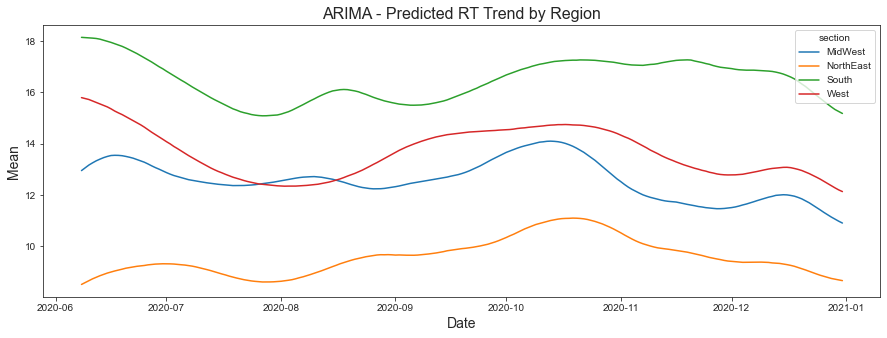

In [37]:
plt.figure(figsize=(15, 5))
sns.lineplot(data=region_mean_Nov, x="date", y="ARIMA", hue="section")
plt.xlabel('Date', fontsize=14)
plt.ylabel('Mean', fontsize=14)
plt.title('ARIMA - Predicted RT Trend by Region', fontsize=16)

Text(0.5, 1.0, 'HWAAS - Predicted RT Trend by Region')

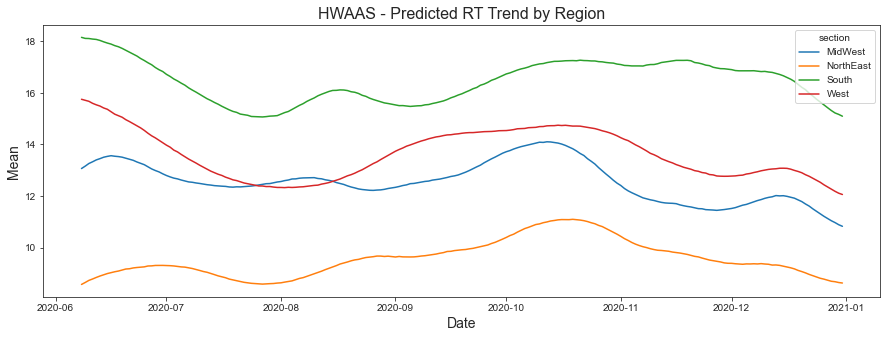

In [38]:
plt.figure(figsize=(15, 5))
sns.lineplot(data=region_mean_Nov, x="date", y="HWAAS", hue="section")
plt.xlabel('Date', fontsize=14)
plt.ylabel('Mean', fontsize=14)
plt.title('HWAAS - Predicted RT Trend by Region', fontsize=16)

Text(0.5, 1.0, 'Prohphet - Predicted RT Trend by Region')

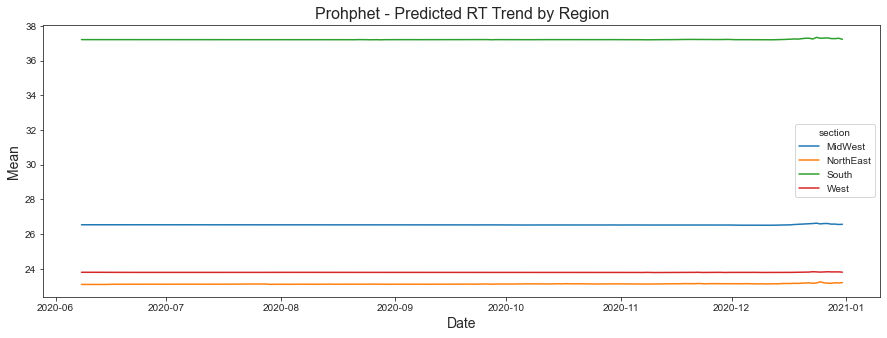

In [39]:
plt.figure(figsize=(15, 5))
sns.lineplot(data=region_mean_Nov, x="date", y="Prohphet", hue="section")
plt.xlabel('Date', fontsize=14)
plt.ylabel('Mean', fontsize=14)
plt.title('Prohphet - Predicted RT Trend by Region', fontsize=16)